<a href="https://colab.research.google.com/github/ArunKumar1611/Stock-Price-Prediction-of-UK-Banks-Using-Multiple-Machine/blob/main/Yfinance_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Installation of essential Libraries**

In [ ]:
!pip install yfinance


**Importing Libraries**

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, ConfusionMatrixDisplay,precision_score, recall_score
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
import xgboost as xgb
from sklearn.svm import SVR
from sklearn import metrics
import torch
from torch import nn
from sklearn.metrics import mean_squared_error


# **Functions**

**Orignal Dataset ploting and eda function**

In [ ]:
def eda_analysis(df,ticker):
    # ploting the original dataset of stocks
    df.reset_index(inplace=True)
    df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
    df.set_index('Date', inplace=True)

    plt.figure(figsize=(14, 7))
    plt.plot(df.index, df[('Close', ticker)], label='Actual Close Prices', color='blue', alpha=0.7)

    # Adding titles and labels
    plt.title("Actual Closing Prices from 2019 -2024")
    plt.xlabel("Date")
    plt.ylabel("Price")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Accessing the 'Close' column as a tuple
    print("Close column head:\n", df[('Close', ticker)].head())
    print("Statistics for Close column:\n", df[('Close', ticker)].describe())

    #..........................................................................................
    # Distribution of Each Feature
    #..........................................................................................
    num_columns = len(df.columns)
    rows = (num_columns // 3) + (num_columns % 3 > 0)

    df.hist(bins=30, figsize=(12, 10), layout=(rows, 3))
    plt.suptitle("Distribution of Each Feature")
    plt.show()

    #..........................................................................................
    # Box Plots for Each Feature
    #..........................................................................................
    df1 = df.copy()
    df1.columns = ['_'.join(col).strip() for col in df1.columns]
    num_columns = len(df1.columns)
    rows = (num_columns // 3) + (num_columns % 3 > 0)

    df1.plot(kind='box', subplots=True, layout=(rows, 3), figsize=(12, 10), title="Box Plots for Each Feature")
    plt.tight_layout()
    plt.suptitle("Box Plots for Each Feature", y=1.02)
    plt.show()


**Feature enginreering function**

In [ ]:

def feature_engineering(df, ticker):
    """

    Parameters:
        df (DataFrame): The DataFrame containing stock data with multi-level columns.
        ticker (str): The ticker symbol of the stock to use in column names.
    """
    # Example feature creation using multi-level column name
    df[('Close_diff', ticker)] = df[('Close', ticker)].diff()  # Creates a new column with differences
    df[('Close_pct_change', ticker)] = df[('Close', ticker)].pct_change()  # Percentage change

    # Example using another column
    df[('Volume_scaled', ticker)] = df[('Volume', ticker)] / 1e6  # Scale volume for easier analysis

    # If you're applying more complex transformations, ensure each uses the tuple format
    print("Feature engineering completed.")

    # Testing feature engineering code

    # Window size and alpha for moving averages
    window_size = 20  # 20-day SMA
    alpha = 0.5

    df[('CMA_Close', ticker)] = df[('Close', ticker)].expanding().mean()  # Cumulative Moving Average
    df[('SMA_Close', ticker)] = df[('Close', ticker)].rolling(window=window_size).mean()  # Simple Moving Average
    df[('EMA_Close', ticker)] = df[('Close', ticker)].ewm(alpha=alpha, min_periods=window_size).mean()  # Exponential Moving Average

    #..........................................................................................
    # Plotting Close prices along with CMA, SMA, and EMA
    #..........................................................................................
    plt.figure(figsize=(14, 8))

    plt.plot(df.index, df[('Close', ticker)], label='Close Price', color='blue', linewidth=1)
    plt.plot(df.index, df[('CMA_Close', ticker)], label='CMA (Close)', color='orange', linestyle='--')
    plt.plot(df.index, df[('SMA_Close', ticker)], label=f'SMA ({window_size}-day)', color='green', linestyle='--')
    plt.plot(df.index, df[('EMA_Close', ticker)], label=f'EMA (alpha={alpha})', color='red', linestyle='--')

    plt.title(f'{ticker} Close Price with CMA, SMA, and EMA')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)
    plt.show()

# **Random Forest Regressor Function for training and evaluation with the printing of MAE, RMSE etc and ploting the future prediction**

In [ ]:

def random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2):
    """
        df (DataFrame): The DataFrame containing data.
        X_columns : List of feature column names.
        y_column : Target column name for prediction.
        estim: Number of trees in the forest.
        test_size: Test set size for train/test split.
        it also prints model performance and future predictions.
    """
    # Define features and target
    X = df[X_columns]
    y = df[y_column]

    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=42)

    # Model training
    rf_model = RandomForestRegressor(n_estimators=estim, random_state=42)
    rf_model.fit(X_train, y_train)

    #..........................................................................................
    # Evaluating Model
    #..........................................................................................



    # Model evaluation on test set
    y_pred = rf_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    rse = r2_score(y_test, y_pred)

    print("Model Performance Metrics")
    print("-" * 30)
    print(f"Mean Squared Error (MSE):       {mse:.4f}")
    print(f"Mean Absolute Error (MAE):      {mae:.4f}")
    print(f'Root Mean Squared Error (RMSE): {rmse}')
    print(f"Root Square Error (RSE):        {rse:.4f}")
    print("-" * 30)

    # Generate future dates for predictions
    future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')
    future_data = pd.DataFrame(index=future_dates, columns=X.columns)

    # Fill future_data with dynamic values
    for col in X.columns:
        # Rolling mean or linear trend based on last few values to simulate trend
        last_value = df[col].iloc[-1]
        trend_slope = (df[col].iloc[-1] - df[col].iloc[-10]) / 10  # based on last 10 values
        future_data[col] = [last_value + trend_slope * i for i in range(1, 13)]  # increment each month

    # Predict for future dates
    future_predictions = rf_model.predict(future_data)

    #..........................................................................................
    # Plotting actual vs predicted prices
    #..........................................................................................


    # Plotting the historical and predicted data
    plt.figure(figsize=(14, 8))
    plt.plot(df.index, y, label='Historical Data', color='blue')
    plt.plot(future_dates, future_predictions, label='Predicted Data (Next Year)', color='orange', linestyle='--')
    plt.title('Stock Price Prediction for Next Year')
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()


**random forset classifier to predic weather it will goes up and down with the ploting of confusion matrix**

In [ ]:
def random_forest_classifier(df, X_columns, y, ticker=None):
    """
        df (DataFrame): The DataFrame containing stock data.
        X_columns : List of feature column names.
        y : The target column for prediction (up/down classification).
        ticker :  ticker name
    """
    if ticker:
        target_column = ('Close', ticker)
    else:
        target_column = 'Close'

    #making it ready for prediction
    X = df[X_columns].iloc[:-1]
    y = y.iloc[:-1]

    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Model training (using RandomForestClassifier)
    rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_classifier.fit(X_train, y_train)

    # Model evaluation
    y_pred = rf_classifier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)

    print("-" * 60)
    print("Model Evaluation Metrics:")
    print(f"Accuracy: {accuracy:.2f}")
    print(f"F1 Score: {f1:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print("-" * 60)

    # Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Down", "Up"], yticklabels=["Down", "Up"])
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.title("Confusion Matrix")
    plt.show()

    # Prediction for the next day (using the last day of data)
    last_day_data = X.iloc[-1].values.reshape(1, -1)
    next_day_prediction = rf_classifier.predict(last_day_data)

    if next_day_prediction == 1:
        print("The stock price is predicted to go UP.")
    else:
        print("The stock price is predicted to go DOWN.")




# **LSTM function**

In [ ]:
def lstm(df, X, y, epochs, batch_size, optim, los):
    # Scale the data
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df['Close'].values.reshape(-1, 1))

    # Create dataset function for LSTM input
    def create_dataset(data, time_step=1):
        X, y = [], []
        for i in range(len(data) - time_step - 1):
            a = data[i:(i + time_step), 0]
            X.append(a)
            y.append(data[i + time_step, 0])
        return np.array(X), np.array(y)

    # Time step (look back period for LSTM)
    time_step = 60  # 60 days look back
    X, y = create_dataset(scaled_data, time_step)

    # Reshaping X to [samples, time steps, features] for LSTM
    X = X.reshape(X.shape[0], X.shape[1], 1)

    # Split the data into training and testing sets
    train_size = int(len(X) * 0.8)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(Dropout(0.2))
    model.add(LSTM(50, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(1))

    # Compile the model
    model.compile(optimizer=optim, loss=los)

    # Train the model
    model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size)

    #..........................................................................................
    # Evaluating model
    #..........................................................................................


    # Make predictions
    predicted_prices = model.predict(X_test)
    predicted_prices = scaler.inverse_transform(predicted_prices)  # Rescale to original prices
    y_test_rescaled = scaler.inverse_transform(y_test.reshape(-1, 1))

    # Calculate MAE, MSE, RMSE
    mae = mean_absolute_error(y_test_rescaled, predicted_prices)
    mse = mean_squared_error(y_test_rescaled, predicted_prices)
    rmse = np.sqrt(mse)
    rse=r2_score(y_test_rescaled,predicted_prices)

    #..........................................................................................
    # Plotting actual vs predicted prices
    #..........................................................................................


    # Prepare to plot
    plt.figure(figsize=(14, 7))

    # Plot actual vs predicted prices
    plt.plot(df.index[train_size + time_step + 1:], df['Close'][train_size + time_step + 1:], label='Actual Prices', color='blue')
    plt.plot(df.index[train_size + time_step + 1:], predicted_prices, label='Predicted Prices', color='orange')

    # Adding titles and labels
    plt.title('Stock Price Prediction Using LSTM')
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Make continuous predictions for the next year
    future_steps = 365  # Predicting for the next year
    last_data = scaled_data[-time_step:].reshape(1, time_step, 1)

    future_predictions = []

    for _ in range(future_steps):
        predicted_price = model.predict(last_data)
        future_predictions.append(predicted_price[0, 0])

        # Update last_data for the next prediction
        last_data = np.append(last_data[:, 1:, :], predicted_price.reshape(1, 1, 1), axis=1)

    # Prepare the index for future dates
    last_date = df.index[-1]
    future_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=future_steps)

    # Create a DataFrame for future predictions
    future_prices = scaler.inverse_transform(np.array(future_predictions).reshape(-1, 1))
    future_df = pd.DataFrame(data=future_prices, index=future_dates, columns=['Predicted Price'])

    # Plotting future predictions
    plt.figure(figsize=(14, 7))
    plt.plot(df.index, df['Close'], label='Historical Prices', color='blue')
    plt.plot(future_df.index, future_df['Predicted Price'], label='Future Predictions', color='orange')

    # Adding titles and labels
    plt.title('Continuous Stock Price Prediction for the Next Year')
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()
        # Print evaluation metrics
    print(f'Mean Absolute Error (MAE): {mae}')
    print(f'Mean Squared Error (MSE): {mse}')
    print(f'Root Mean Squared Error (RMSE): {rmse}')
    print(f"RSE of the base model: {rse}")
    print("\n\n")


# **XGBoost Function**

In [ ]:
def xgboost(df, X, y, testsiz, n_esti, learn_rate, max_dep, window_size=10, alpha=0.1):
    # Feature Engineering: Create lag features for the closing price
    data = df[['Close']].copy()
    for i in range(1, 6):  # Creating 5 lag features
        data[f'lag_{i}'] = data['Close'].shift(i)

    # Adding Technical Indicators
    ticker = 'Close'
    data[('CMA_Close', ticker)] = data['Close'].expanding().mean()
    data[('SMA_Close', ticker)] = data['Close'].rolling(window=window_size).mean()
    data[('EMA_Close', ticker)] = data['Close'].ewm(alpha=alpha, min_periods=window_size).mean()

    # Dropping missing values
    data.dropna(inplace=True)

    #  X contains the lag features and technical indicators
    X = data.drop('Close', axis=1)
    y = data['Close']

    # Splitting the data into training and testing datasets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=testsiz, random_state=42)

    # Initializing and fit the XGBoost model
    xg_model = xgb.XGBRegressor(objective='reg:squarederror',
                                n_estimators=n_esti,
                                learning_rate=learn_rate,
                                max_depth=max_dep)
    xg_model.fit(X_train, y_train)

    # Making predictions
    y_pred = xg_model.predict(X_test)

    #..........................................................................................
    # Plotting actual vs predicted prices
    #..........................................................................................

    plt.figure(figsize=(14, 7))
    plt.plot(y_test.index, y_test, label='Actual Prices', color='blue')
    plt.plot(y_test.index, y_pred, label='Predicted Prices', color='orange', alpha=0.7)
    plt.title('Stock Price Prediction Using XGBoost')
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Continuous prediction for the next year
    future_steps = 365
    last_data = data.iloc[-1][1:].values  # Using the lag features and indicators for prediction
    future_prices = []

    # Generate predictions for the next year
    for _ in range(future_steps):
        future_df = pd.DataFrame(data=[last_data], columns=X.columns)
        next_price = xg_model.predict(future_df)[0]
        future_prices.append(next_price)

        # Update last_data for the next iteration
        last_data = np.roll(last_data, -1)
        last_data[-1] = next_price

    # Make the future prices less bold and more noticeable
    future_prices = pd.Series(future_prices, index=pd.date_range(start=df.index[-1] + pd.Timedelta(days=1), periods=future_steps))

    # Calculate trend by diffing the predictions
    trend = future_prices.diff().dropna()

    #..........................................................................................
    # Plotting the future prediction with trend analysis
    #..........................................................................................


    plt.figure(figsize=(14, 7))
    plt.plot(df.index, df['Close'], label='Historical Prices', color='blue', alpha=0.6)
    plt.plot(future_prices.index, future_prices, label='Future Predictions', color='orange', alpha=0.7)
    plt.fill_between(future_prices.index, future_prices, color='orange', alpha=0.2)
    plt.title('Continuous Stock Price Prediction for the Next Year Using XGBoost')
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()

    print("\n\n")
    if trend[-1] > 0:
        print(f"Predicted trend for next year: Up")
    else:
        print(f"Predicted trend for next year: Down")

    print("\n\n")


# **SVM function**

In [ ]:
def svm(df, X, y, testsiz, c, epi):
    # Forward fill the missing values in the dataframe
    df.fillna(method='ffill', inplace=True)

    # Feature Engineering: Create lag features for the closing price
    data = df[['Close']].copy()

    # Create lag features
    for i in range(1, 6):  # Creating 5 lag features
        data[f'lag_{i}'] = data['Close'].shift(i)

    # Dropping rows with missing NaNs created by lag features
    data.dropna(inplace=True)

    # Updating X and y after dropping NaNs values
    X = data.drop('Close', axis=1)
    y = data['Close']

    # Splitting the data into training and testing datasets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=testsiz, random_state=42)

    # Initialize and fit the SVM model
    svm_model = SVR(kernel='rbf', C=c, epsilon=epi, gamma='scale', tol=1e-3)
    svm_model.fit(X_train, y_train)

    # Predictions and evaluation
    y_pred = svm_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rse = r2_score(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    mae = mean_absolute_error(y_test, y_pred)

    # Print evaluation metrics
    print("\n\n")
    print("-" * 30)
    print(f'MSE: {mse:.2f}')
    print(f'RMSE: {rmse:.2f}')
    print(f'MAE: {mae:.2f}')
    print(f'R2 Score: {rse:.2f}')
    print("-" * 30)
    print("\n\n")



    #..........................................................................................
    # Plotting actual vs predicted prices
    #..........................................................................................



    y_pred = svm_model.predict(X_test)

    # Plotting actual vs predicted prices
    plt.figure(figsize=(14, 7))
    plt.plot(y_test.index, y_test, label='Actual Prices', color='blue')
    plt.plot(y_test.index, y_pred, label='Predicted Prices', color='orange')

    # Adding titles and labels
    plt.title('Stock Price Prediction Using Support Vector Machine')
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Continuous prediction for the next year
    # Preparing to create future data for predictions
    future_steps = 365

    # Creating an array to hold the last observed data points with lag features
    last_data = data.iloc[-1][1:].values  # Getong the last row of lag features (excluding 'Close')

    # Initialize an empty list to store future predictions
    future_prices = []

    # Generate predictions for the next year
    for _ in range(future_steps):
        # Creating a DataFrame for the next prediction with the correct number of lag features
        future_df = pd.DataFrame(data=[last_data], columns=X.columns)

        # Predict the next price
        next_price = svm_model.predict(future_df)[0]
        future_prices.append(next_price)

        # Update last_data for the next iteration
        last_data = np.roll(last_data, -1)  # Shift the lag features to the left
        last_data[-1] = next_price  # Add the predicted price as the last lag feature

    # Prepare the index for future dates
    last_date = df.index[-1]
    future_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=future_steps)

    # Create a DataFrame for future predictions
    future_df = pd.DataFrame(data=future_prices, index=future_dates, columns=['Predicted Price'])

    # Plotting historical and future predictions
    plt.figure(figsize=(14, 7))
    plt.plot(df.index, df['Close'], label='Historical Prices', color='blue')
    plt.plot(future_df.index, future_df['Predicted Price'], label='Future Predictions', color='orange')

    # Adding titles and labels
    plt.title('Continuous Stock Price Prediction for the Next Year Using SVM')
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()







# Standard Chartered (STAN.L)

**Data Loading and preprocessing**

In [ ]:
# Fetching data for Standard Chartered (STAN.L)
ticker = "STAN.L"
data = yf.download(ticker, start="2019-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()

[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,STAN.L,STAN.L,STAN.L,STAN.L,STAN.L,STAN.L
Date,,,,,,
2019-01-02 00:00:00+00:00,501.606262,606.400024,607.700012,584.099976,596.000000,4442051
2019-01-03 00:00:00+00:00,485.310577,586.700012,610.799988,582.700012,596.599976,7359146
2019-01-04 00:00:00+00:00,502.764343,607.799988,611.200012,596.000000,597.400024,7283237
2019-01-07 00:00:00+00:00,491.845337,594.599976,609.599976,590.900024,606.900024,7184535
2019-01-08 00:00:00+00:00,507.065643,613.000000,623.500000,593.599976,596.799988,7575939


In [ ]:
print(df.columns)
print(data.columns)

MultiIndex([('Adj Close', 'STAN.L'),
            (    'Close', 'STAN.L'),
            (     'High', 'STAN.L'),
            (      'Low', 'STAN.L'),
            (     'Open', 'STAN.L'),
            (   'Volume', 'STAN.L')],
           names=['Price', 'Ticker'])
MultiIndex([('Adj Close', 'STAN.L'),
            (    'Close', 'STAN.L'),
            (     'High', 'STAN.L'),
            (      'Low', 'STAN.L'),
            (     'Open', 'STAN.L'),
            (   'Volume', 'STAN.L')],
           names=['Price', 'Ticker'])


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())


------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1261 entries, 2019-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (Adj Close, STAN.L)  1261 non-null   float64
 1   (Close, STAN.L)      1261 non-null   float64
 2   (High, STAN.L)       1261 non-null   float64
 3   (Low, STAN.L)        1261 non-null   float64
 4   (Open, STAN.L)       1261 non-null   float64
 5   (Volume, STAN.L)     1261 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 69.0 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker       STAN.L       STAN.L       STAN.L       STAN.

**EDA Analysis**

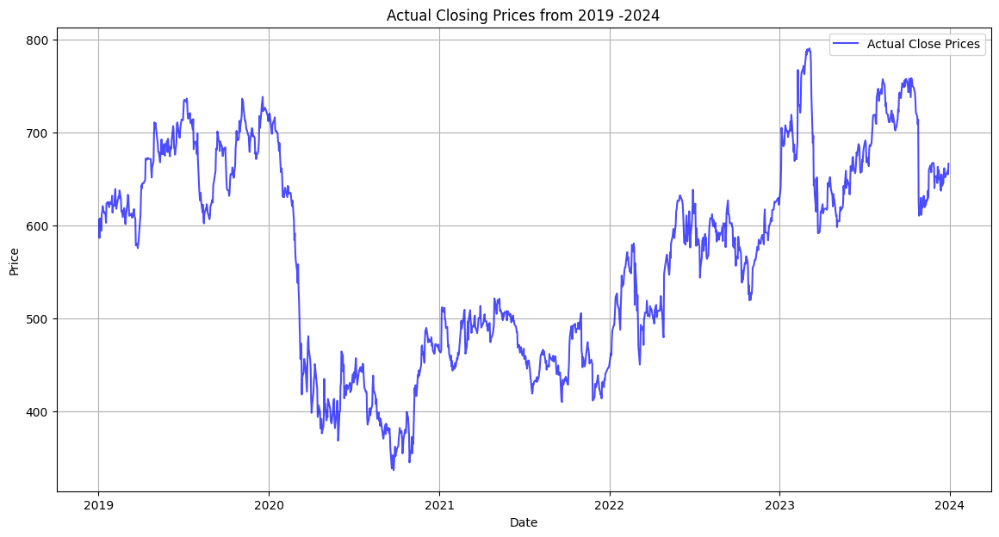

Close column head:
 Date
2019-01-02 00:00:00+00:00    606.400024
2019-01-03 00:00:00+00:00    586.700012
2019-01-04 00:00:00+00:00    607.799988
2019-01-07 00:00:00+00:00    594.599976
2019-01-08 00:00:00+00:00    613.000000
Name: (Close, STAN.L), dtype: float64
Statistics for Close column:
 count    1261.000000
mean      567.990634
std       111.144439
min       336.799988
25%       466.100006
50%       585.599976
75%       661.000000
max       790.799988
Name: (Close, STAN.L), dtype: float64


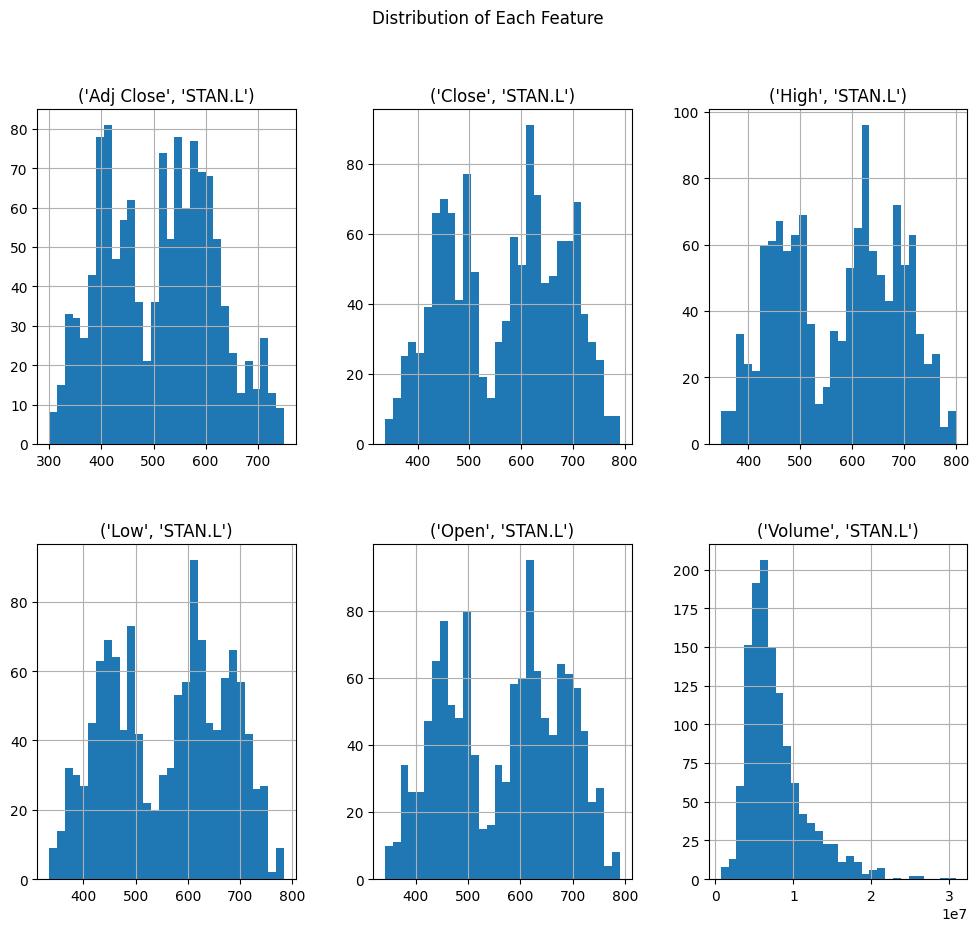

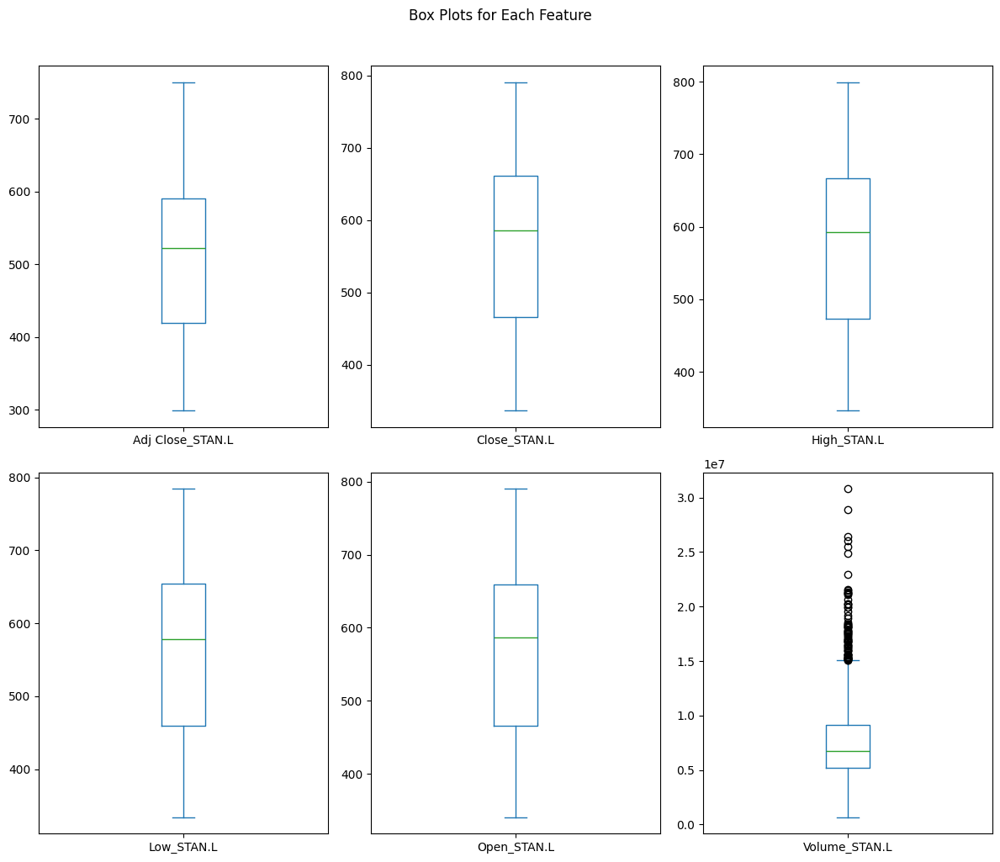

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


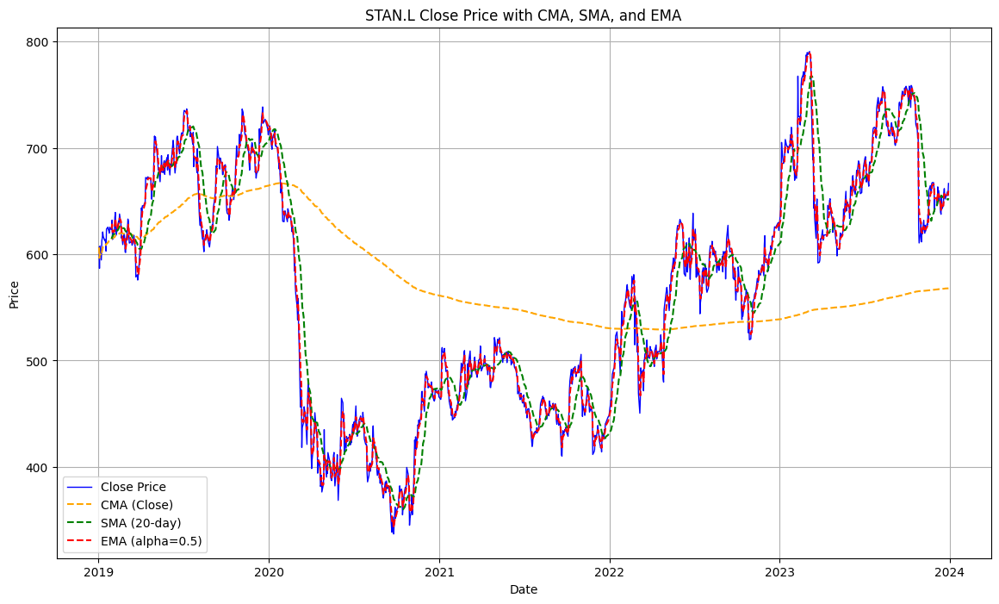

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       56.6155
Mean Absolute Error (MAE):      5.1919
Root Mean Squared Error (RMSE): 7.5243246405893185
Root Square Error (RSE):        0.9953
------------------------------


<ipython-input-11-b10075603d89>:43: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


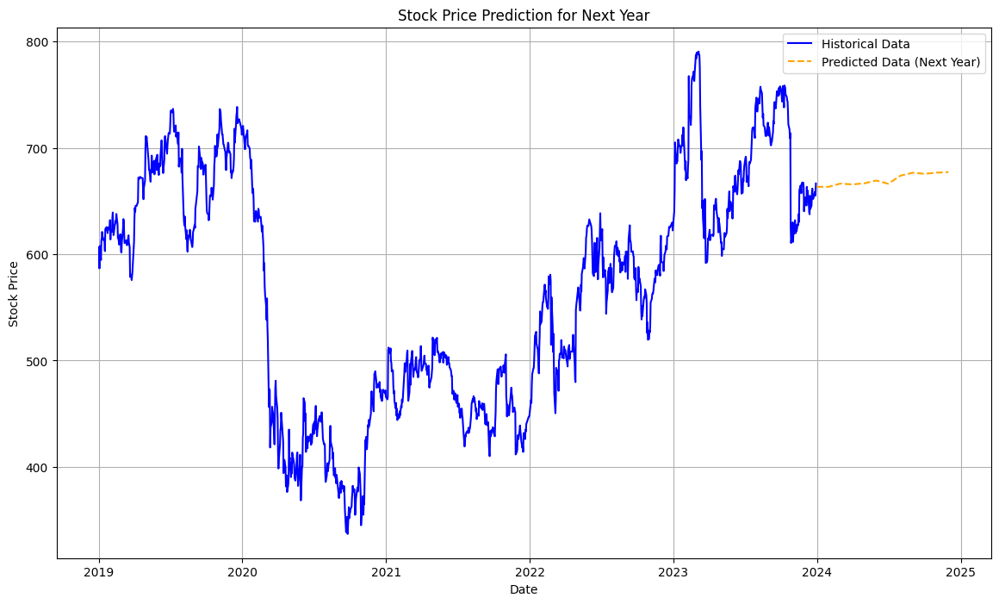

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.54
F1 Score: 0.54
Precision: 0.51
Recall: 0.57
------------------------------------------------------------


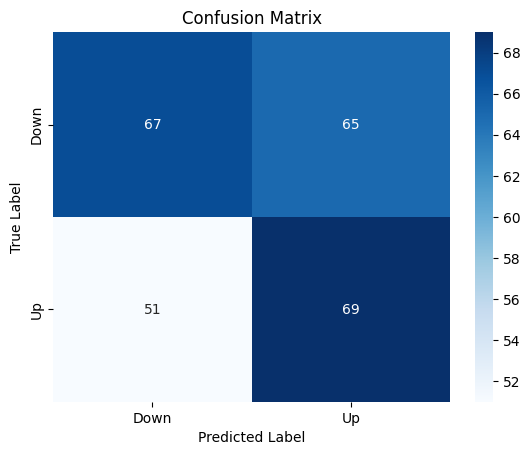

The stock price is predicted to go UP.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 106ms/step - loss: 0.0911
Epoch 2/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 112ms/step - loss: 0.0075
Epoch 3/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 4s 126ms/step - loss: 0.0053
Epoch 4/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step - loss: 0.0050
Epoch 5/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - loss: 0.0052
Epoch 6/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - loss: 0.0053
Epoch 7/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0044
Epoch 8/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - loss: 0.0045
Epoch 9/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 45ms/step - loss: 0.0037
Epoch 10/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0045
Epoch 11/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - loss: 0.0039
Epoch 12/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 50ms/step - loss: 0.0045
Epoch 13/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0045
Epoch 14/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.0037
Epoch 15/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - loss: 0.0038


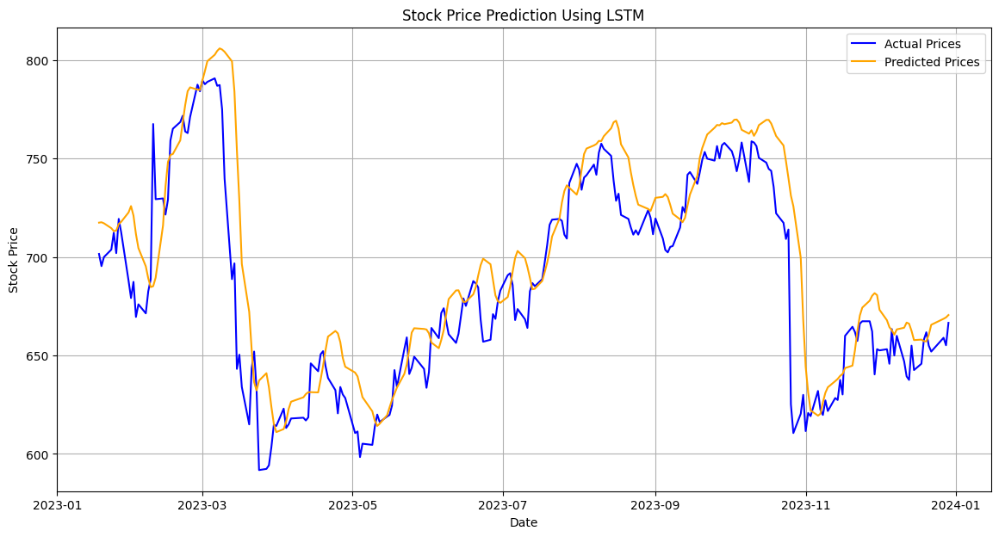

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━

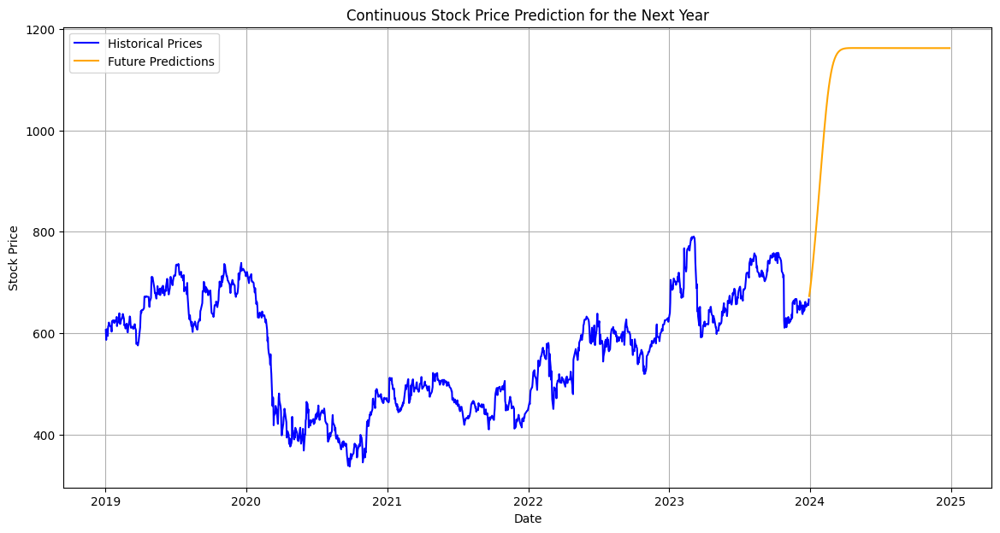

Mean Absolute Error (MAE): 16.476713562011717
Mean Squared Error (MSE): 510.0090441637362
Root Mean Squared Error (RMSE): 22.583379821535488
RSE of the base model: 0.8066906750328602





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


24/24 ━━━━━━━━━━━━━━━━━━━━ 5s 46ms/step - loss: 0.1291
Epoch 2/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0118
Epoch 3/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 46ms/step - loss: 0.0066
Epoch 4/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0058
Epoch 5/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0049
Epoch 6/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 49ms/step - loss: 0.0050
Epoch 7/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - loss: 0.0046
Epoch 8/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0047
Epoch 9/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 83ms/step - loss: 0.0049
Epoch 10/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - loss: 0.0040
Epoch 11/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step - loss: 0.0044
Epoch 12/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 49ms/step - loss: 0.0040
Epoch 13/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0042
Epoch 14/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step - loss: 0.0039
Epoch 15/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step - loss: 0.0036
E

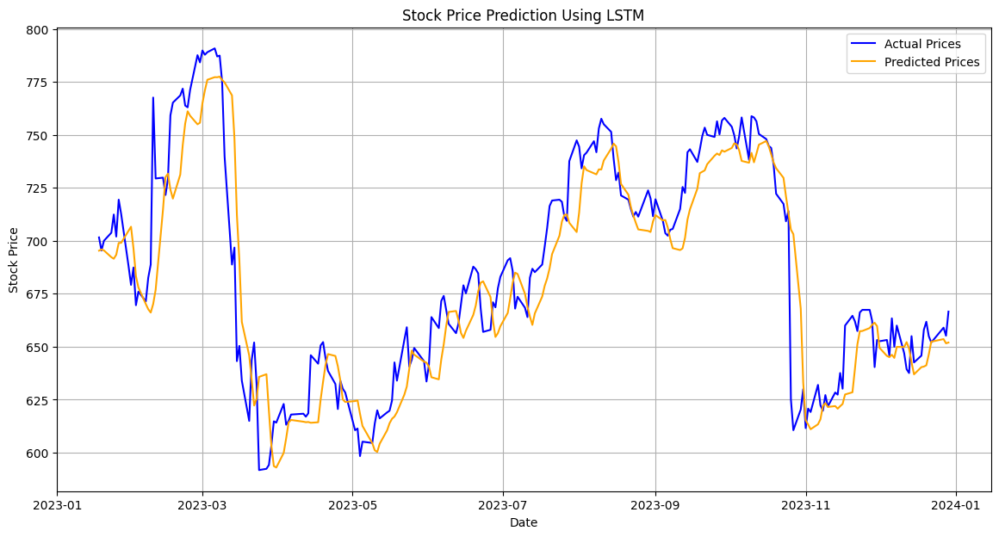

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━

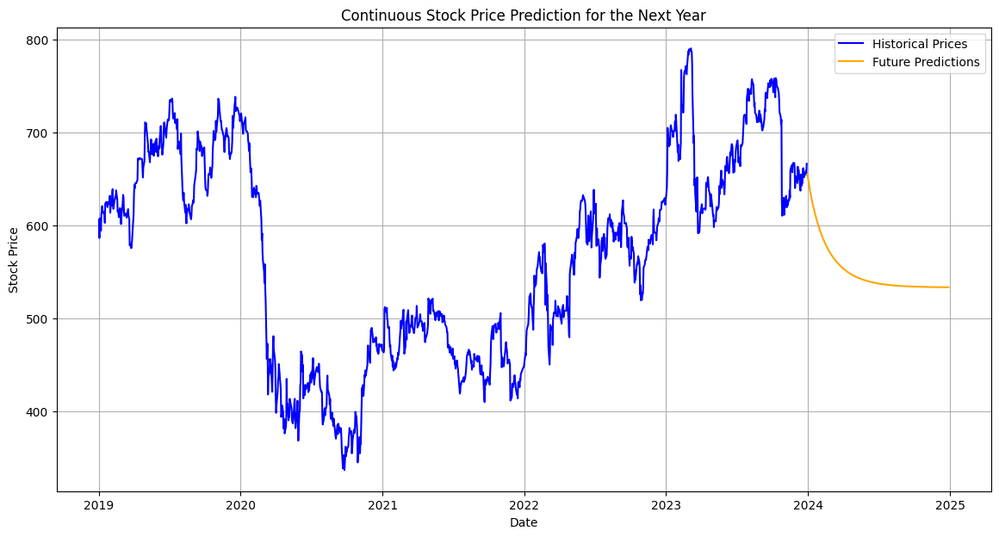

Mean Absolute Error (MAE): 12.113079325358074
Mean Squared Error (MSE): 282.9097423560607
Root Mean Squared Error (RMSE): 16.81992099731924
RSE of the base model: 0.8927683892132708





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-14-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


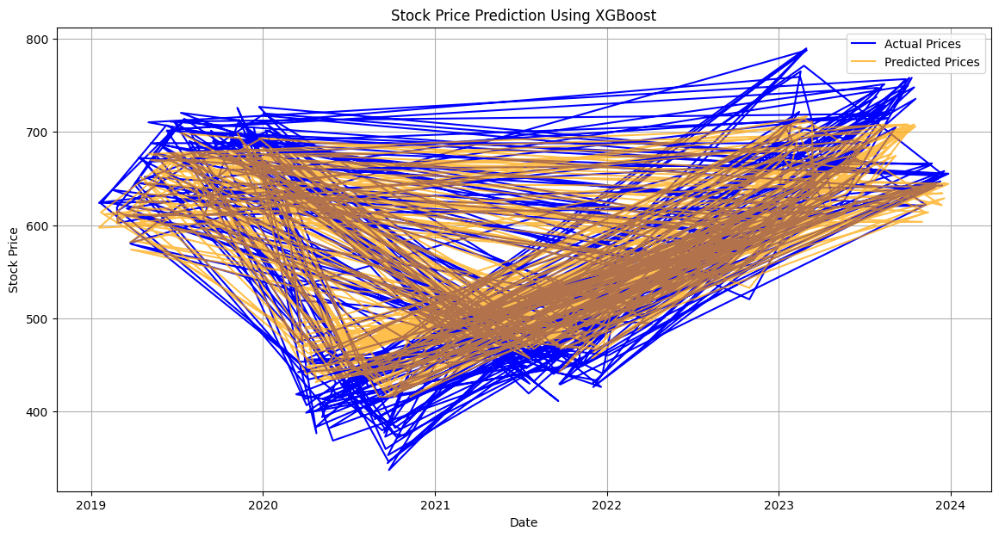

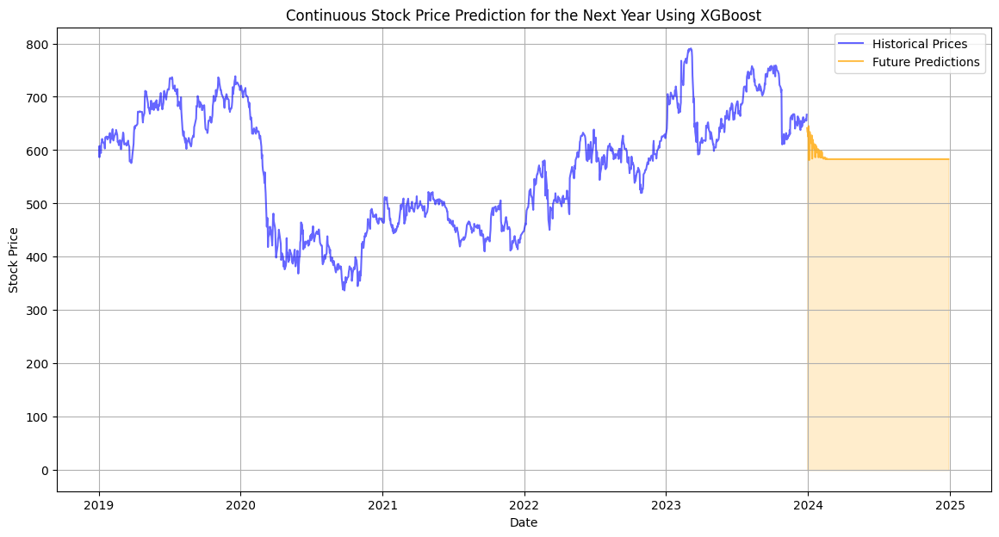




Predicted trend for next year: Down





<ipython-input-14-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-14-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


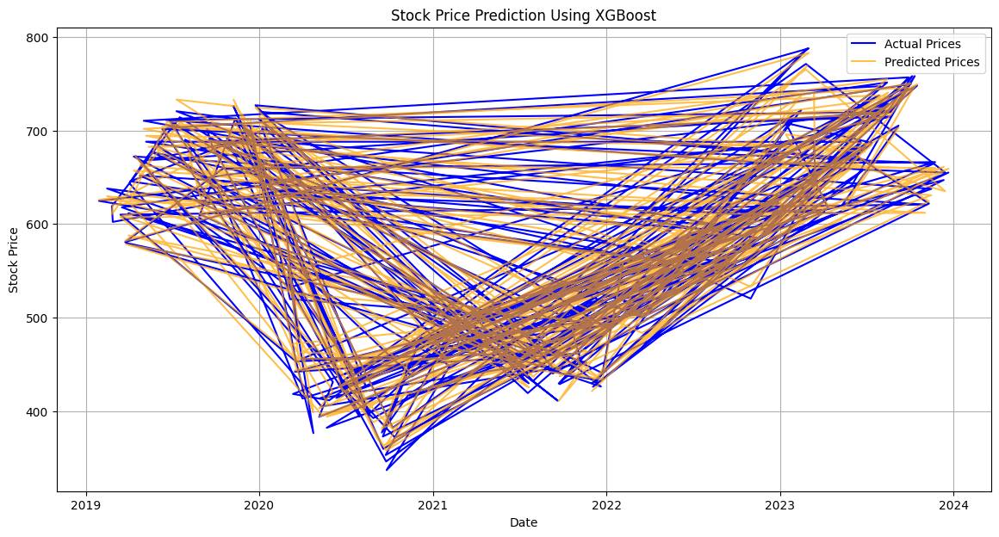

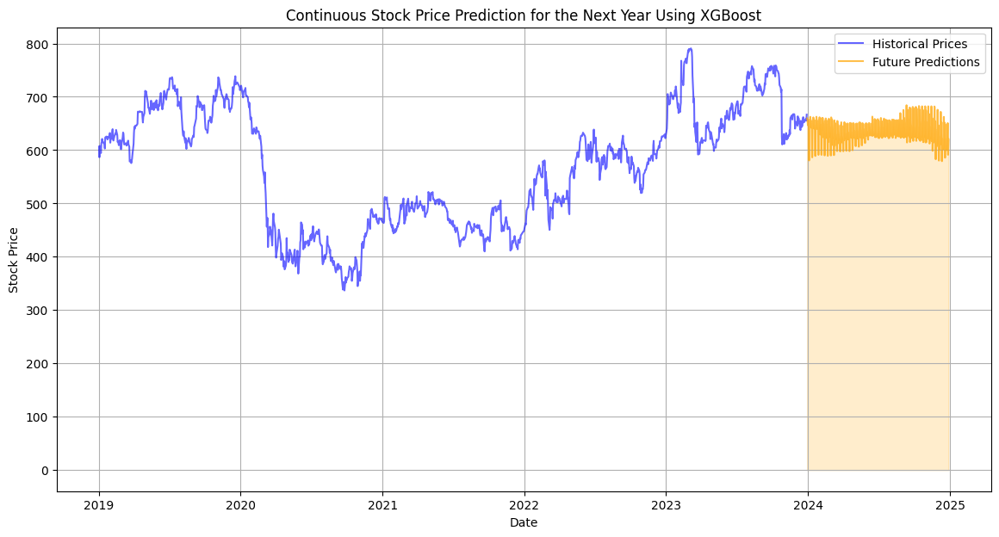




Predicted trend for next year: Up





<ipython-input-14-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM

<ipython-input-15-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 161.64
RMSE: 12.71
MAE: 8.98
R2 Score: 0.99
------------------------------





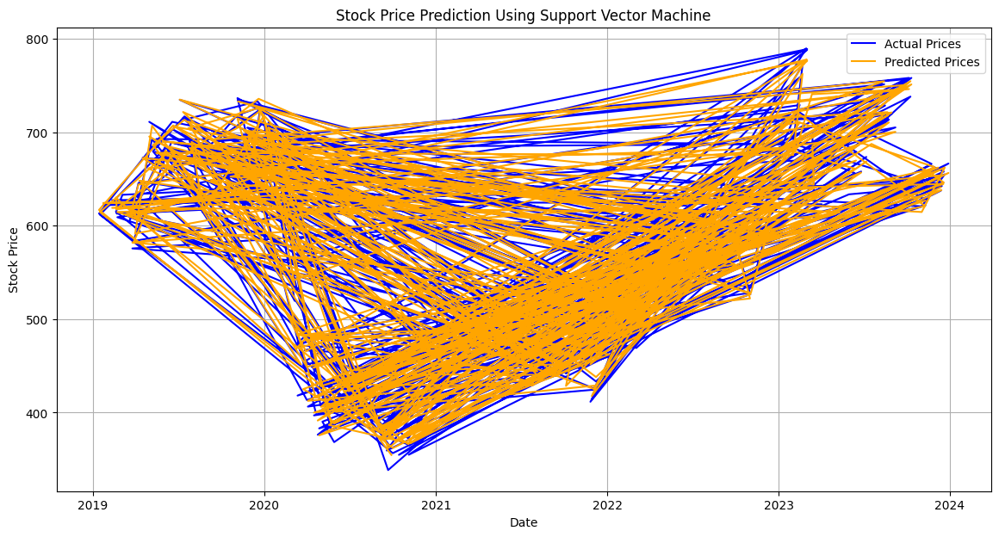

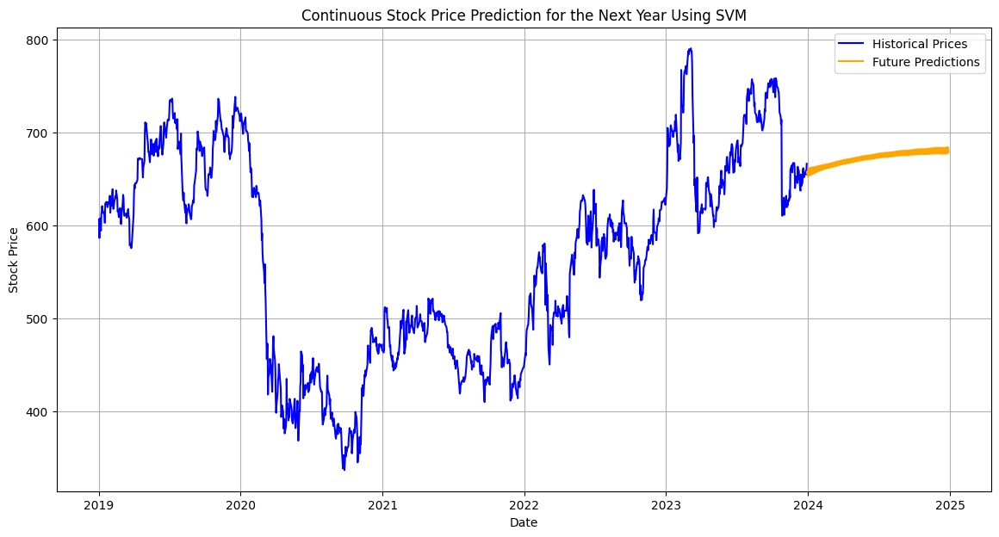

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-15-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 172.72
RMSE: 13.14
MAE: 9.14
R2 Score: 0.99
------------------------------





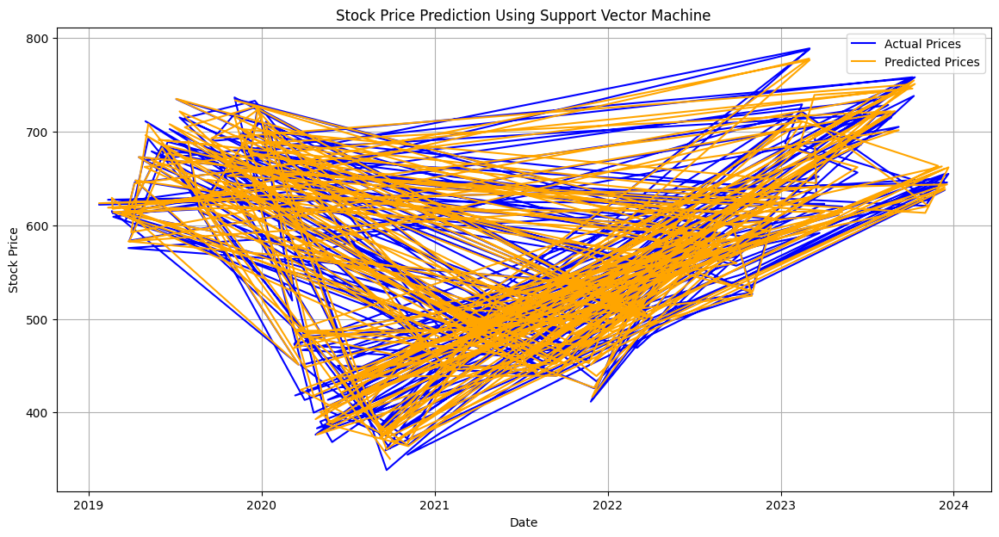

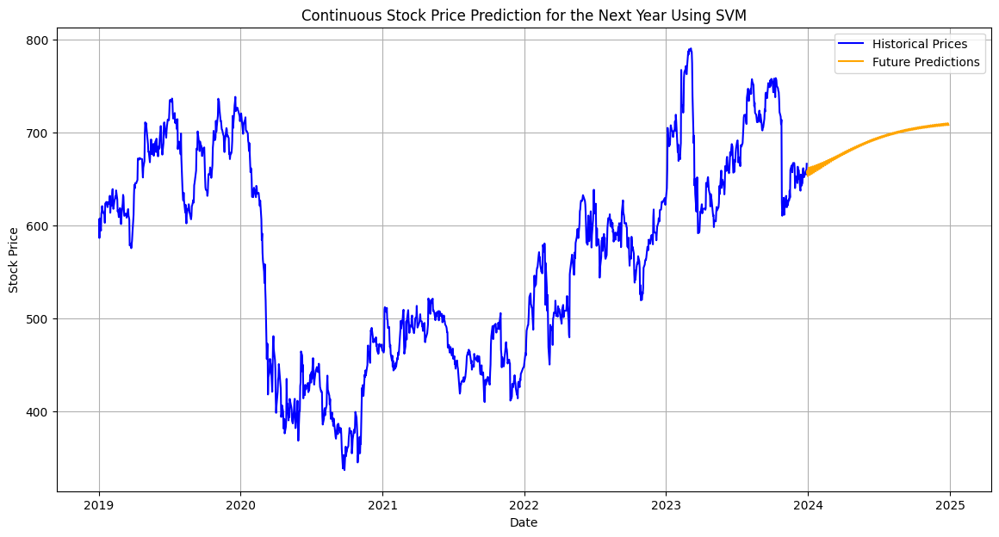

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **Barclays  BARC.L**

In [ ]:
# Fetching data for Barclays  (BARC.L)
ticker = "BARC.L"
data = yf.download(ticker, start="2019-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,BARC.L,BARC.L,BARC.L,BARC.L,BARC.L,BARC.L
Date,,,,,,
2019-01-02 00:00:00+00:00,124.531799,150.679993,151.199997,145.440002,148.440002,30140271
2019-01-03 00:00:00+00:00,124.184700,150.259995,154.220001,148.639999,149.419998,43761563
2019-01-04 00:00:00+00:00,128.184784,155.100006,156.580002,150.940002,153.039993,34380996
2019-01-07 00:00:00+00:00,128.449280,155.419998,157.100006,152.779999,155.160004,41121106
2019-01-08 00:00:00+00:00,130.019562,157.320007,159.240005,155.759995,156.100006,23750186


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1261 entries, 2019-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   (Adj Close, NWG.L)  1261 non-null   float64
 1   (Close, NWG.L)      1261 non-null   float64
 2   (High, NWG.L)       1261 non-null   float64
 3   (Low, NWG.L)        1261 non-null   float64
 4   (Open, NWG.L)       1261 non-null   float64
 5   (Volume, NWG.L)     1261 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 69.0 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker        NWG.L        NWG.L        NWG.L        NWG.L       

**EDA Analysis**

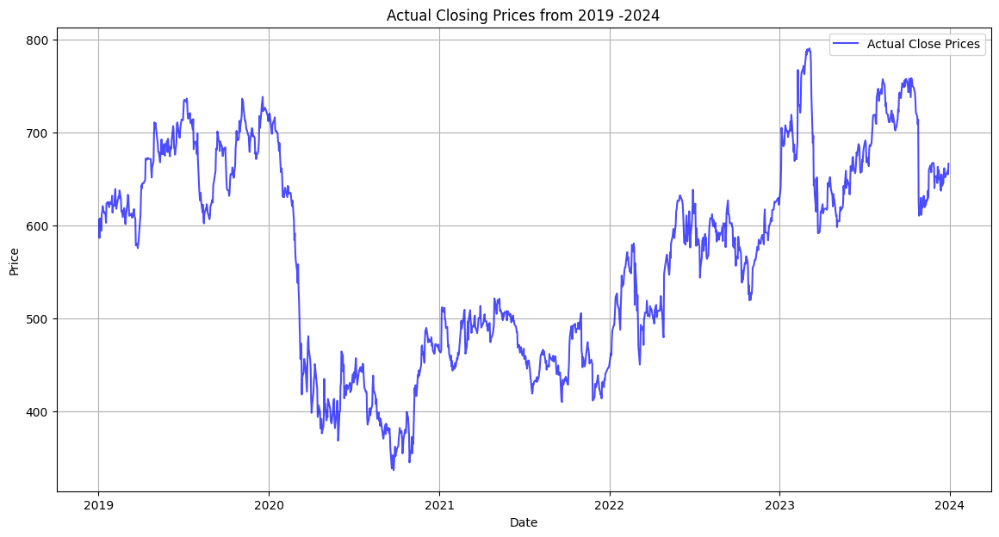

Close column head:
 Date
2019-01-02 00:00:00+00:00    606.400024
2019-01-03 00:00:00+00:00    586.700012
2019-01-04 00:00:00+00:00    607.799988
2019-01-07 00:00:00+00:00    594.599976
2019-01-08 00:00:00+00:00    613.000000
Name: (Close, STAN.L), dtype: float64
Statistics for Close column:
 count    1261.000000
mean      567.990634
std       111.144439
min       336.799988
25%       466.100006
50%       585.599976
75%       661.000000
max       790.799988
Name: (Close, STAN.L), dtype: float64


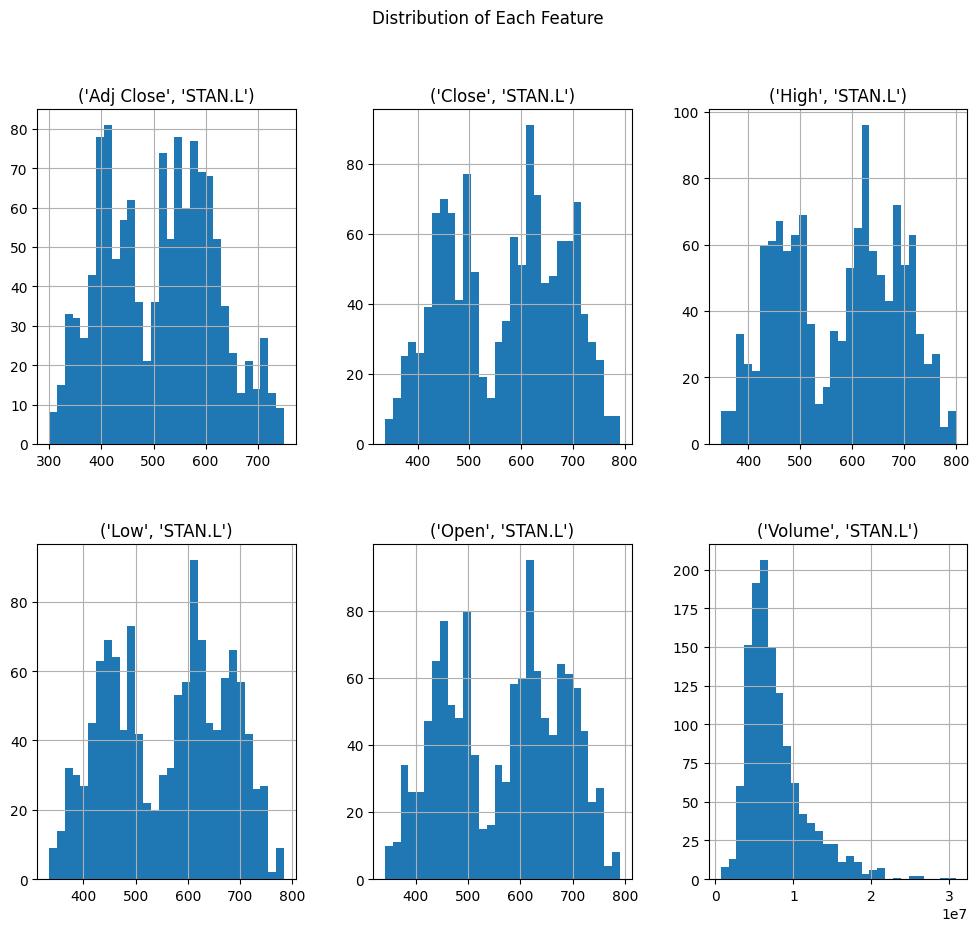

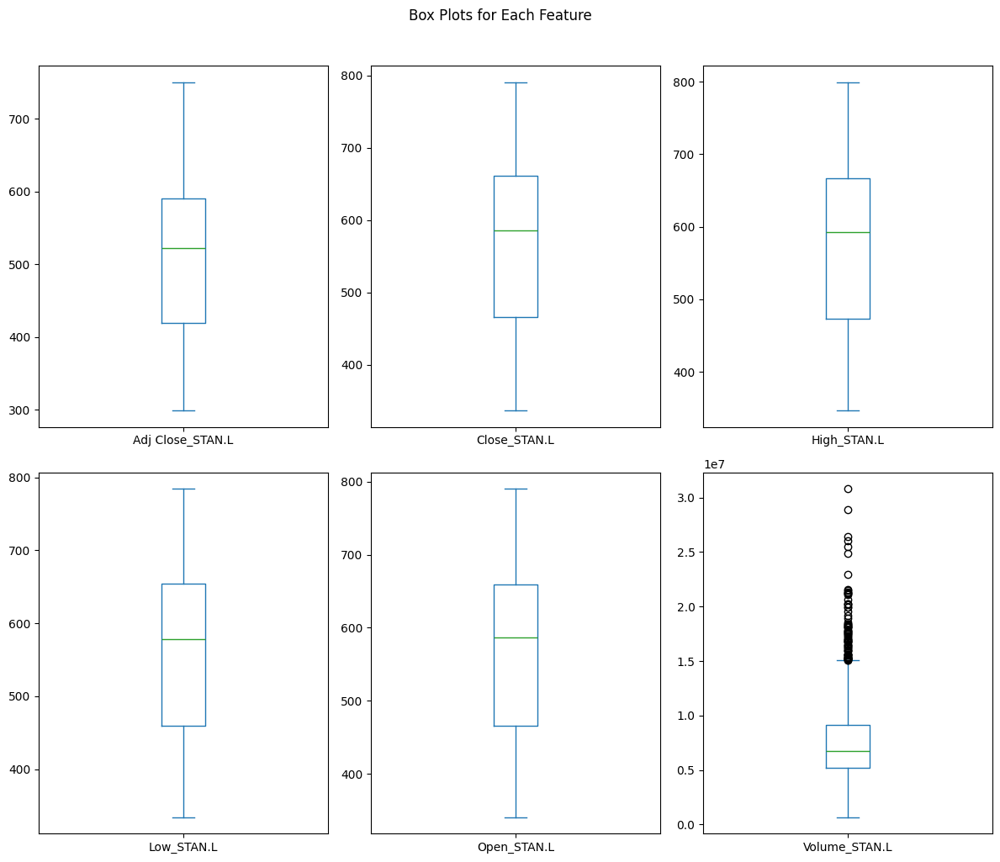

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


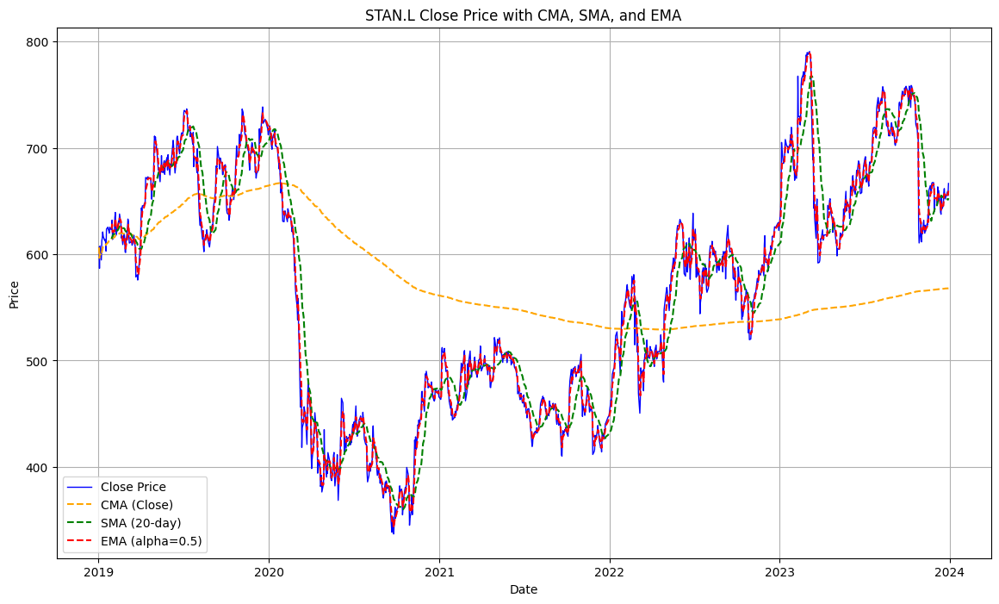

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       56.6155
Mean Absolute Error (MAE):      5.1919
Root Mean Squared Error (RMSE): 7.5243246405893185
Root Square Error (RSE):        0.9953
------------------------------


<ipython-input-43-6ddfd697081f>:37: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


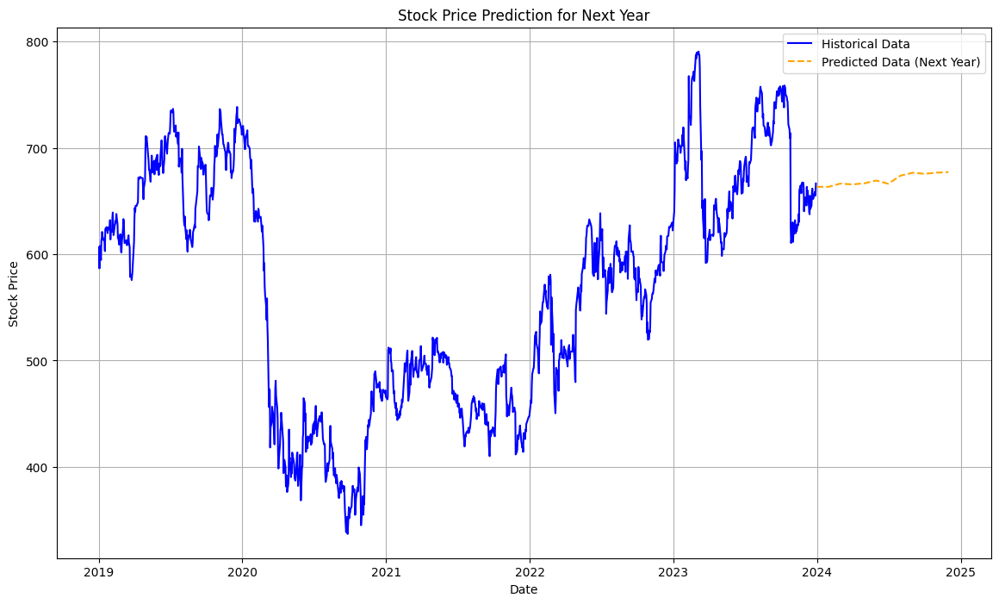

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.54
F1 Score: 0.54
Precision: 0.51
Recall: 0.57
------------------------------------------------------------


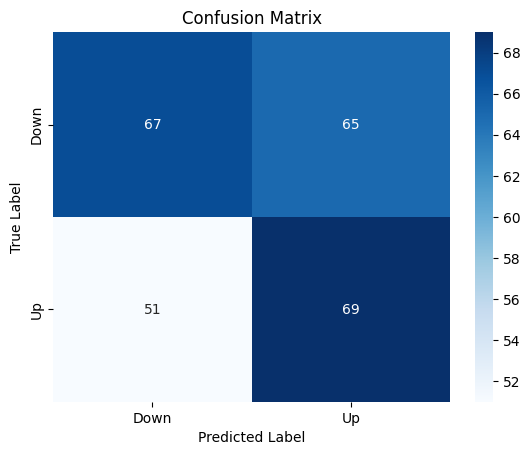

The stock price is predicted to go UP.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


30/30 ━━━━━━━━━━━━━━━━━━━━ 5s 40ms/step - loss: 0.0882
Epoch 2/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 40ms/step - loss: 0.0087
Epoch 3/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - loss: 0.0056
Epoch 4/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step - loss: 0.0050
Epoch 5/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 40ms/step - loss: 0.0055
Epoch 6/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0047
Epoch 7/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step - loss: 0.0042
Epoch 8/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step - loss: 0.0045
Epoch 9/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0038
Epoch 10/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0037
Epoch 11/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - loss: 0.0039
Epoch 12/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0040
Epoch 13/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step - loss: 0.0038
Epoch 14/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0036
Epoch 15/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0039
Epoch 16/50
30/

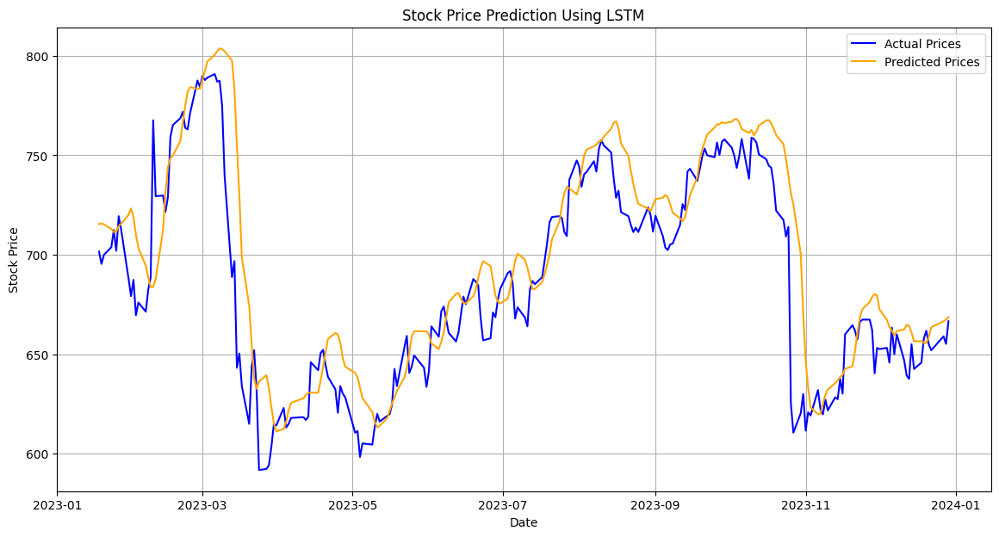

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━

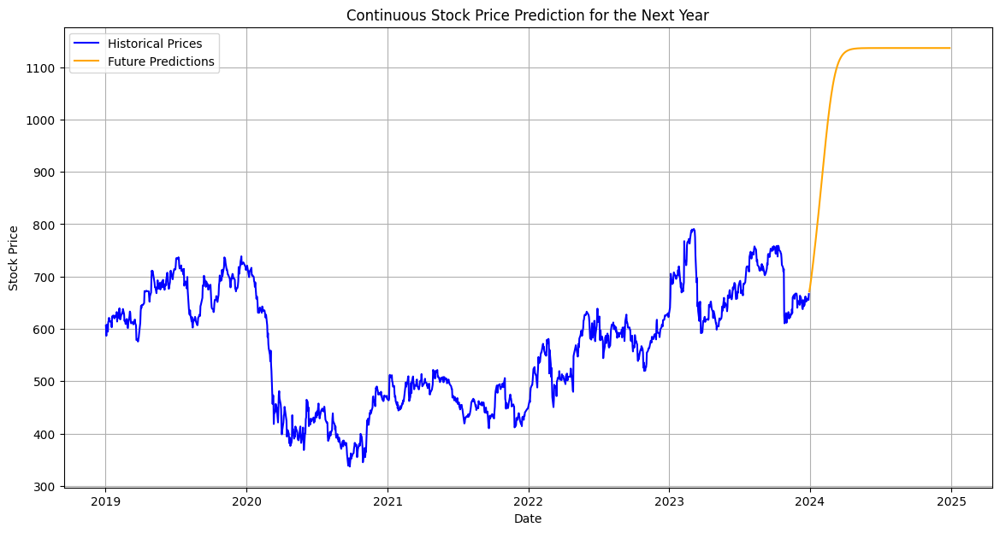

Mean Absolute Error (MAE): 15.651366170247396
Mean Squared Error (MSE): 480.66619199672715
Root Mean Squared Error (RMSE): 21.92410071124303
RSE of the base model: 0.8178125306350799





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


24/24 ━━━━━━━━━━━━━━━━━━━━ 5s 49ms/step - loss: 0.1110
Epoch 2/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step - loss: 0.0116
Epoch 3/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 82ms/step - loss: 0.0079
Epoch 4/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step - loss: 0.0072
Epoch 5/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - loss: 0.0063
Epoch 6/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - loss: 0.0067
Epoch 7/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - loss: 0.0062
Epoch 8/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step - loss: 0.0061
Epoch 9/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 49ms/step - loss: 0.0055
Epoch 10/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 52ms/step - loss: 0.0063
Epoch 11/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 83ms/step - loss: 0.0051
Epoch 12/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - loss: 0.0046
Epoch 13/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - loss: 0.0058
Epoch 14/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - loss: 0.0048
Epoch 15/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - loss: 0.0053


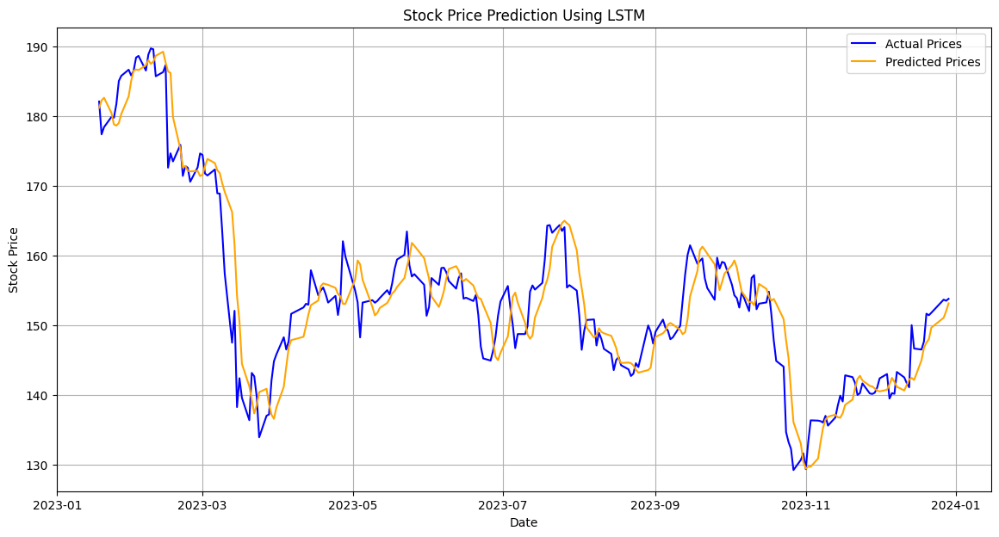

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━

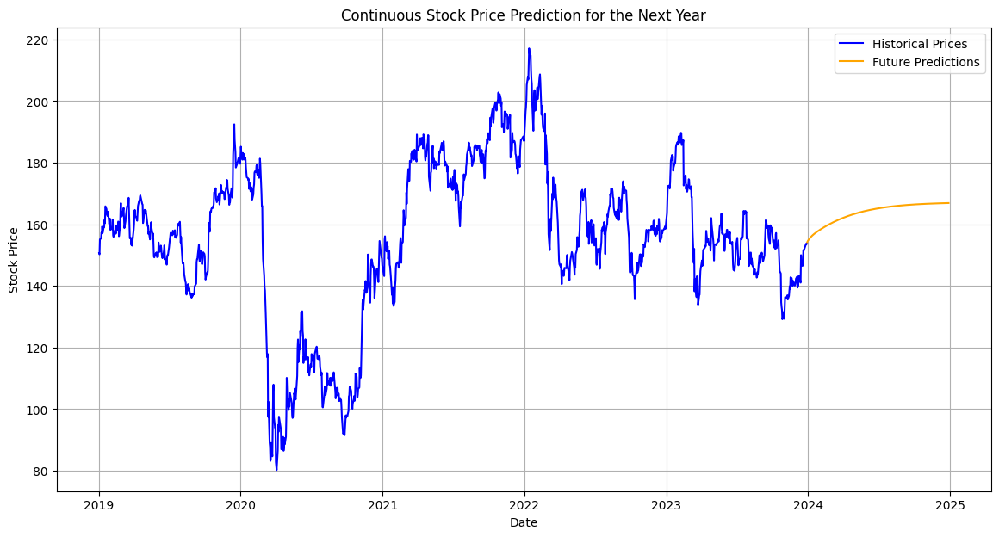

Mean Absolute Error (MAE): 2.5621683756510416
Mean Squared Error (MSE): 12.008444320457055
Root Mean Squared Error (RMSE): 3.465320233464298
RSE of the base model: 0.9319937514204741





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


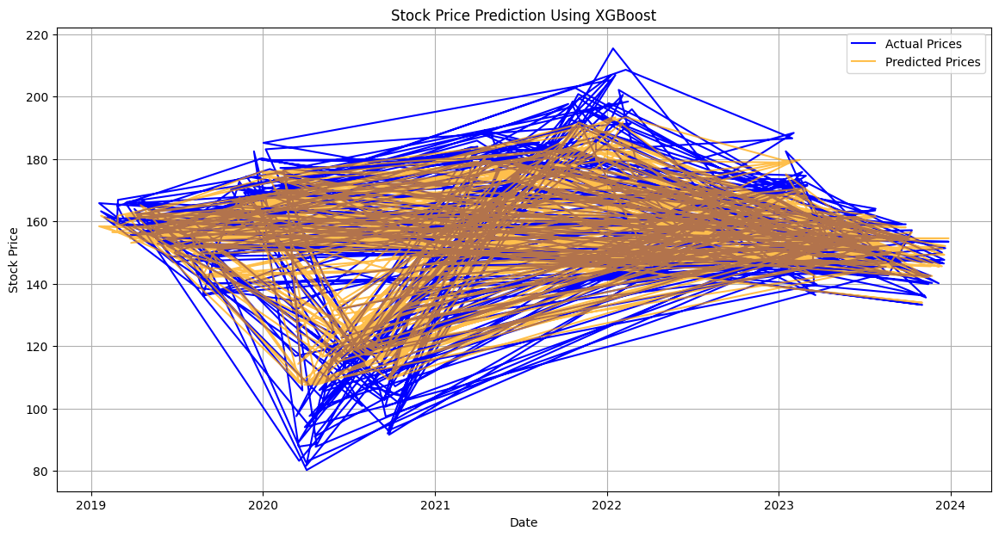

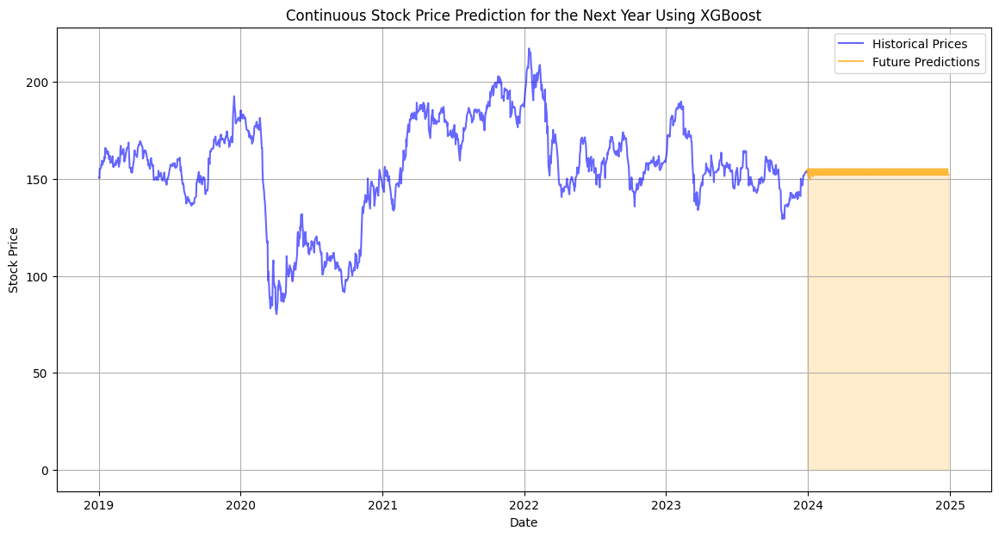




Predicted trend for next year: Down





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


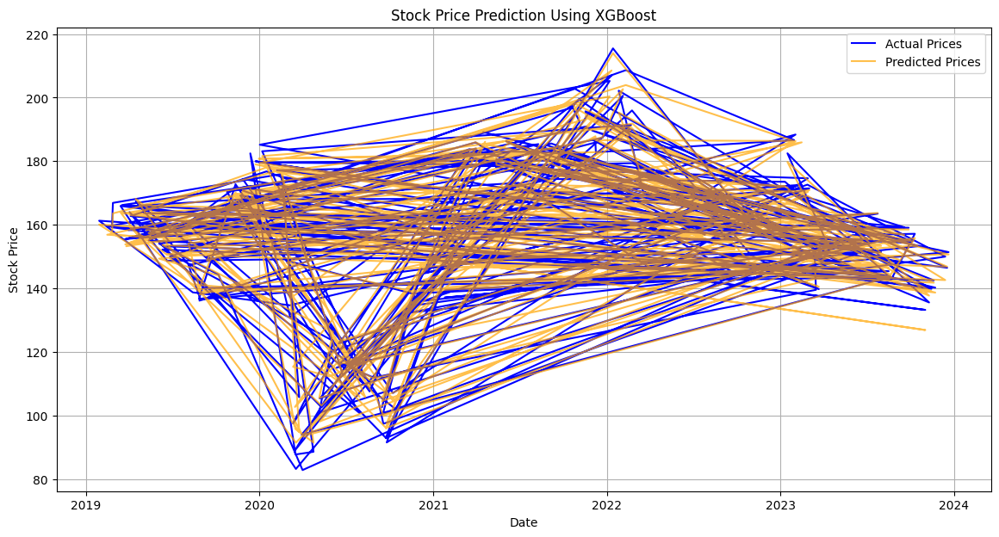

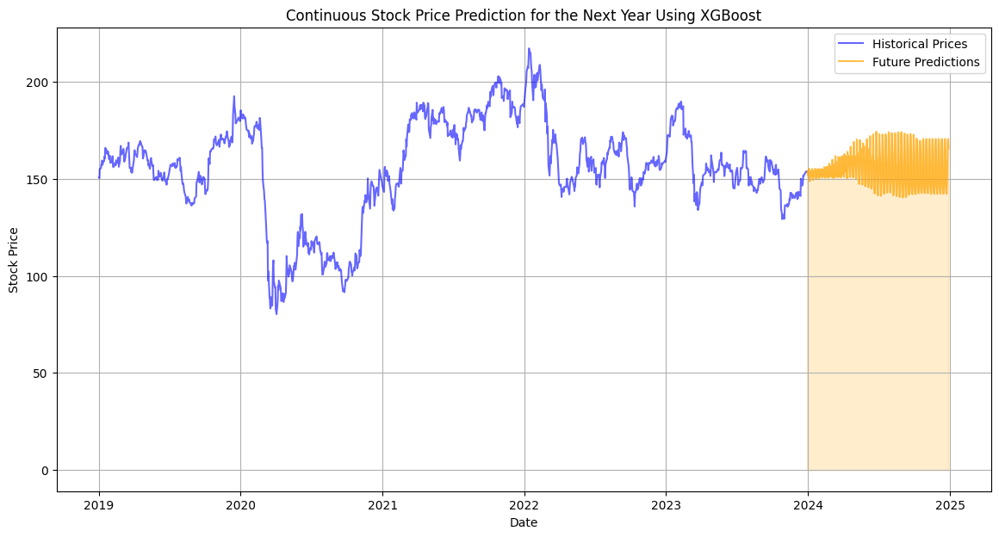




Predicted trend for next year: Down





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM




------------------------------
MSE: 13.53
RMSE: 3.68
MAE: 2.52
R2 Score: 0.98
------------------------------





<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


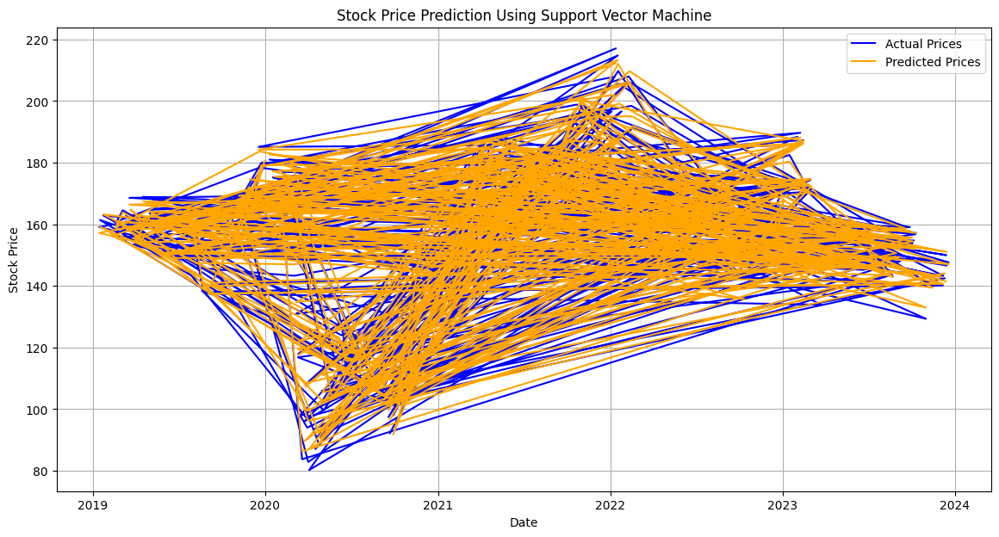

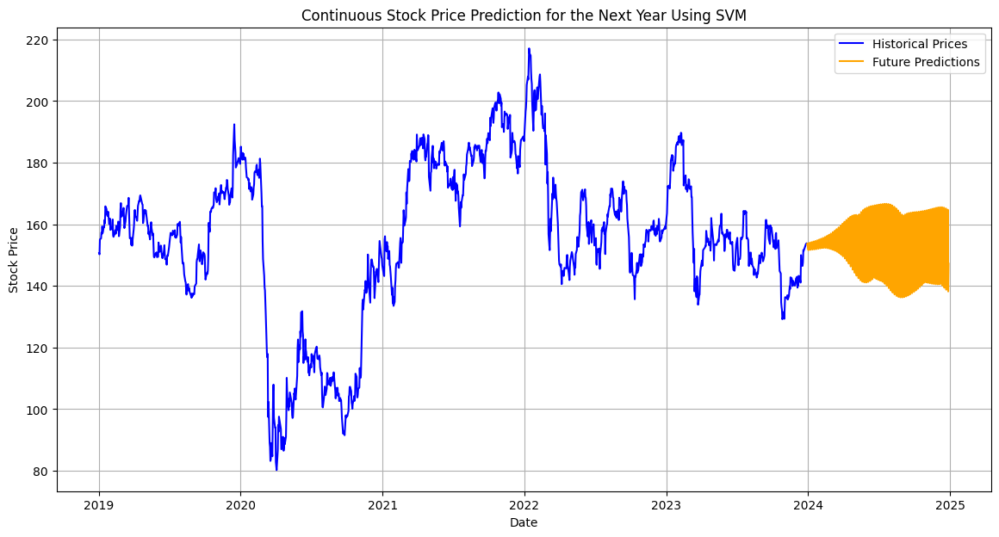

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 14.91
RMSE: 3.86
MAE: 2.60
R2 Score: 0.98
------------------------------





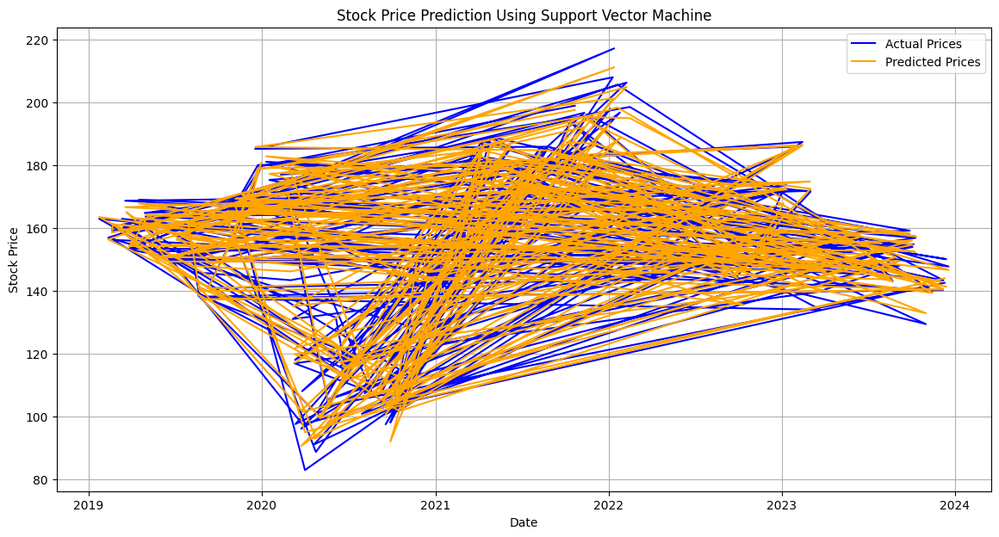

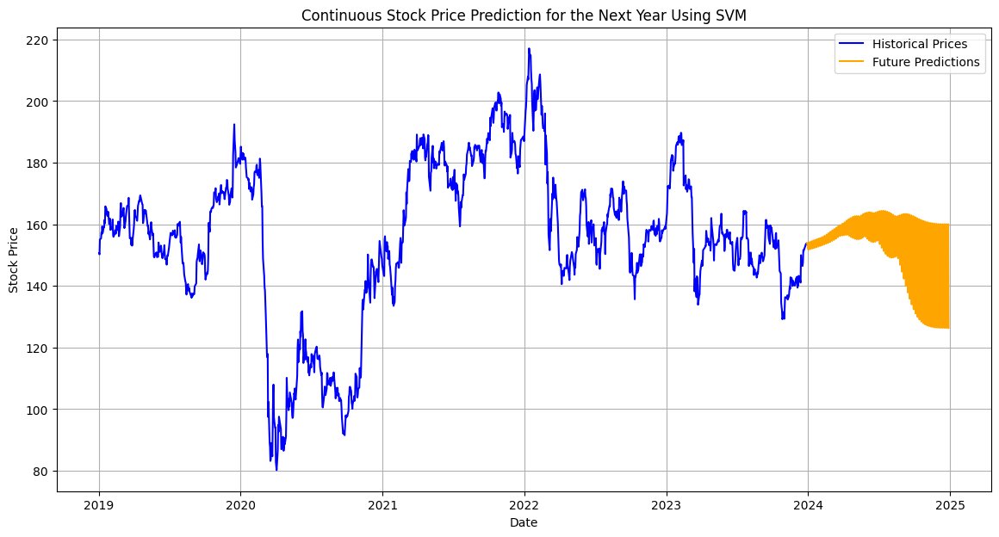

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **Lloyds  LLOY.L**

In [ ]:
# Fetching data for Lloyds  (LLOY.L)
ticker = "LLOY.L"
data = yf.download(ticker, start="2019-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,LLOY.L,LLOY.L,LLOY.L,LLOY.L,LLOY.L,LLOY.L
Date,,,,,,
2019-01-02 00:00:00+00:00,40.189106,51.000000,51.369999,50.169998,50.660000,142576767
2019-01-03 00:00:00+00:00,40.346722,51.200001,51.680000,50.590000,50.930000,146329323
2019-01-04 00:00:00+00:00,41.607552,52.799999,52.990002,51.680000,52.020000,133867623
2019-01-07 00:00:00+00:00,42.040962,53.349998,53.650002,53.099998,53.470001,246624166
2019-01-08 00:00:00+00:00,42.316772,53.700001,54.220001,53.470001,53.599998,124666165


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1259 entries, 2019-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (Adj Close, LLOY.L)  1259 non-null   float64
 1   (Close, LLOY.L)      1259 non-null   float64
 2   (High, LLOY.L)       1259 non-null   float64
 3   (Low, LLOY.L)        1259 non-null   float64
 4   (Open, LLOY.L)       1259 non-null   float64
 5   (Volume, LLOY.L)     1259 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 68.9 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker       LLOY.L       LLOY.L       LLOY.L       LLOY.

**EDA Analysis**

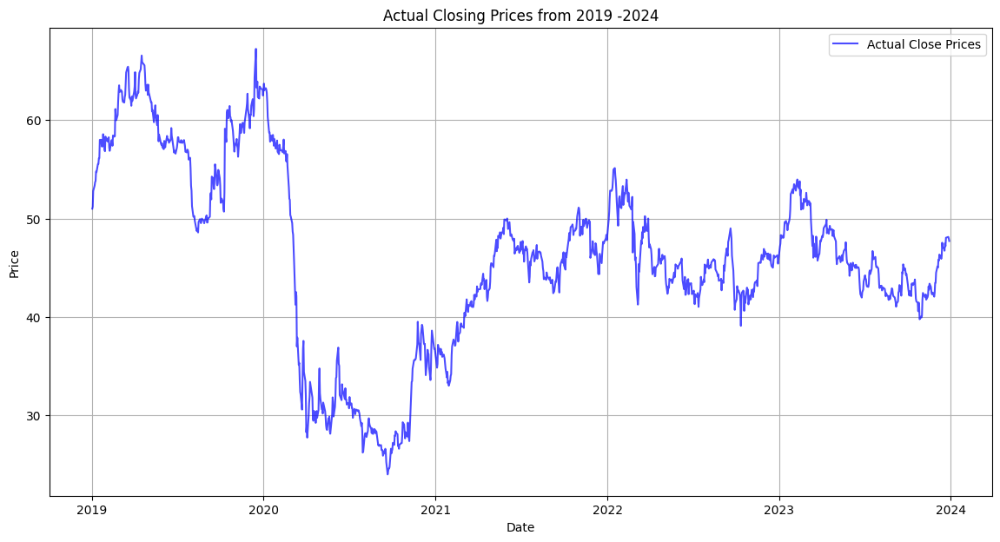

Close column head:
 Date
2019-01-02 00:00:00+00:00    51.000000
2019-01-03 00:00:00+00:00    51.200001
2019-01-04 00:00:00+00:00    52.799999
2019-01-07 00:00:00+00:00    53.349998
2019-01-08 00:00:00+00:00    53.700001
Name: (Close, LLOY.L), dtype: float64
Statistics for Close column:
 count    1259.000000
mean       45.972543
std         9.265835
min        23.980000
25%        42.075001
50%        45.840000
75%        51.420000
max        67.250000
Name: (Close, LLOY.L), dtype: float64


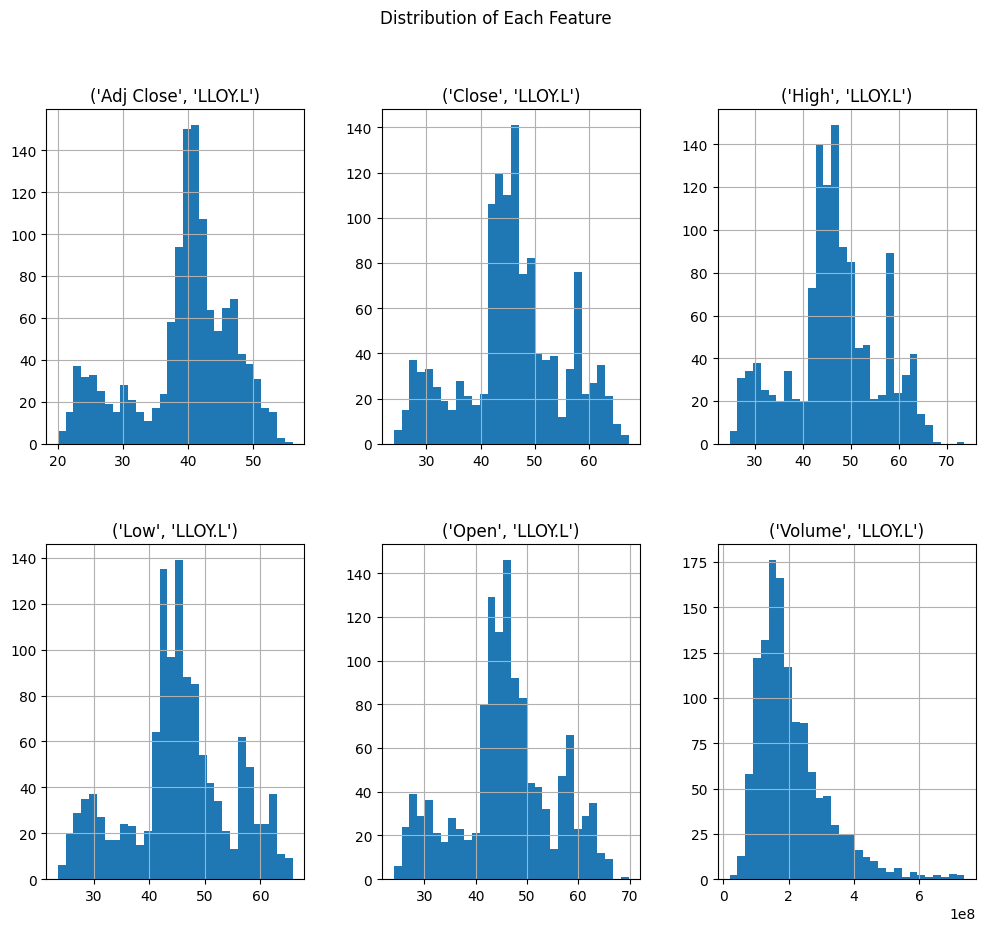

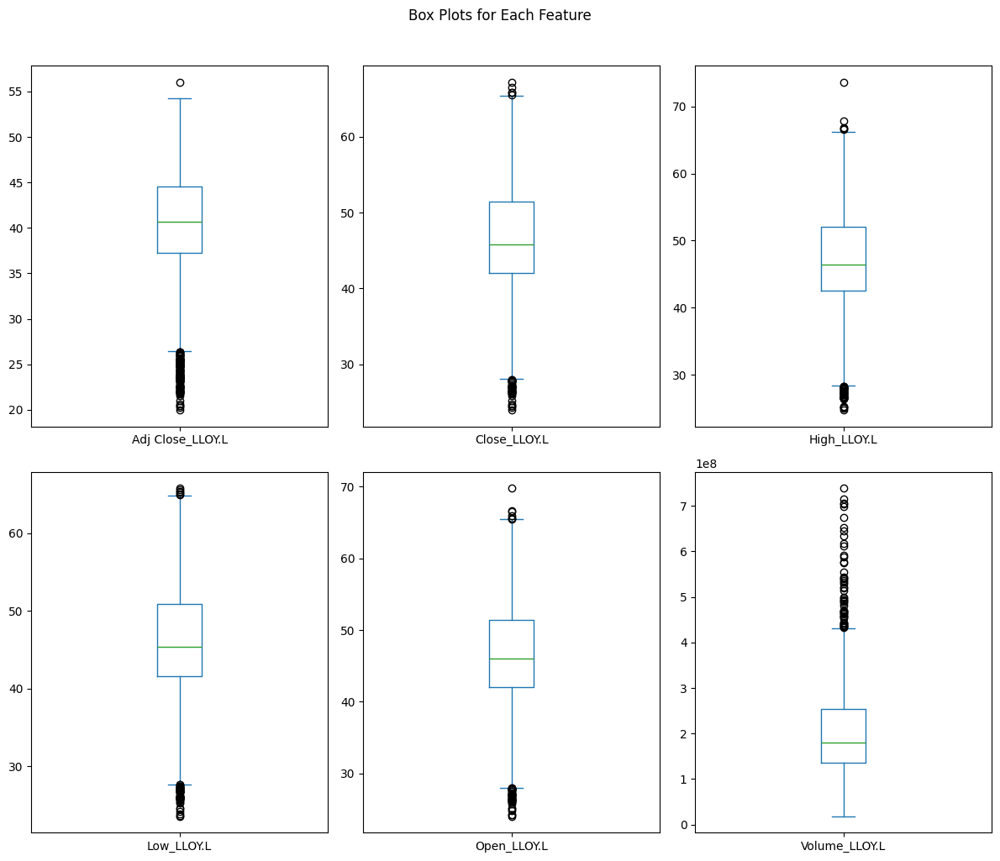

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


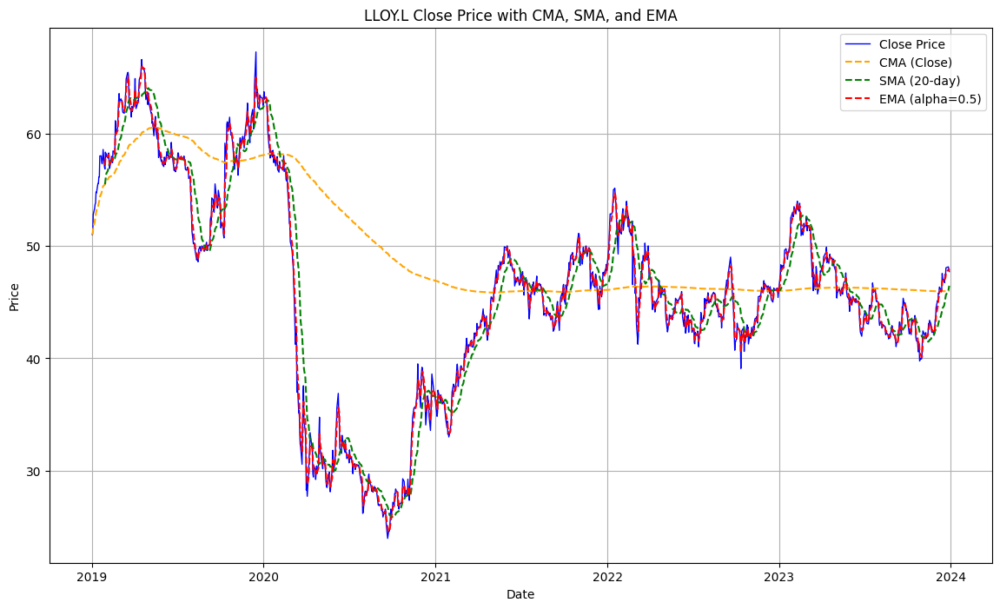

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       0.2755
Mean Absolute Error (MAE):      0.3911
Root Mean Squared Error (RMSE): 0.5249047822406533
Root Square Error (RSE):        0.9970
------------------------------


<ipython-input-43-6ddfd697081f>:37: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


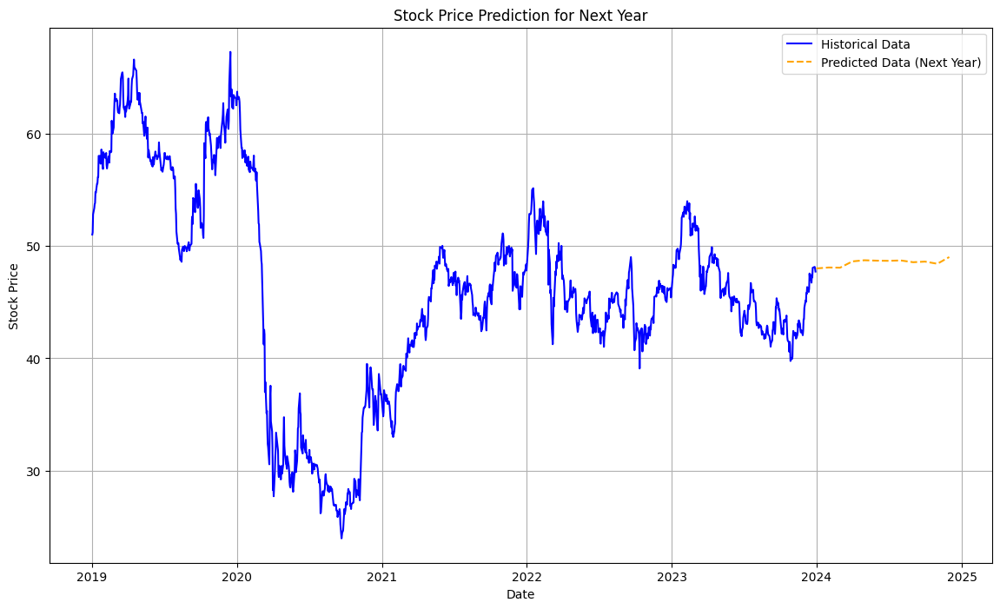

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.54
F1 Score: 0.51
Precision: 0.50
Recall: 0.53
------------------------------------------------------------


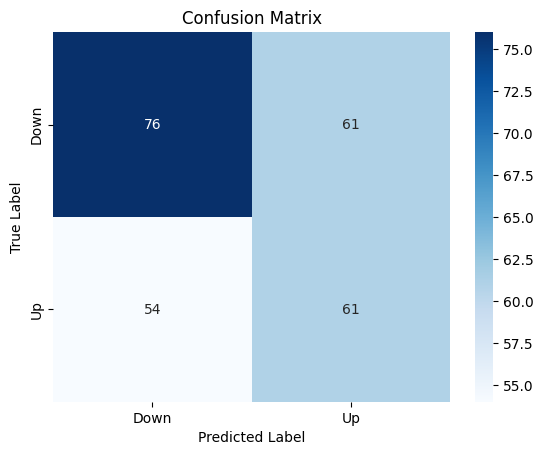

The stock price is predicted to go DOWN.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


30/30 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - loss: 0.1217
Epoch 2/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 78ms/step - loss: 0.0096
Epoch 3/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 55ms/step - loss: 0.0063
Epoch 4/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0058
Epoch 5/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 45ms/step - loss: 0.0054
Epoch 6/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0048
Epoch 7/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0047
Epoch 8/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 59ms/step - loss: 0.0048
Epoch 9/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - loss: 0.0045
Epoch 10/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - loss: 0.0048
Epoch 11/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step - loss: 0.0039
Epoch 12/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0043
Epoch 13/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step - loss: 0.0040
Epoch 14/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - loss: 0.0041
Epoch 15/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.0038
Epoch 16/50
30/

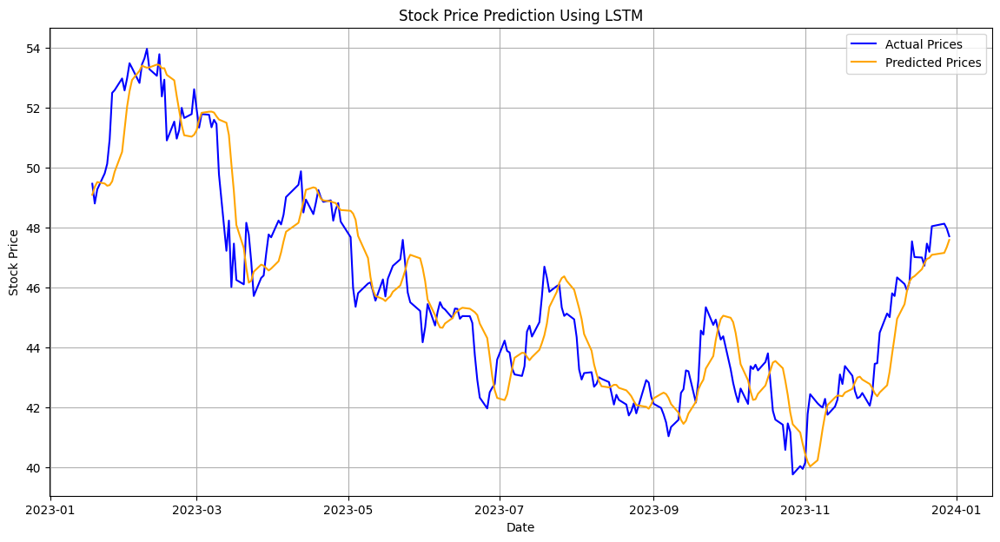

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━

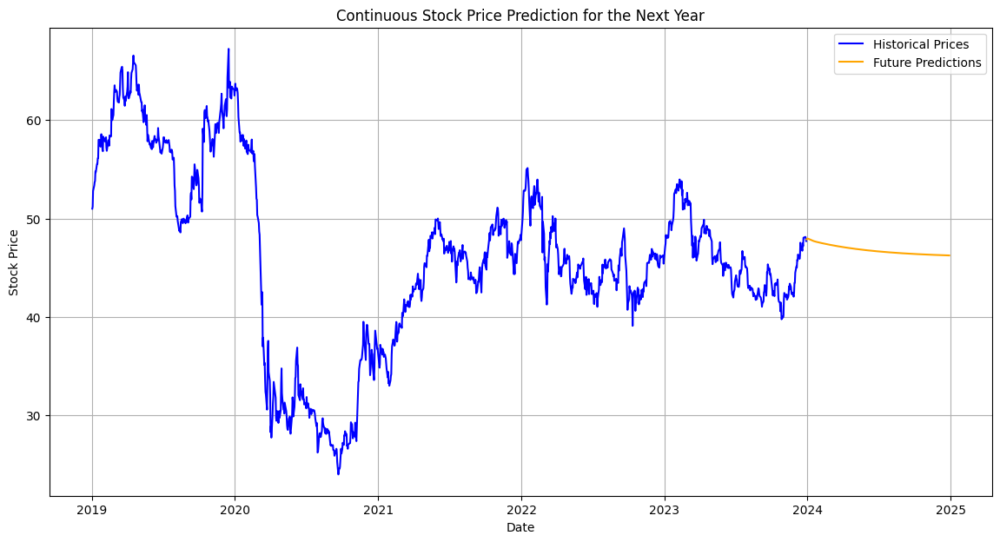

Mean Absolute Error (MAE): 0.7555465380350751
Mean Squared Error (MSE): 0.9520878642171741
Root Mean Squared Error (RMSE): 0.9757498983946522
RSE of the base model: 0.9205201203255625





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


24/24 ━━━━━━━━━━━━━━━━━━━━ 5s 70ms/step - loss: 0.1924
Epoch 2/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - loss: 0.0186
Epoch 3/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 52ms/step - loss: 0.0086
Epoch 4/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - loss: 0.0058
Epoch 5/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - loss: 0.0052
Epoch 6/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 49ms/step - loss: 0.0061
Epoch 7/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - loss: 0.0055
Epoch 8/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - loss: 0.0049
Epoch 9/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step - loss: 0.0046
Epoch 10/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - loss: 0.0049
Epoch 11/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - loss: 0.0049
Epoch 12/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - loss: 0.0047
Epoch 13/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 52ms/step - loss: 0.0047
Epoch 14/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - loss: 0.0046
Epoch 15/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - loss: 0.0051
E

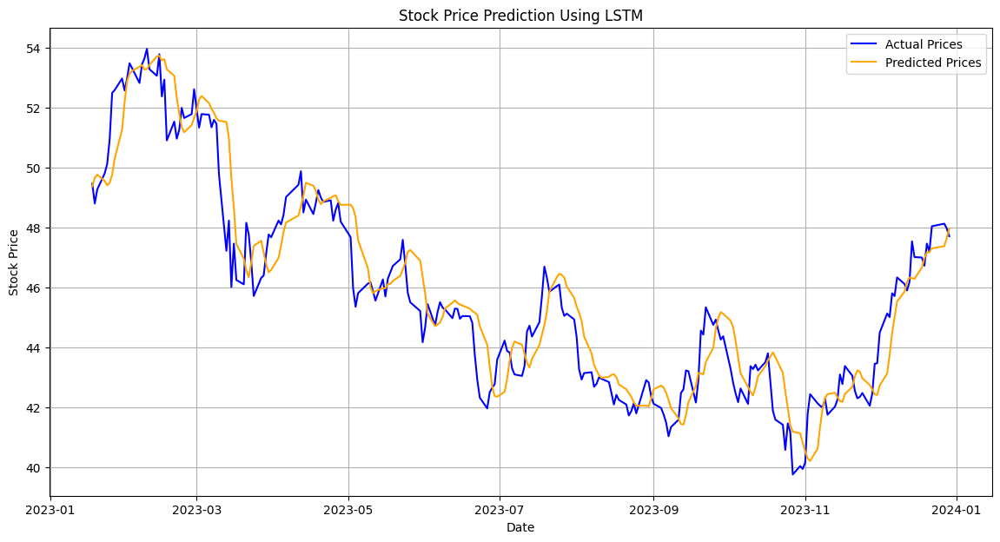

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━

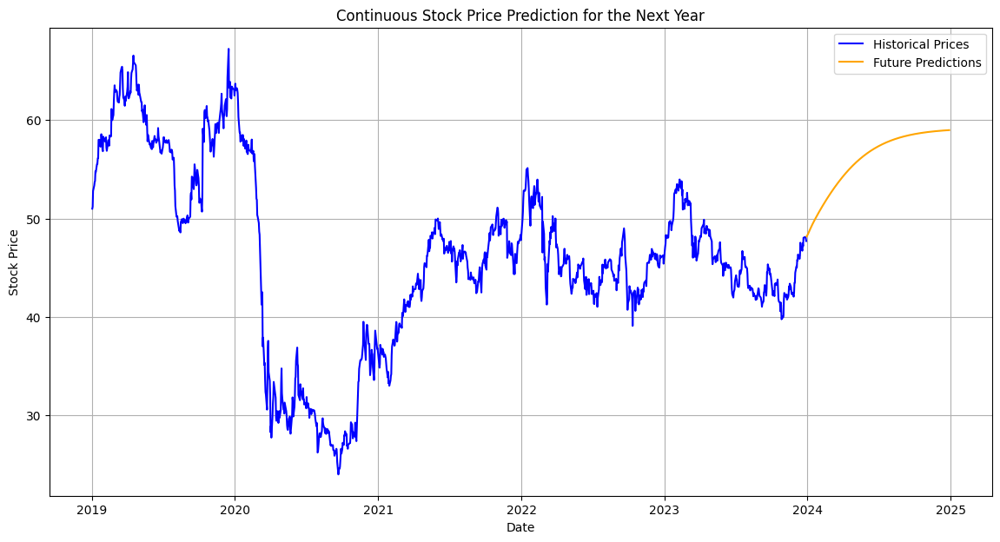

Mean Absolute Error (MAE): 0.6602127234141032
Mean Squared Error (MSE): 0.7434266008356042
Root Mean Squared Error (RMSE): 0.8622218976780885
RSE of the base model: 0.9379390715900231





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


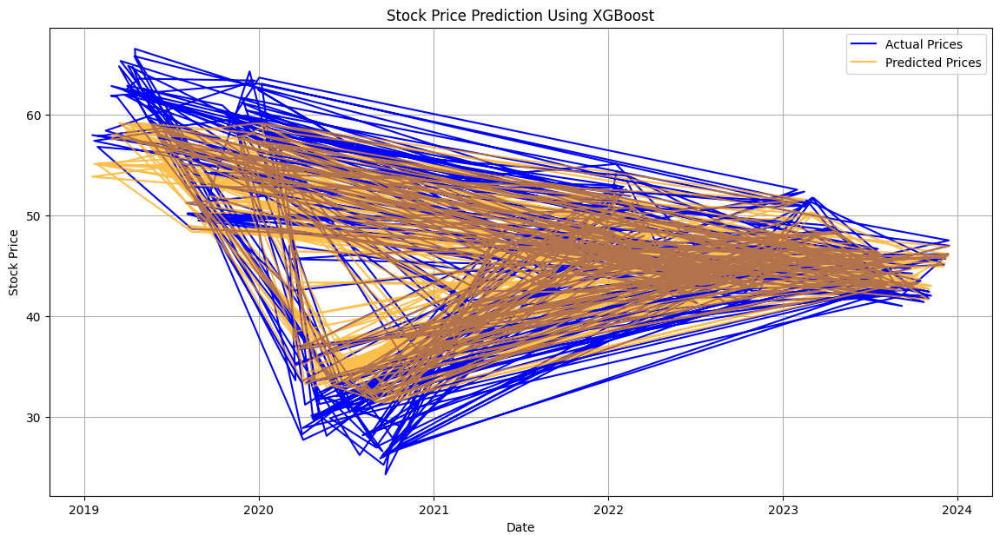

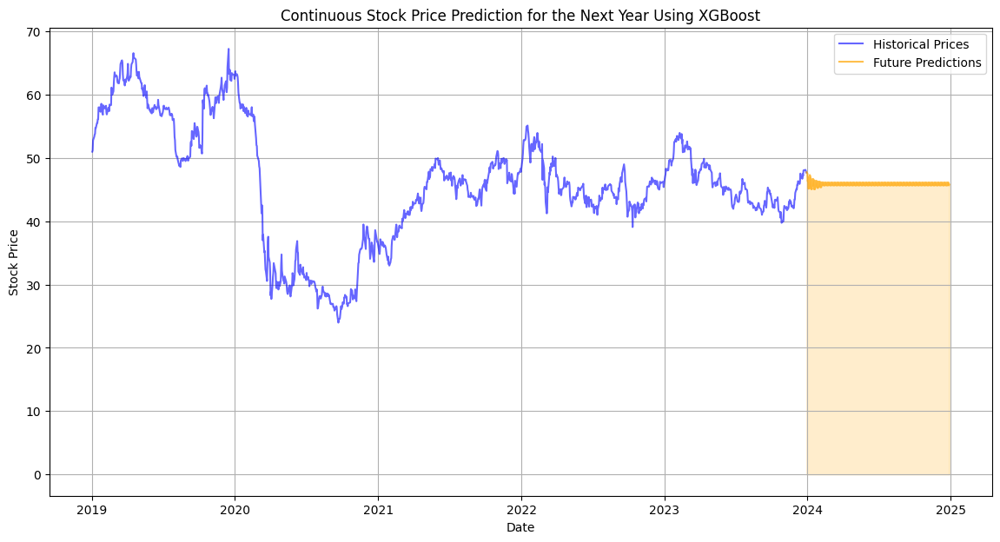




Predicted trend for next year: Up





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


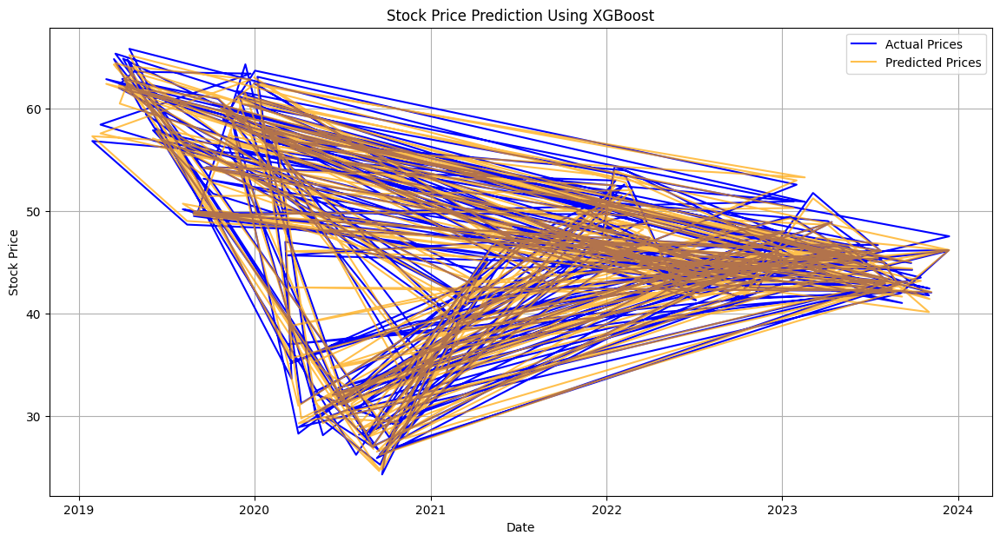

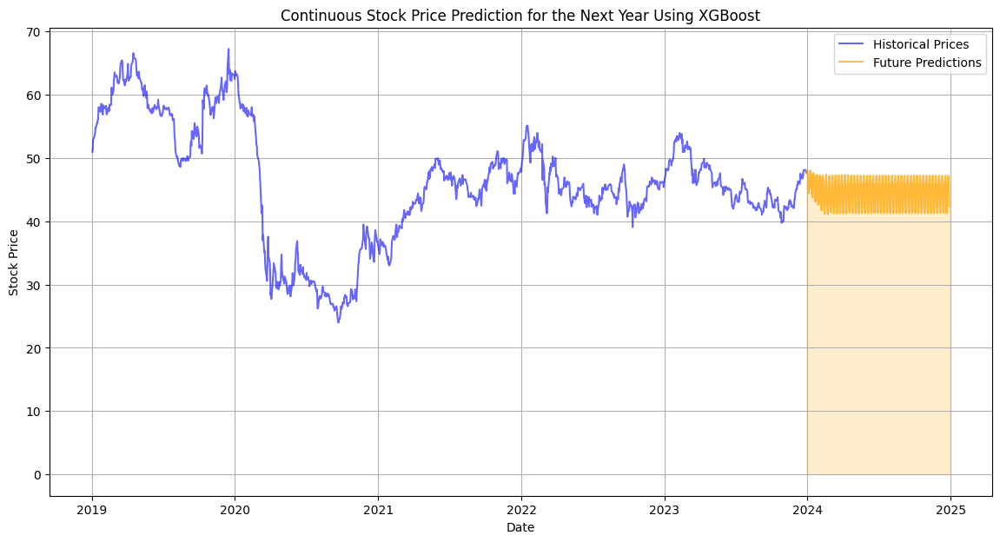




Predicted trend for next year: Down





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM




------------------------------
MSE: 1.08
RMSE: 1.04
MAE: 0.71
R2 Score: 0.99
------------------------------





<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


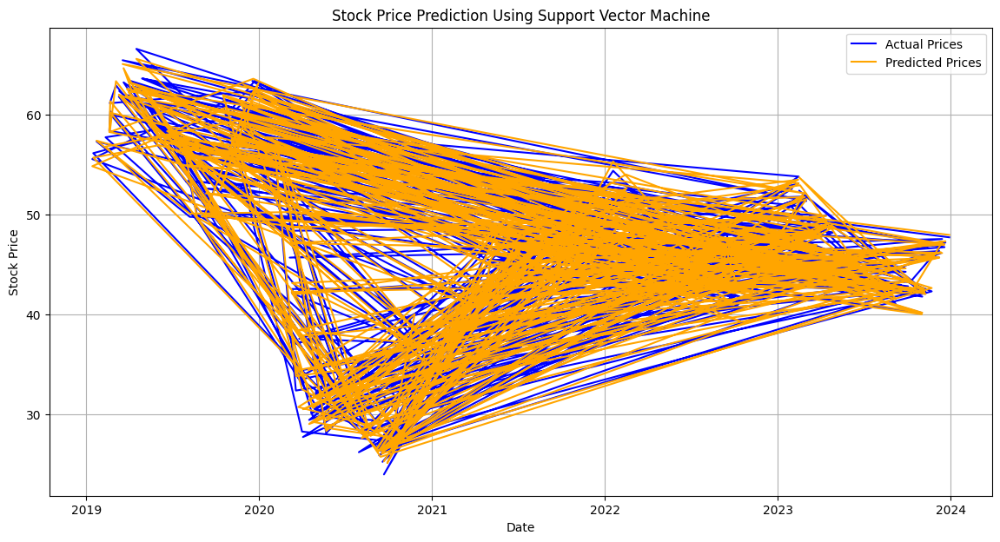

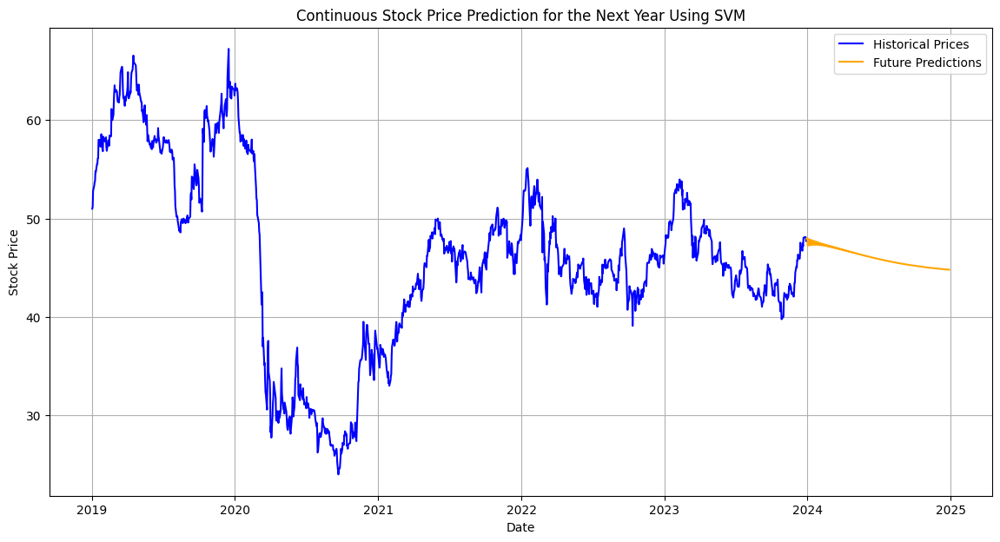

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)





------------------------------
MSE: 1.14
RMSE: 1.07
MAE: 0.72
R2 Score: 0.99
------------------------------





/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


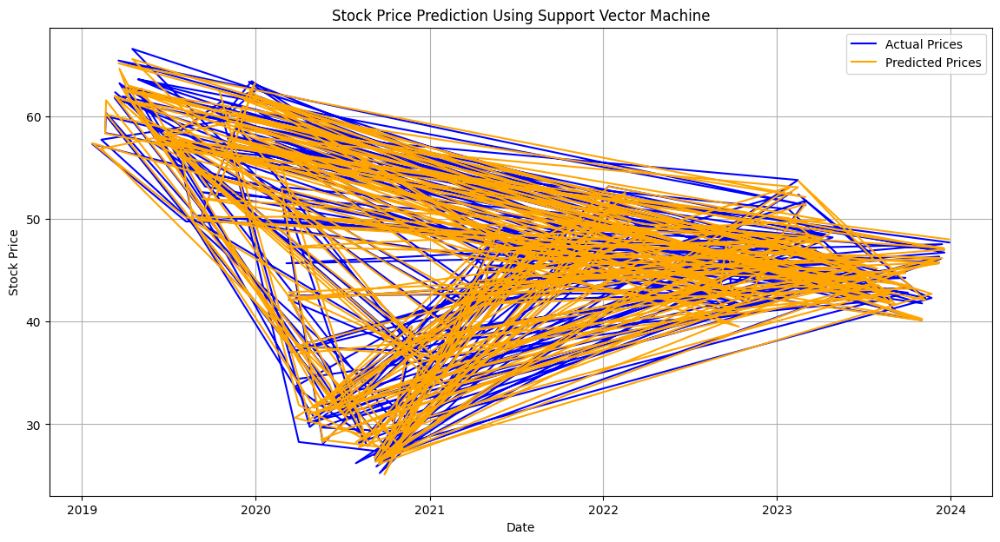

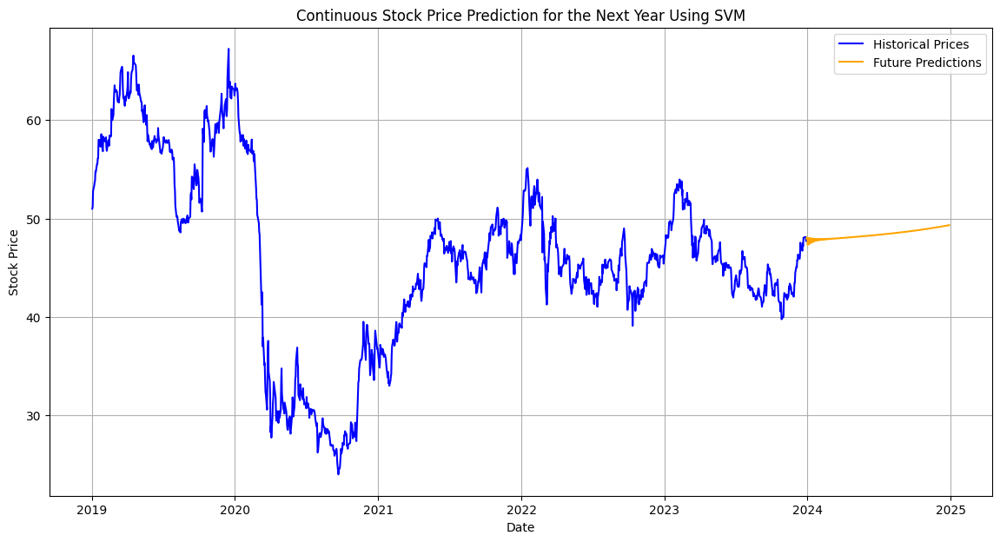

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **HSBC   HSBA.L**

In [ ]:
# Fetching data for Lloyds  (HSBA.L)
ticker = "HSBA.L"
data = yf.download(ticker, start="2019-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,HSBA.L,HSBA.L,HSBA.L,HSBA.L,HSBA.L,HSBA.L
Date,,,,,,
2019-01-02 00:00:00+00:00,468.009552,646.599976,648.500000,630.099976,636.400024,20316982
2019-01-03 00:00:00+00:00,464.245758,641.400024,647.500000,639.299988,643.500000,16933833
2019-01-04 00:00:00+00:00,475.175140,656.500000,658.200012,644.799988,649.200012,21529037
2019-01-07 00:00:00+00:00,464.752441,642.099976,650.299988,639.299988,650.000000,21716788
2019-01-08 00:00:00+00:00,469.818939,649.099976,654.000000,643.299988,644.900024,15291399


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1261 entries, 2019-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (Adj Close, HSBA.L)  1261 non-null   float64
 1   (Close, HSBA.L)      1261 non-null   float64
 2   (High, HSBA.L)       1261 non-null   float64
 3   (Low, HSBA.L)        1261 non-null   float64
 4   (Open, HSBA.L)       1261 non-null   float64
 5   (Volume, HSBA.L)     1261 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 69.0 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker       HSBA.L       HSBA.L       HSBA.L       HSBA.

**EDA Analysis**

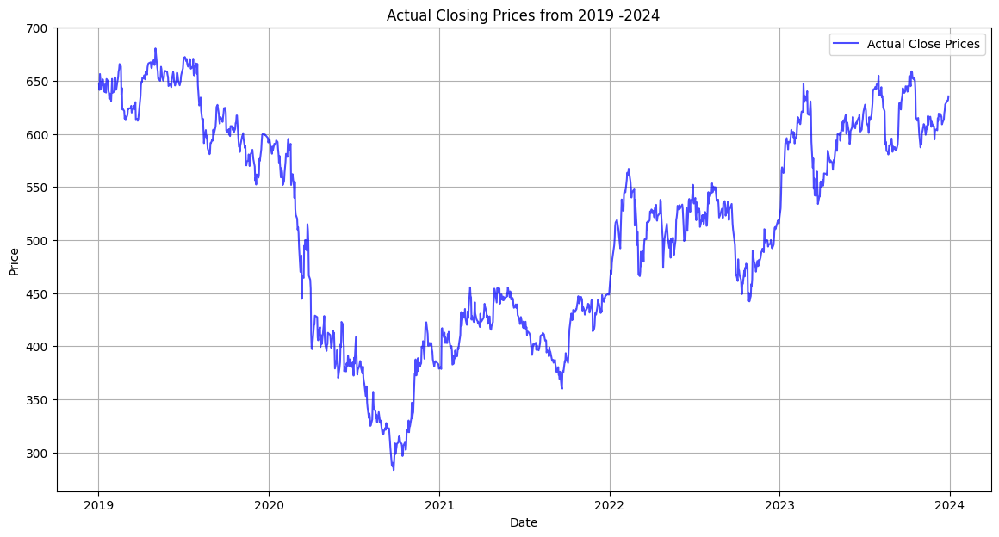

Close column head:
 Date
2019-01-02 00:00:00+00:00    646.599976
2019-01-03 00:00:00+00:00    641.400024
2019-01-04 00:00:00+00:00    656.500000
2019-01-07 00:00:00+00:00    642.099976
2019-01-08 00:00:00+00:00    649.099976
Name: (Close, HSBA.L), dtype: float64
Statistics for Close column:
 count    1261.000000
mean      514.713305
std       101.300054
min       283.350006
25%       424.350006
50%       525.000000
75%       606.400024
max       680.599976
Name: (Close, HSBA.L), dtype: float64


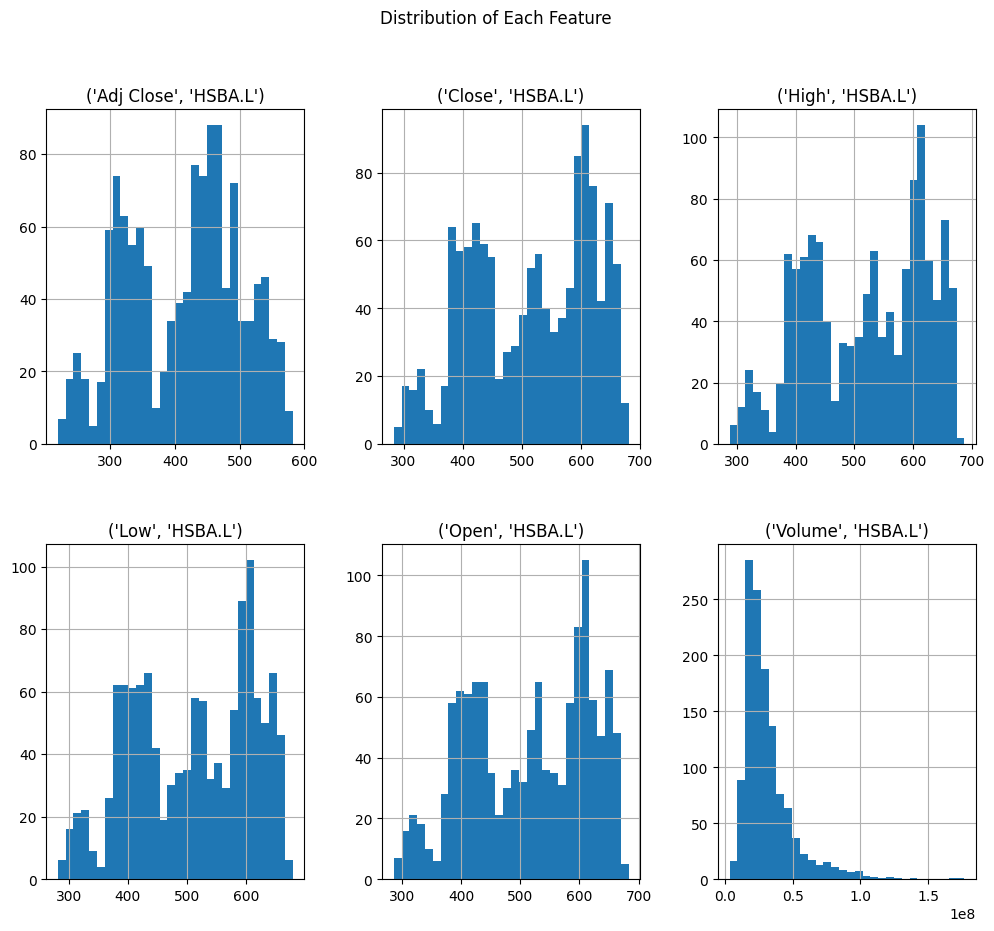

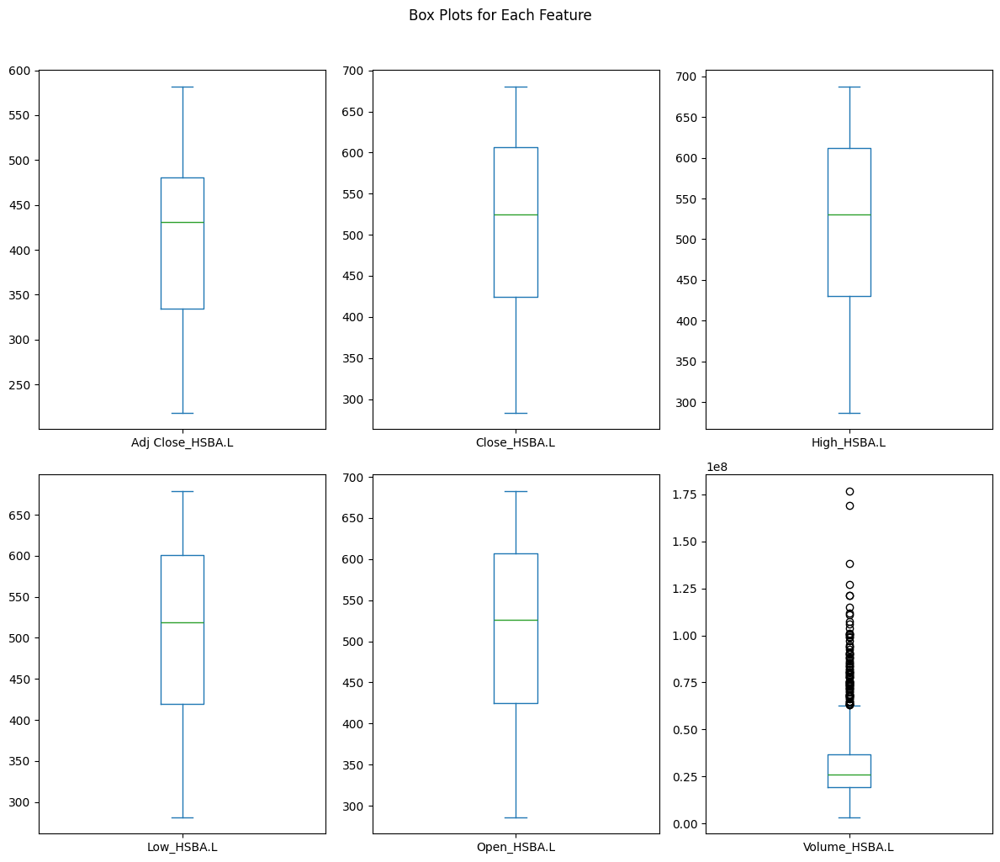

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


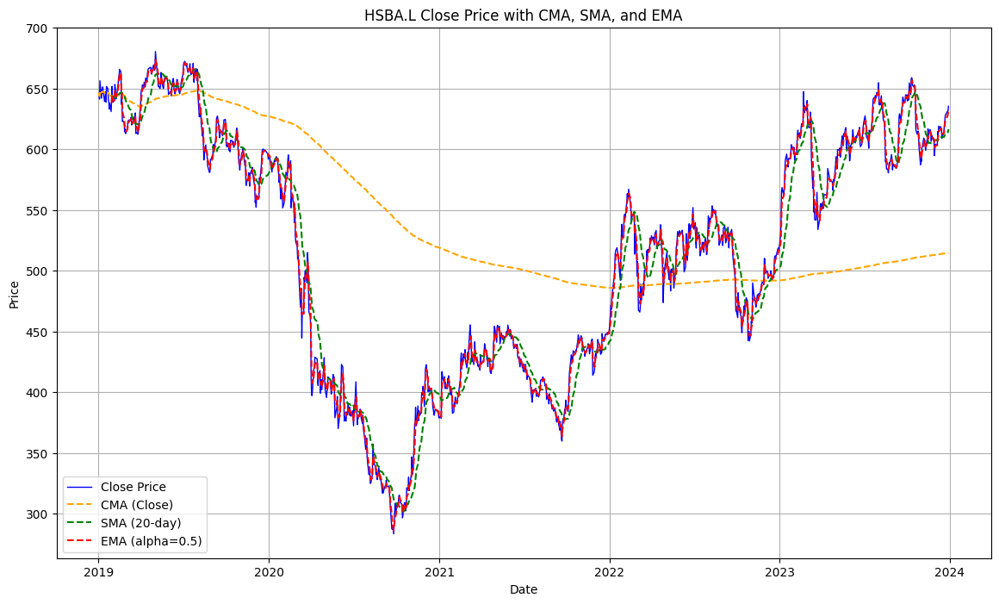

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       25.7161
Mean Absolute Error (MAE):      3.6581
Root Mean Squared Error (RMSE): 5.071102696946678
Root Square Error (RSE):        0.9975
------------------------------


<ipython-input-43-6ddfd697081f>:37: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


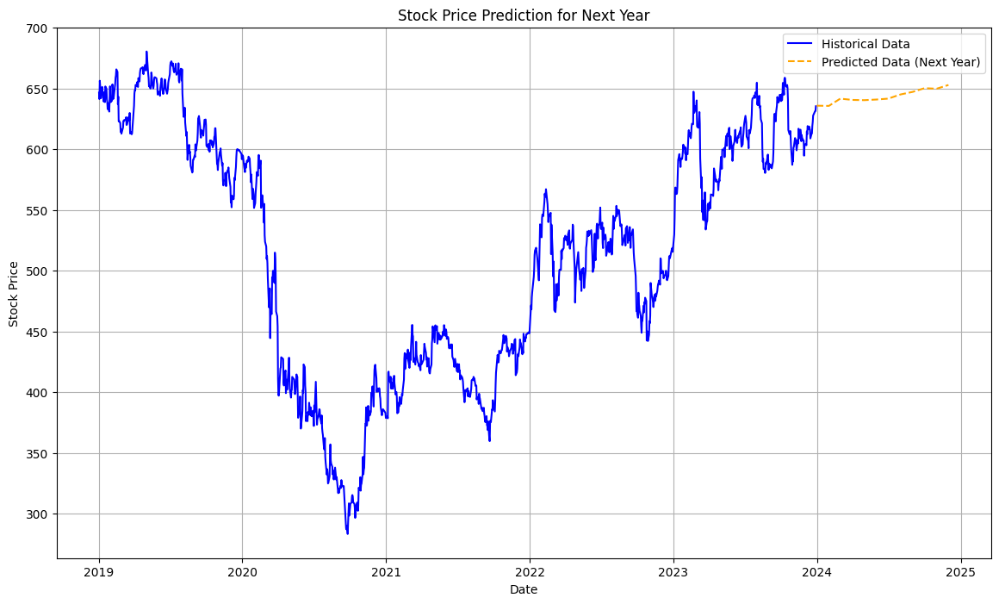

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.50
F1 Score: 0.50
Precision: 0.49
Recall: 0.50
------------------------------------------------------------


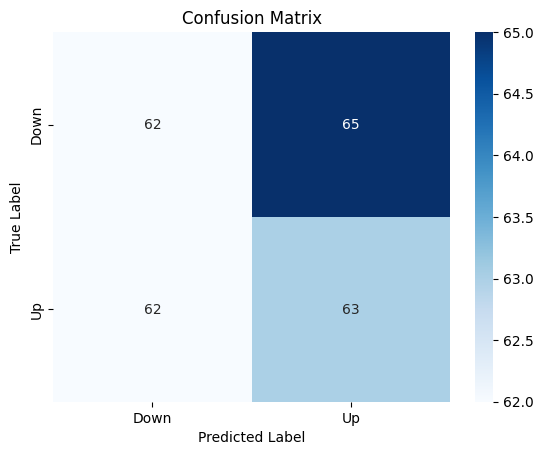

The stock price is predicted to go UP.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


30/30 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - loss: 0.1296
Epoch 2/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0079
Epoch 3/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0055
Epoch 4/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0046
Epoch 5/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0048
Epoch 6/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - loss: 0.0041
Epoch 7/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0041
Epoch 8/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step - loss: 0.0046
Epoch 9/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0039
Epoch 10/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0042
Epoch 11/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0039
Epoch 12/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0046
Epoch 13/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0043
Epoch 14/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0041
Epoch 15/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0041
Epoch 16/50
30/

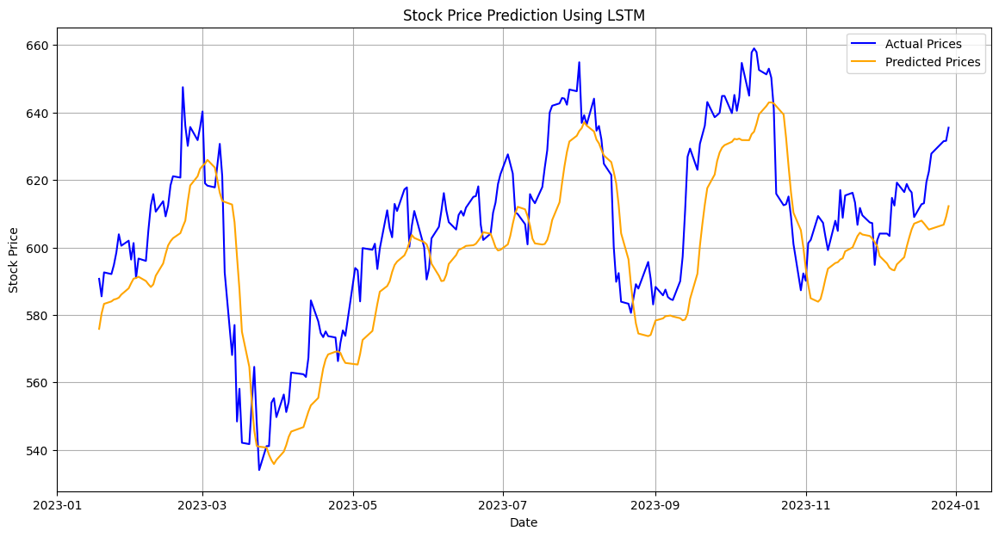

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━

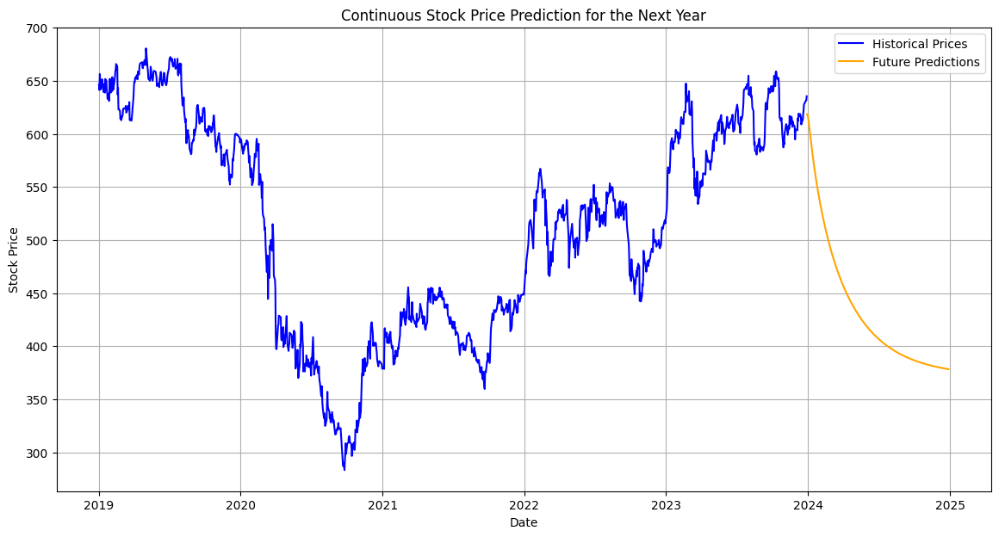

Mean Absolute Error (MAE): 12.86714146931966
Mean Squared Error (MSE): 228.7168353775982
Root Mean Squared Error (RMSE): 15.123387033915325
RSE of the base model: 0.6569443503822519





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


24/24 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - loss: 0.1403
Epoch 2/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - loss: 0.0092
Epoch 3/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - loss: 0.0079
Epoch 4/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - loss: 0.0068
Epoch 5/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0052
Epoch 6/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0052
Epoch 7/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0048
Epoch 8/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0047
Epoch 9/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0042
Epoch 10/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0045
Epoch 11/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0052
Epoch 12/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - loss: 0.0044
Epoch 13/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step - loss: 0.0043
Epoch 14/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - loss: 0.0044
Epoch 15/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step - loss: 0.0040
E

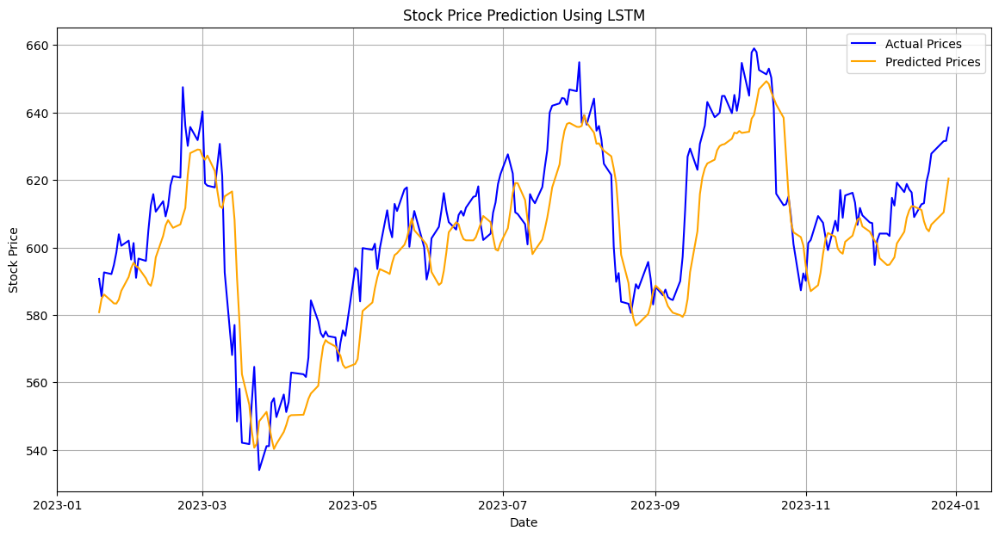

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━

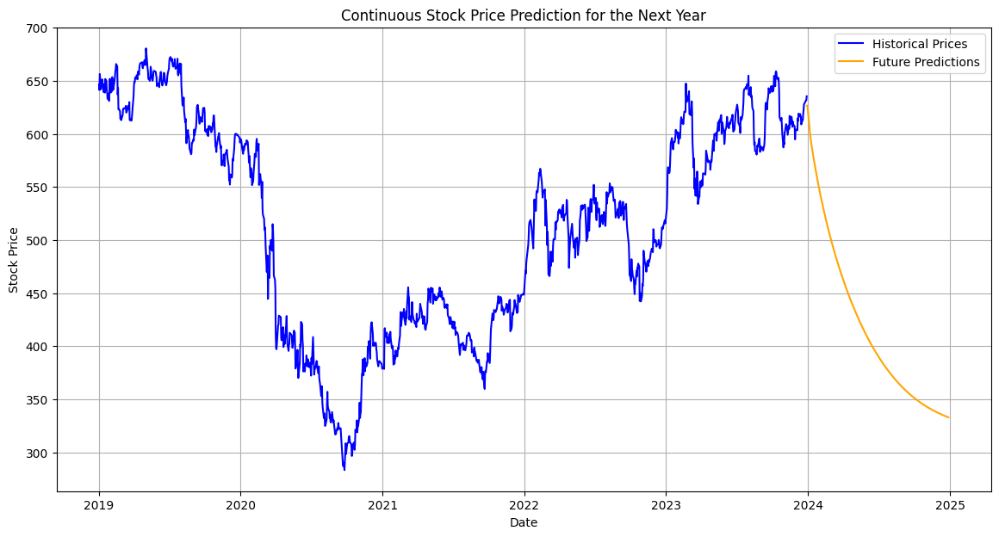

Mean Absolute Error (MAE): 9.625733184814454
Mean Squared Error (MSE): 138.92707081674598
Root Mean Squared Error (RMSE): 11.786732830464343
RSE of the base model: 0.7916213012922889





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


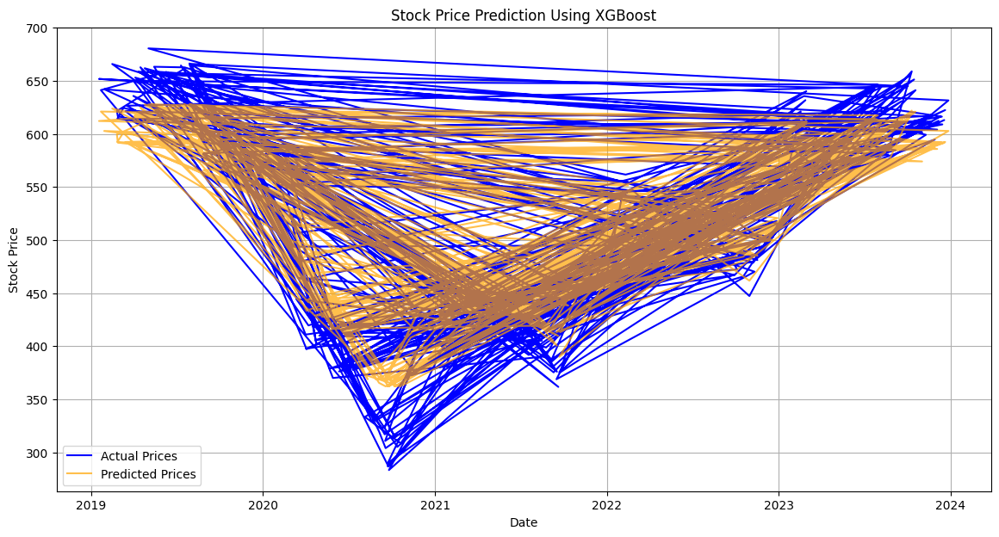

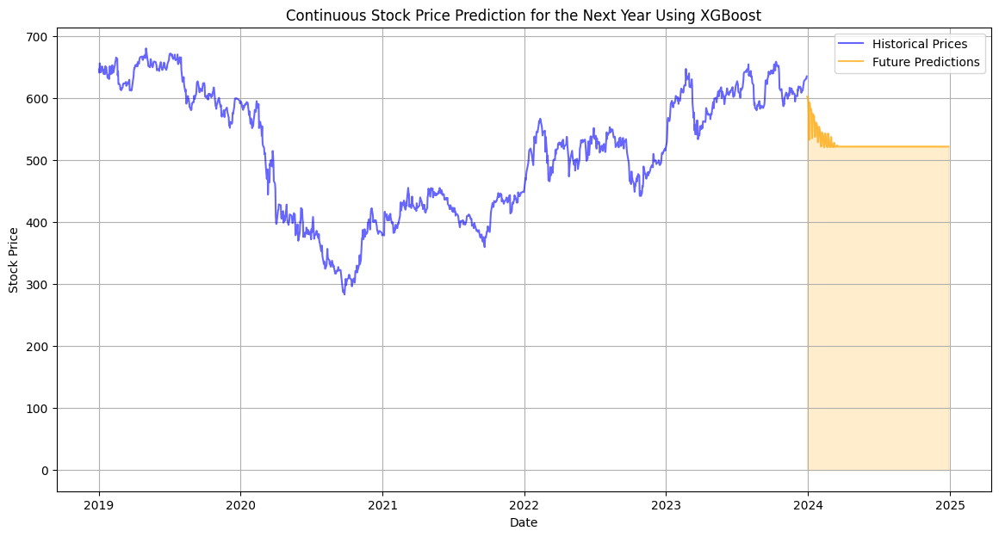




Predicted trend for next year: Down





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


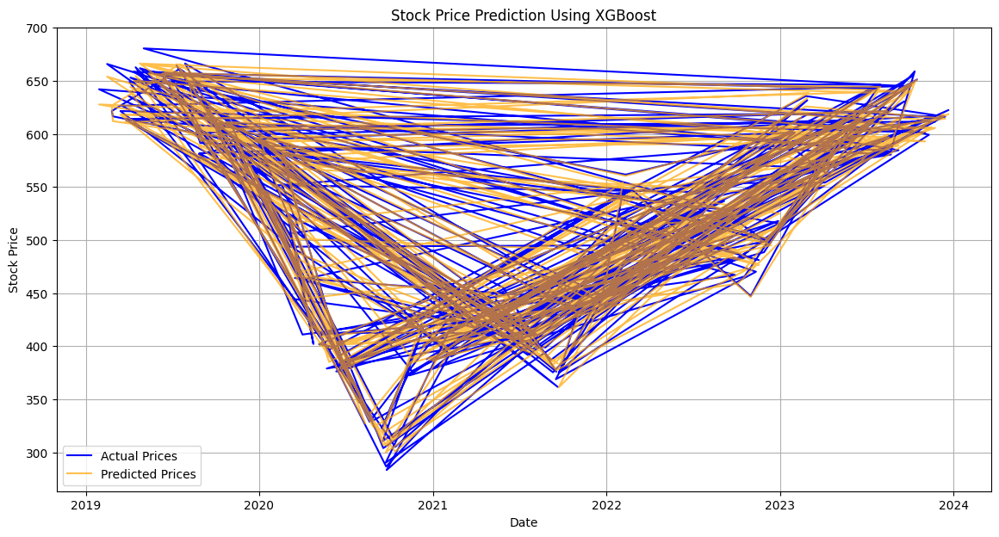

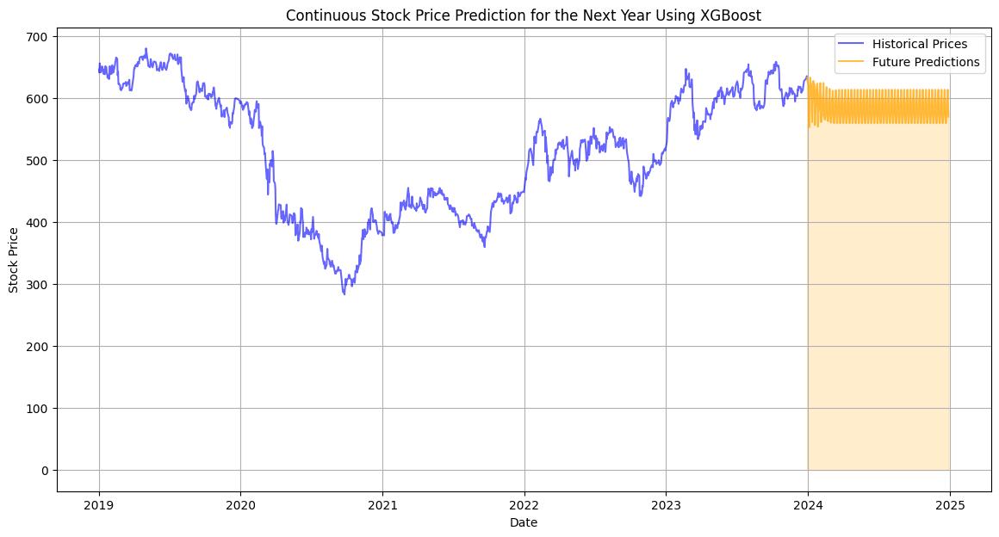




Predicted trend for next year: Down





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM




------------------------------
MSE: 86.25
RMSE: 9.29
MAE: 6.43
R2 Score: 0.99
------------------------------





<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


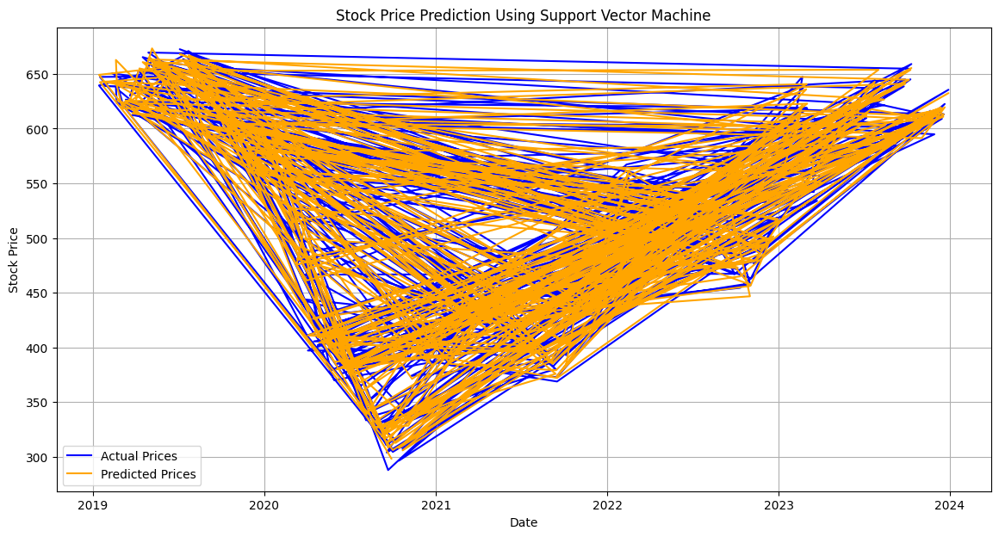

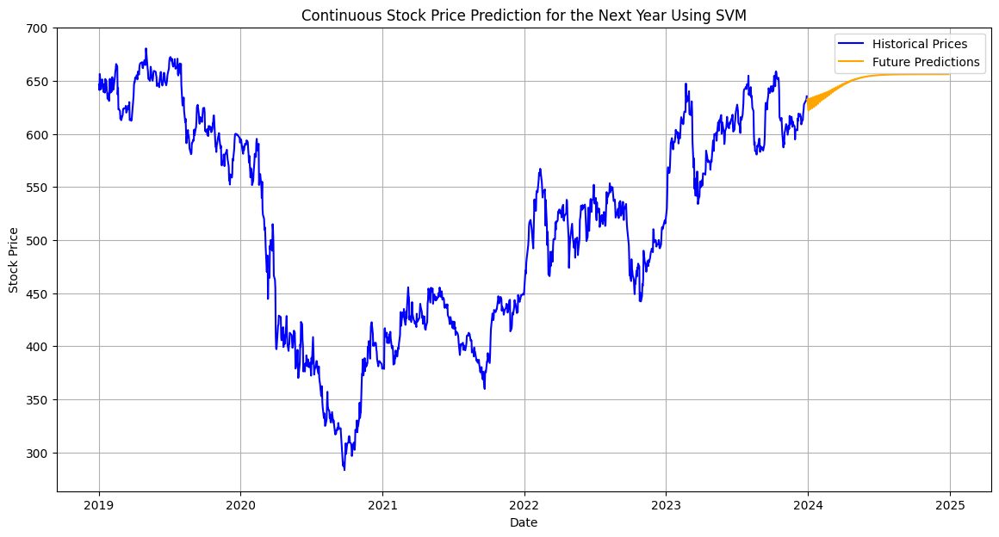

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 101.25
RMSE: 10.06
MAE: 6.92
R2 Score: 0.99
------------------------------





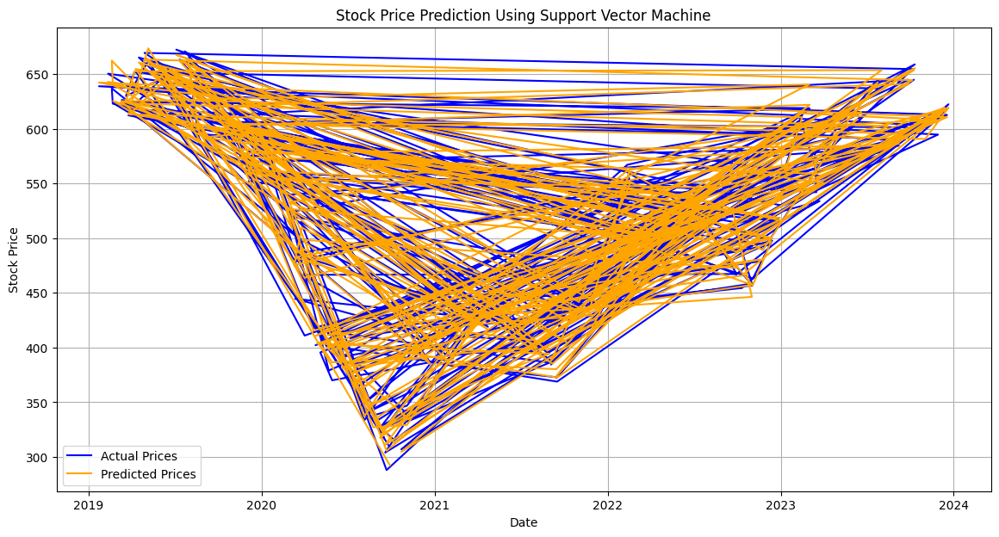

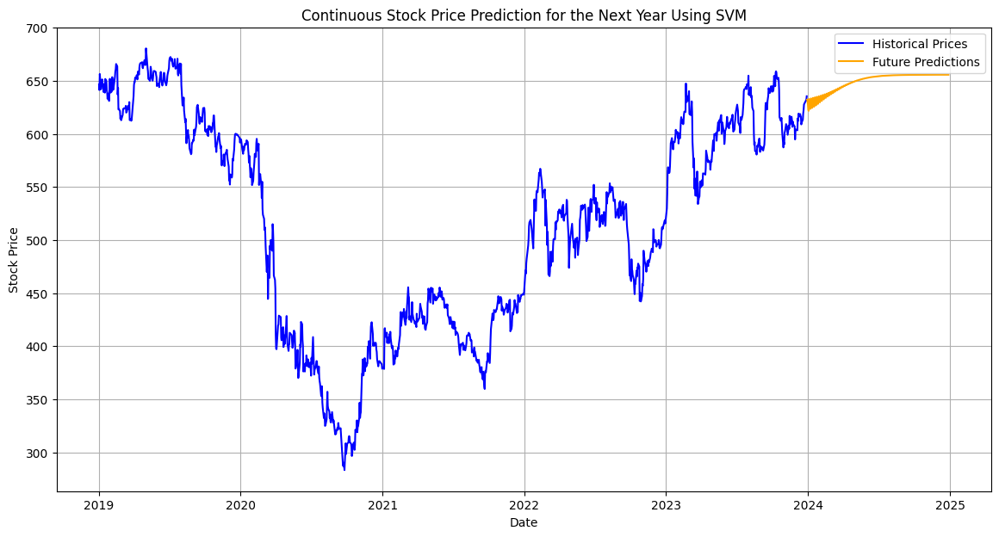

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **NatWest  NWG. L**

In [ ]:
# Fetching data for Lloyds  (NWG.L)
ticker = "NWG.L"
data = yf.download(ticker, start="2019-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,NWG.L,NWG.L,NWG.L,NWG.L,NWG.L,NWG.L
Date,,,,,,
2019-01-02 00:00:00+00:00,162.813629,233.261505,234.015305,225.399902,230.461502,13203199
2019-01-03 00:00:00+00:00,160.182785,229.492294,236.169205,229.061493,231.430695,10047813
2019-01-04 00:00:00+00:00,166.271347,238.215302,238.969193,231.538406,233.369202,11619873
2019-01-07 00:00:00+00:00,168.376038,241.230698,241.661499,239.076904,239.507599,12114582
2019-01-08 00:00:00+00:00,169.729095,243.169205,245.646103,241.123001,241.984604,11210868


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1261 entries, 2019-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   (Adj Close, NWG.L)  1261 non-null   float64
 1   (Close, NWG.L)      1261 non-null   float64
 2   (High, NWG.L)       1261 non-null   float64
 3   (Low, NWG.L)        1261 non-null   float64
 4   (Open, NWG.L)       1261 non-null   float64
 5   (Volume, NWG.L)     1261 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 69.0 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker        NWG.L        NWG.L        NWG.L        NWG.L       

**EDA Analysis**

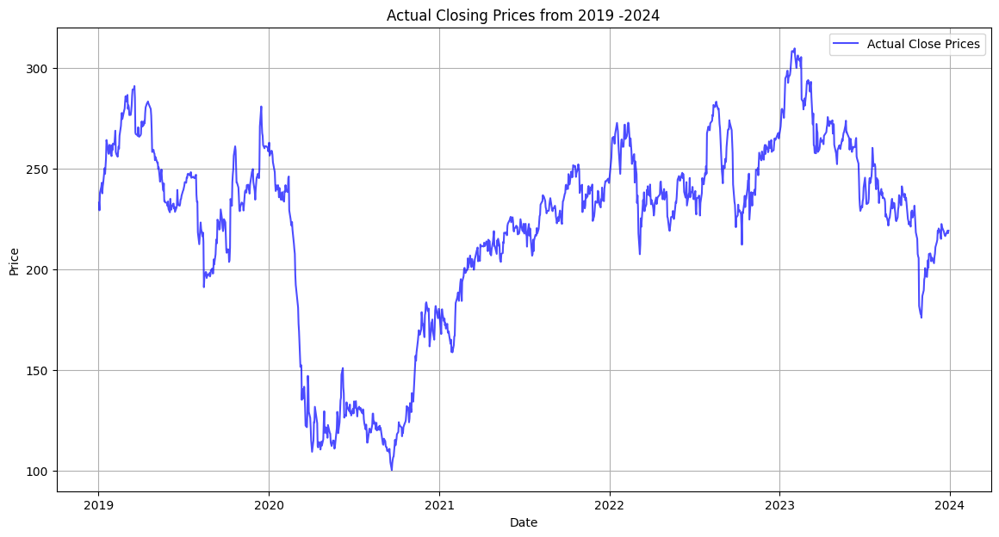

Close column head:
 Date
2019-01-02 00:00:00+00:00    233.261505
2019-01-03 00:00:00+00:00    229.492294
2019-01-04 00:00:00+00:00    238.215302
2019-01-07 00:00:00+00:00    241.230698
2019-01-08 00:00:00+00:00    243.169205
Name: (Close, NWG.L), dtype: float64
Statistics for Close column:
 count    1261.000000
mean      221.687435
std        47.356158
min       100.498398
25%       206.930695
50%       233.300003
75%       252.399994
max       309.899994
Name: (Close, NWG.L), dtype: float64


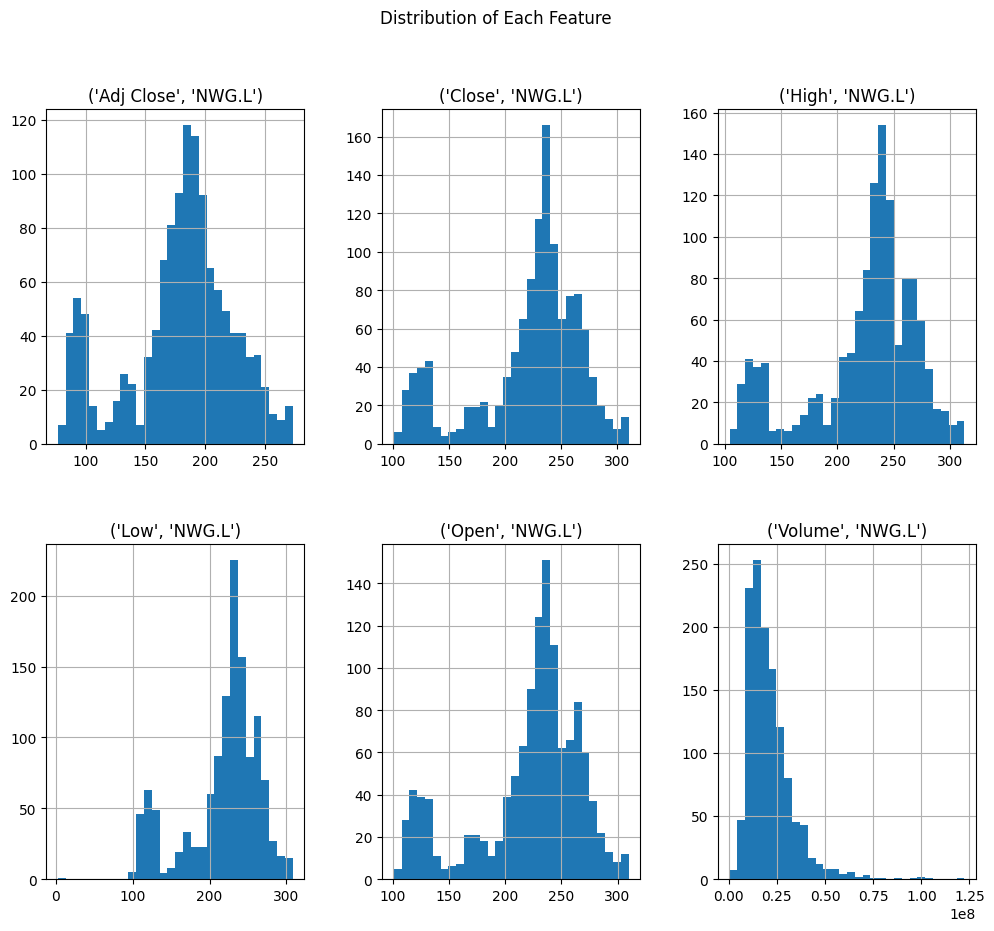

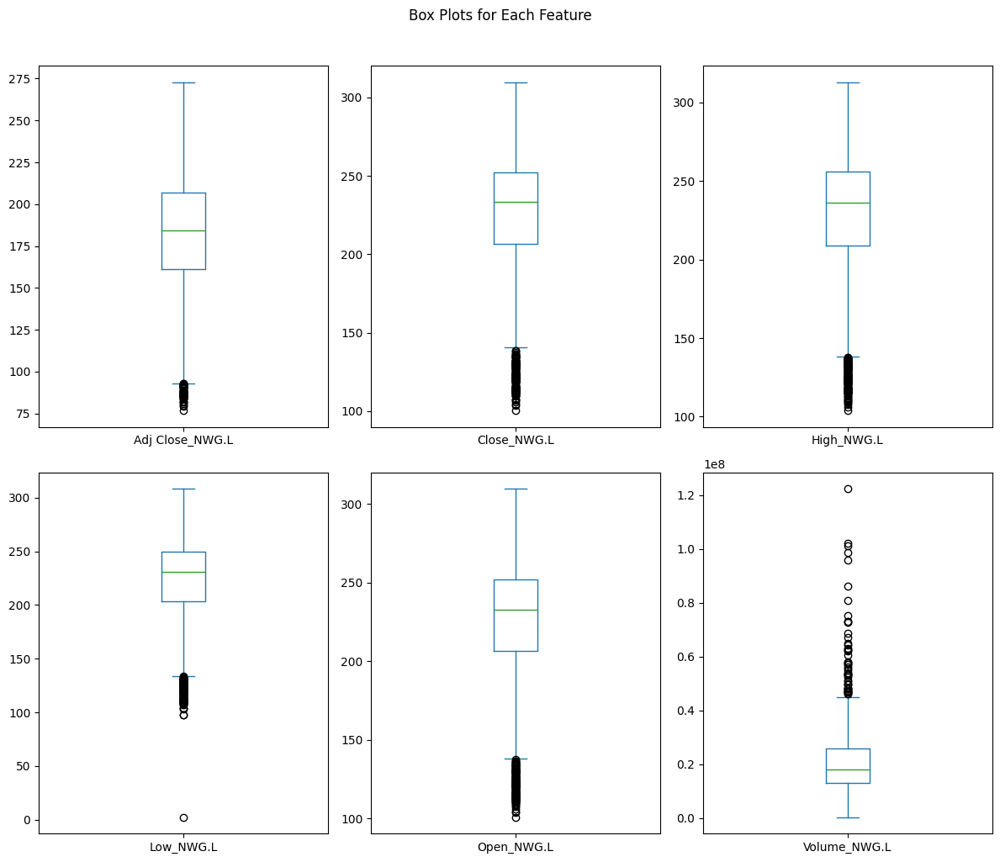

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


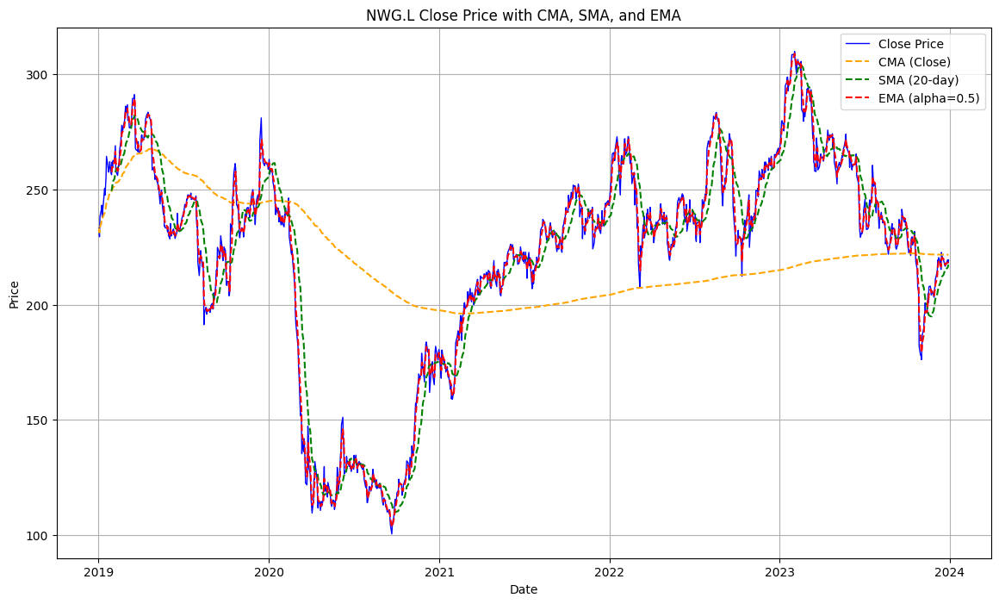

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       8.8080
Mean Absolute Error (MAE):      2.1489
Root Mean Squared Error (RMSE): 2.9678291124420646
Root Square Error (RSE):        0.9963
------------------------------


<ipython-input-43-6ddfd697081f>:37: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


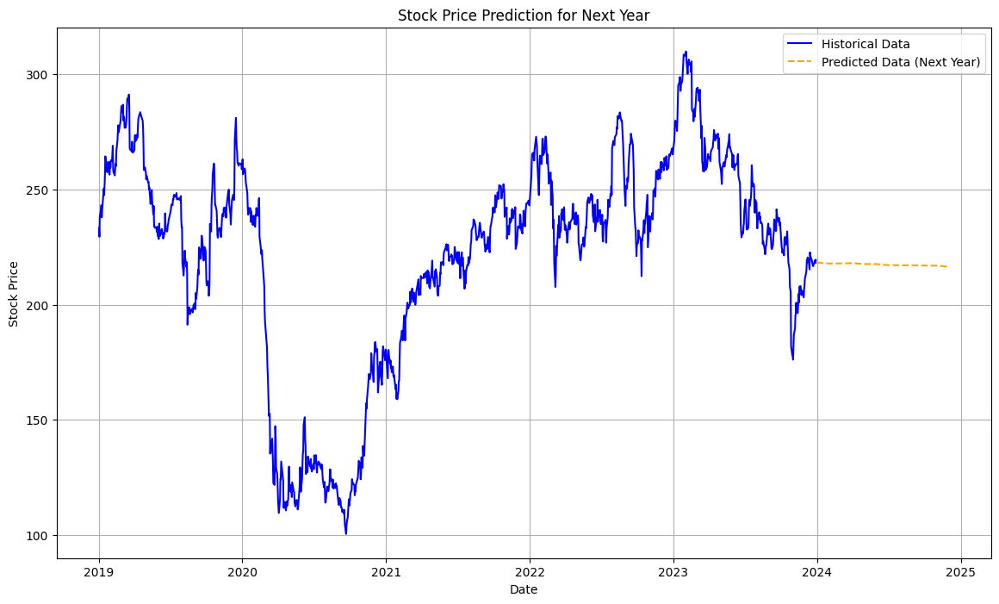

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.52
F1 Score: 0.53
Precision: 0.53
Recall: 0.54
------------------------------------------------------------


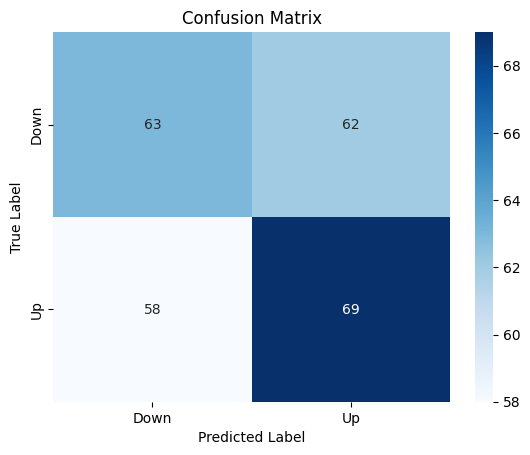

The stock price is predicted to go UP.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


30/30 ━━━━━━━━━━━━━━━━━━━━ 5s 41ms/step - loss: 0.1529
Epoch 2/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0109
Epoch 3/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0070
Epoch 4/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0065
Epoch 5/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0062
Epoch 6/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step - loss: 0.0052
Epoch 7/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0057
Epoch 8/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - loss: 0.0049
Epoch 9/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - loss: 0.0048
Epoch 10/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step - loss: 0.0049
Epoch 11/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0050
Epoch 12/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0054
Epoch 13/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0048
Epoch 14/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0045
Epoch 15/50
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step - loss: 0.0039
Epoch 16/50
30/

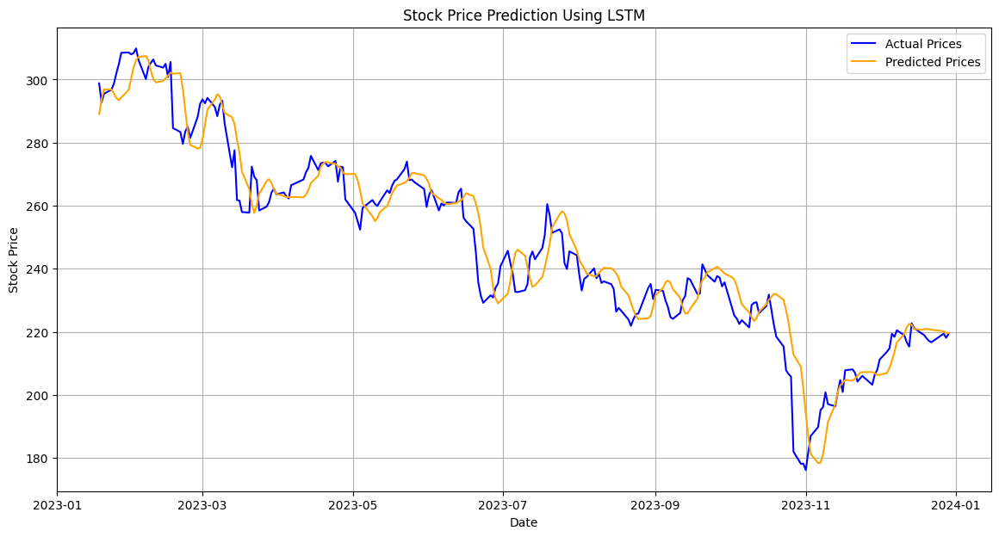

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━

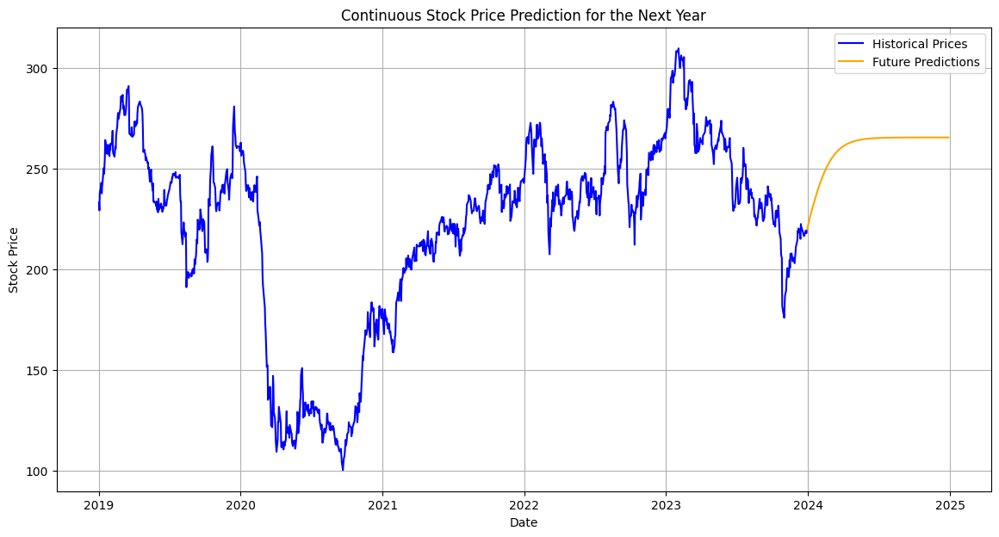

Mean Absolute Error (MAE): 5.142294438680013
Mean Squared Error (MSE): 45.49261542526852
Root Mean Squared Error (RMSE): 6.744821378307102
RSE of the base model: 0.9526187523138833





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


24/24 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - loss: 0.1763
Epoch 2/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0117
Epoch 3/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0085
Epoch 4/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0064
Epoch 5/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - loss: 0.0062
Epoch 6/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0058
Epoch 7/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - loss: 0.0058
Epoch 8/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0059
Epoch 9/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - loss: 0.0056
Epoch 10/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0062
Epoch 11/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0053
Epoch 12/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 0.0053
Epoch 13/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0047
Epoch 14/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0047
Epoch 15/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0048
E

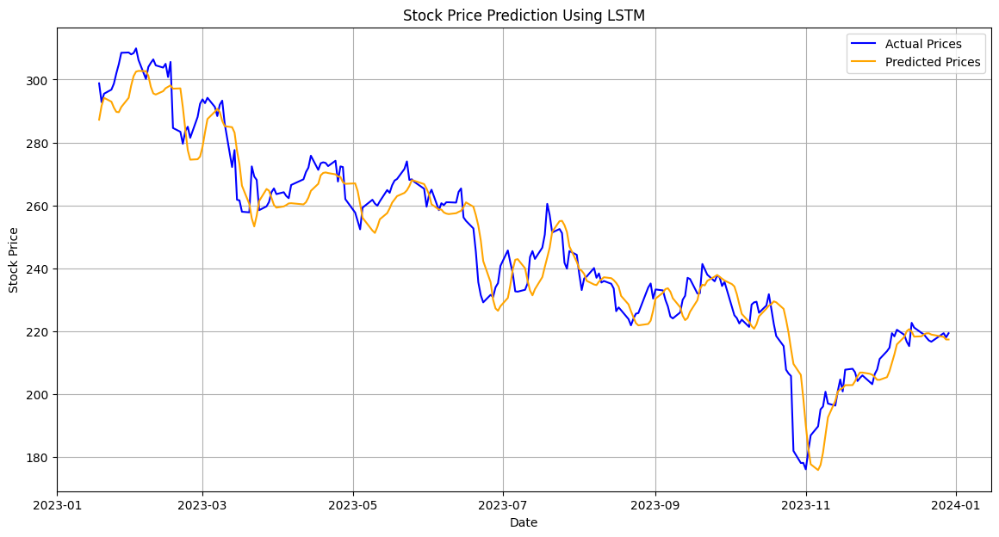

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━

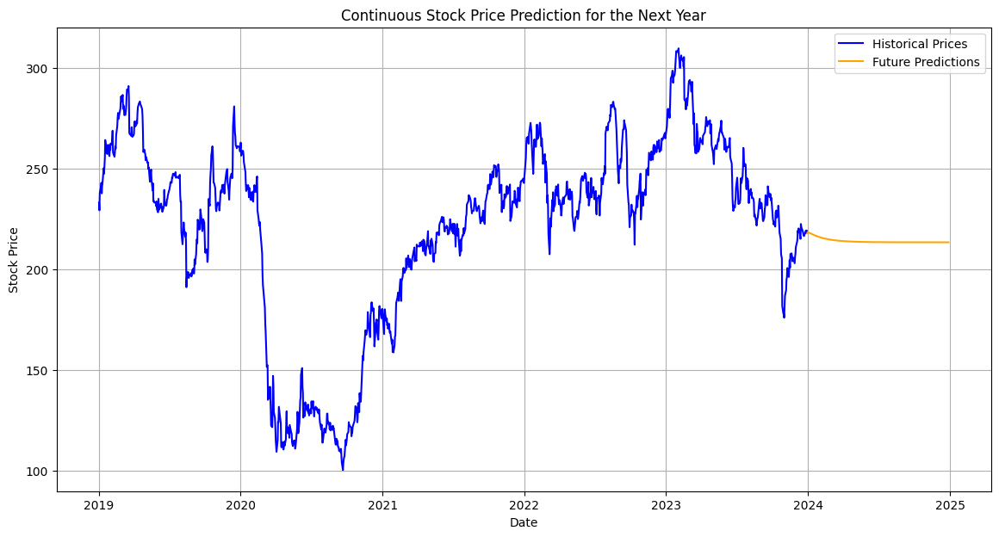

Mean Absolute Error (MAE): 5.240053176879884
Mean Squared Error (MSE): 42.93751165104334
Root Mean Squared Error (RMSE): 6.552672100070576
RSE of the base model: 0.9552799315769038





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


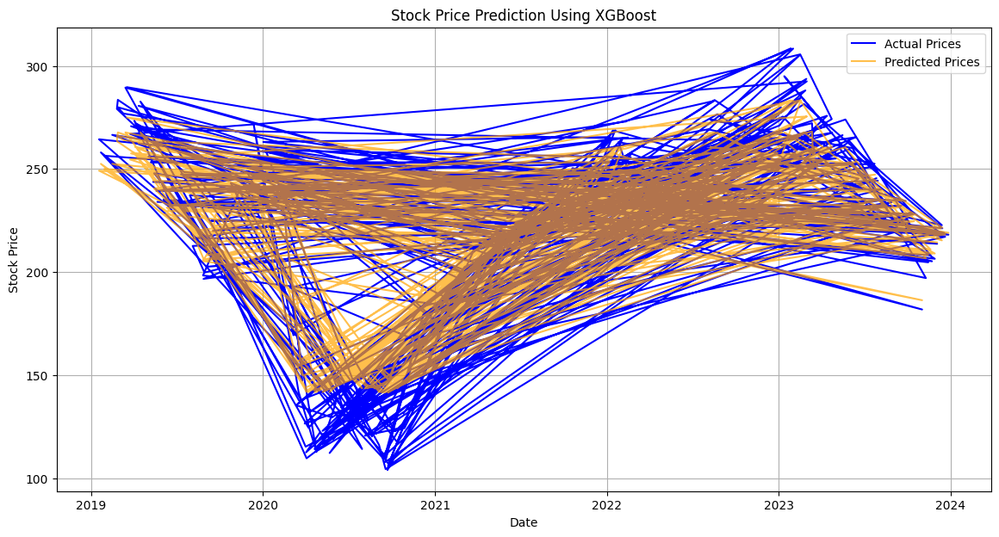

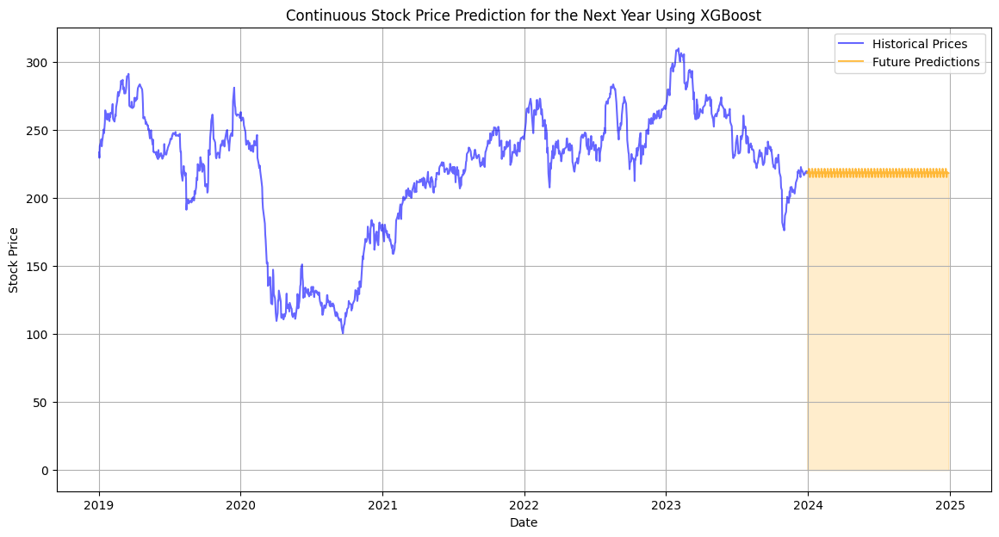




Predicted trend for next year: Down





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-94-9d4aa7df0f0c>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


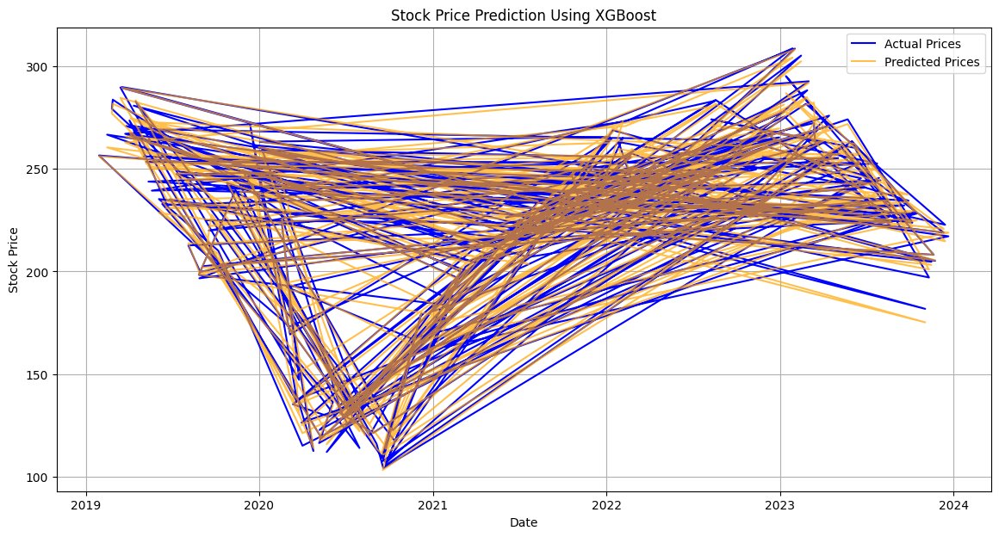

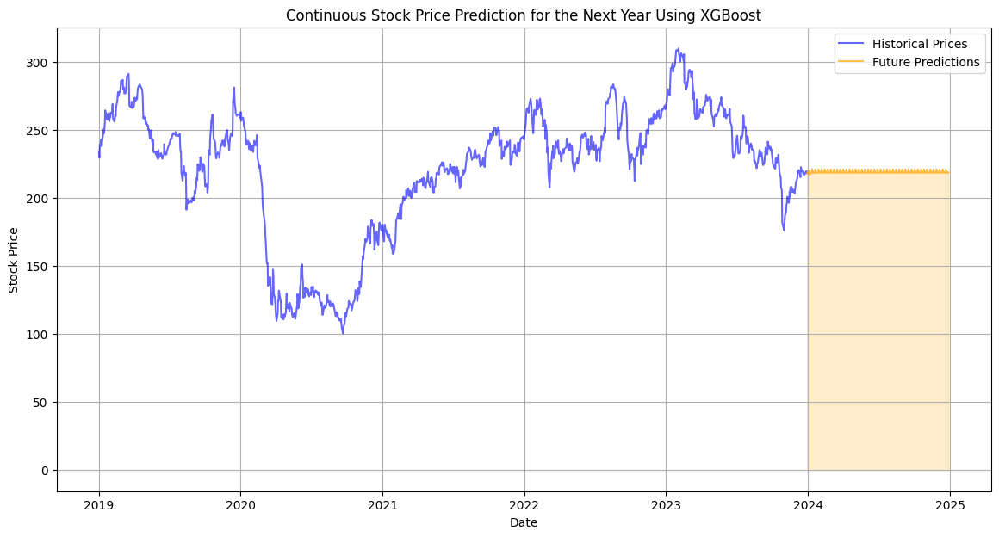




Predicted trend for next year: Up





<ipython-input-94-9d4aa7df0f0c>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM




------------------------------
MSE: 23.10
RMSE: 4.81
MAE: 3.44
R2 Score: 0.99
------------------------------





<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


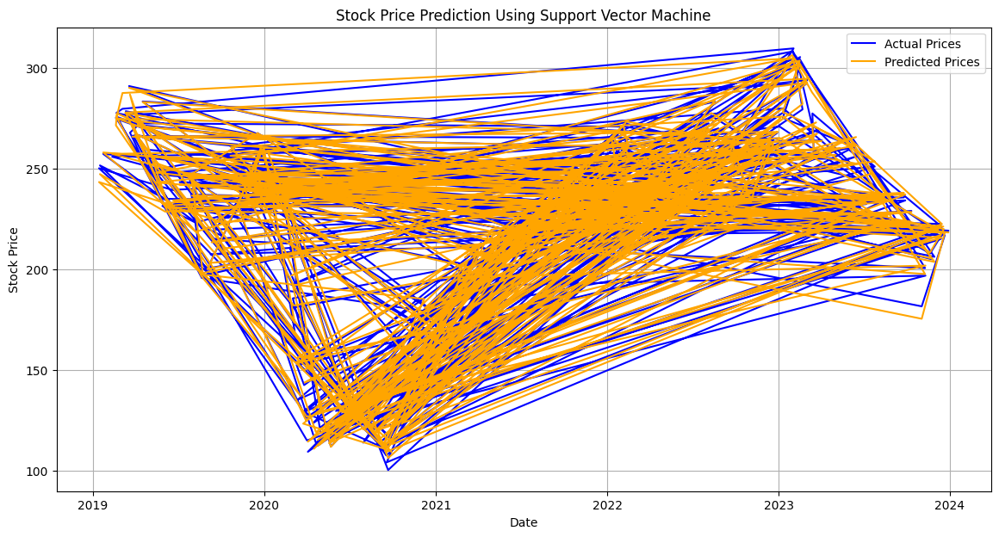

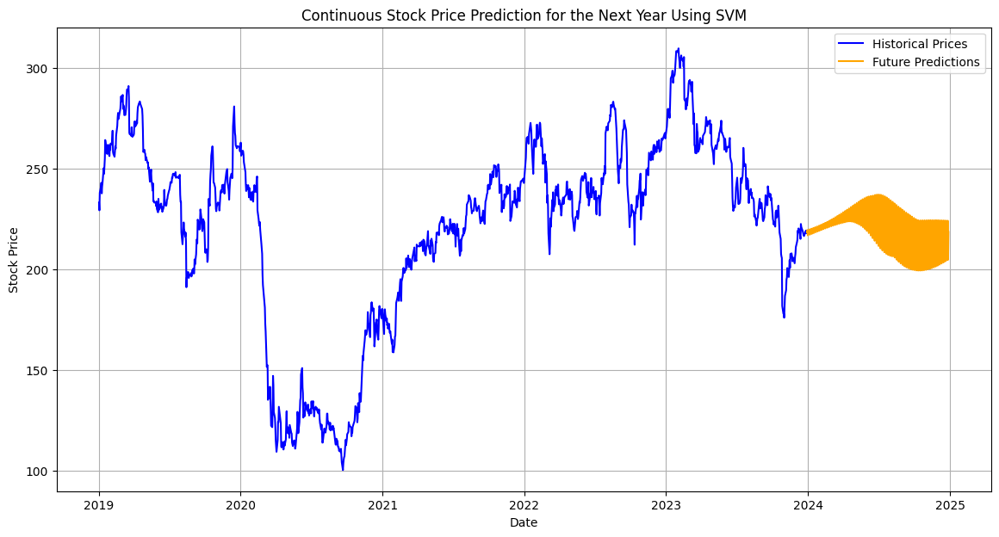

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-116-4ef4e350c863>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 25.42
RMSE: 5.04
MAE: 3.53
R2 Score: 0.99
------------------------------





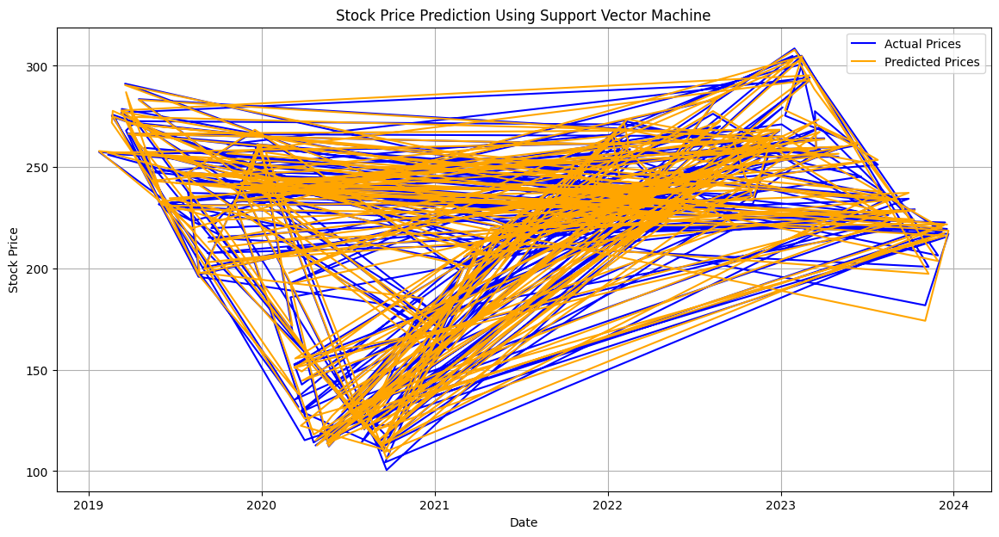

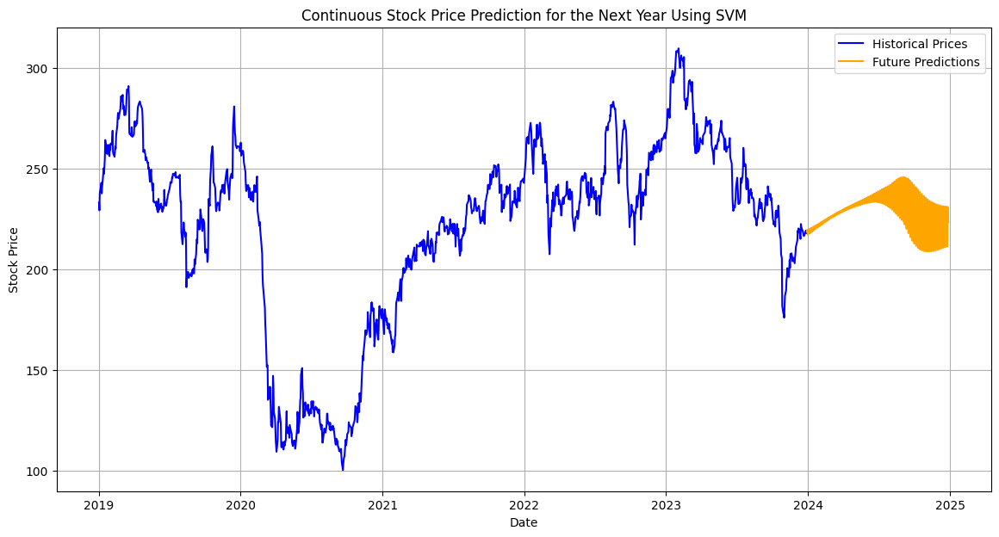

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# ***Training All models for 10 years of Stock Dataset1***

# Standard Chartered (STAN.L)

**Data Loading and preprocessing**

In [ ]:
# Fetching data for Standard Chartered (STAN.L)
ticker = "STAN.L"
data = yf.download(ticker, start="2014-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()

[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,STAN.L,STAN.L,STAN.L,STAN.L,STAN.L,STAN.L
Date,,,,,,
2014-01-02 00:00:00+00:00,953.554871,1282.547852,1300.382690,1273.792358,1292.541748,2978551
2014-01-03 00:00:00+00:00,947.539856,1274.457642,1284.927368,1264.939575,1279.692505,2270614
2014-01-06 00:00:00+00:00,943.647766,1269.222656,1281.596069,1261.608276,1281.596069,2885875
2014-01-07 00:00:00+00:00,943.647766,1269.222656,1276.837158,1254.065308,1268.746826,5546062
2014-01-08 00:00:00+00:00,928.433167,1248.759033,1266.367310,1213.542480,1265.891357,4667685


In [ ]:
print(df.columns)
print(data.columns)

MultiIndex([('Adj Close', 'STAN.L'),
            (    'Close', 'STAN.L'),
            (     'High', 'STAN.L'),
            (      'Low', 'STAN.L'),
            (     'Open', 'STAN.L'),
            (   'Volume', 'STAN.L')],
           names=['Price', 'Ticker'])
MultiIndex([('Adj Close', 'STAN.L'),
            (    'Close', 'STAN.L'),
            (     'High', 'STAN.L'),
            (      'Low', 'STAN.L'),
            (     'Open', 'STAN.L'),
            (   'Volume', 'STAN.L')],
           names=['Price', 'Ticker'])


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())


------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2525 entries, 2014-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (Adj Close, STAN.L)  2525 non-null   float64
 1   (Close, STAN.L)      2525 non-null   float64
 2   (High, STAN.L)       2525 non-null   float64
 3   (Low, STAN.L)        2525 non-null   float64
 4   (Open, STAN.L)       2525 non-null   float64
 5   (Volume, STAN.L)     2525 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 138.1 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker       STAN.L       STAN.L       STAN.L       STAN

**EDA Analysis**

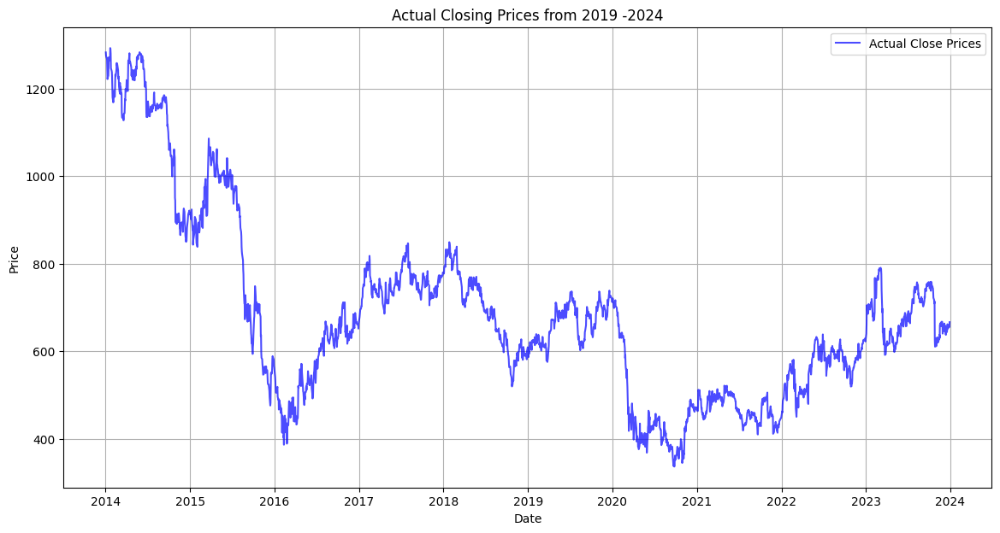

Close column head:
 Date
2014-01-02 00:00:00+00:00    1282.547852
2014-01-03 00:00:00+00:00    1274.457642
2014-01-06 00:00:00+00:00    1269.222656
2014-01-07 00:00:00+00:00    1269.222656
2014-01-08 00:00:00+00:00    1248.759033
Name: (Close, STAN.L), dtype: float64
Statistics for Close column:
 count    2525.000000
mean      682.705332
std       208.965963
min       336.799988
25%       528.000000
50%       651.099976
75%       753.599976
max      1292.541748
Name: (Close, STAN.L), dtype: float64


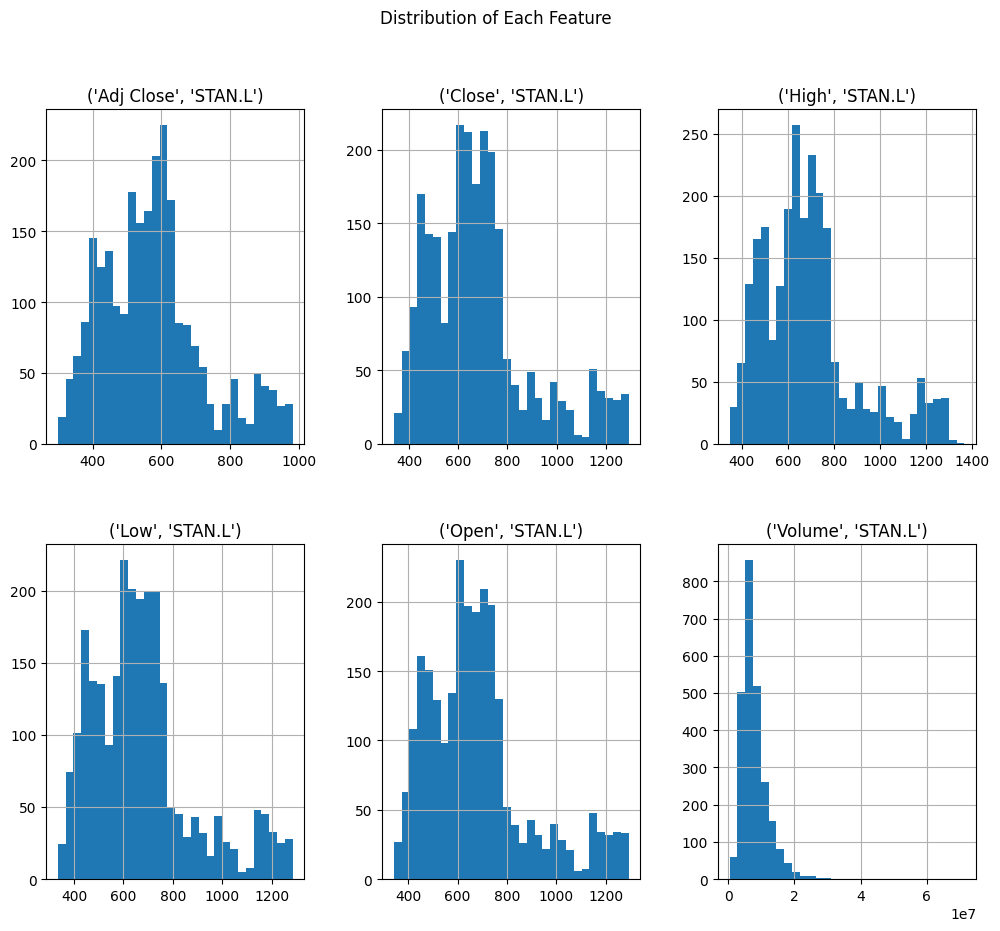

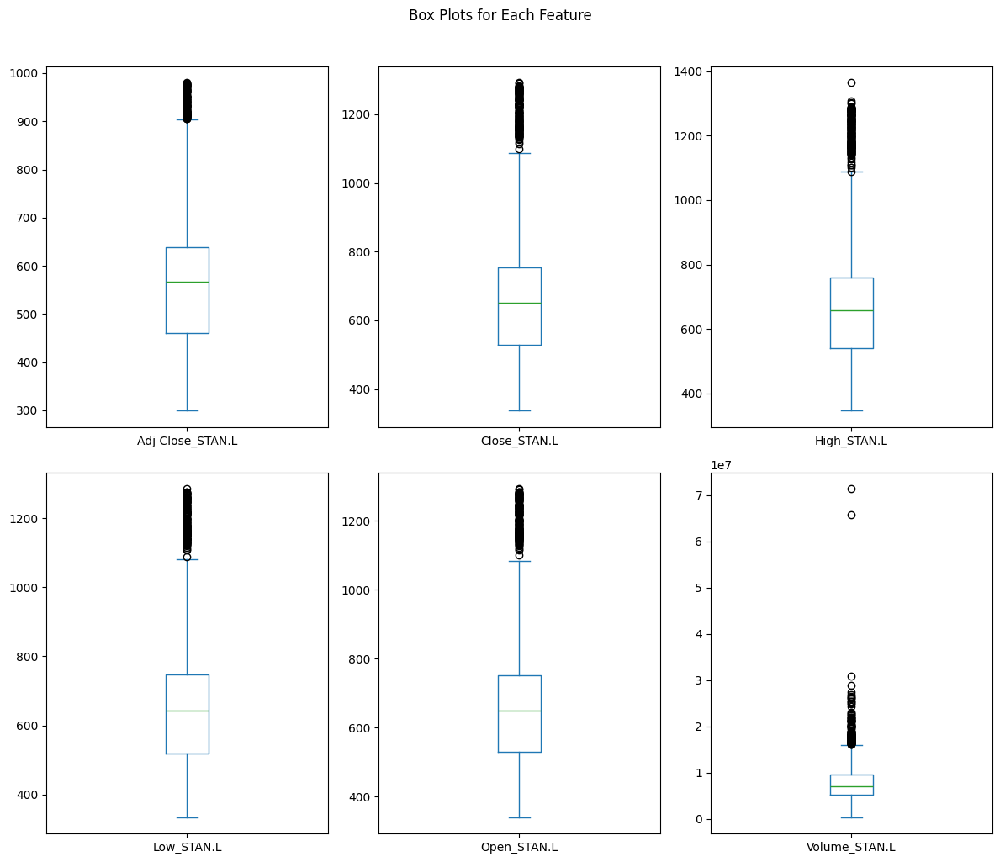

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


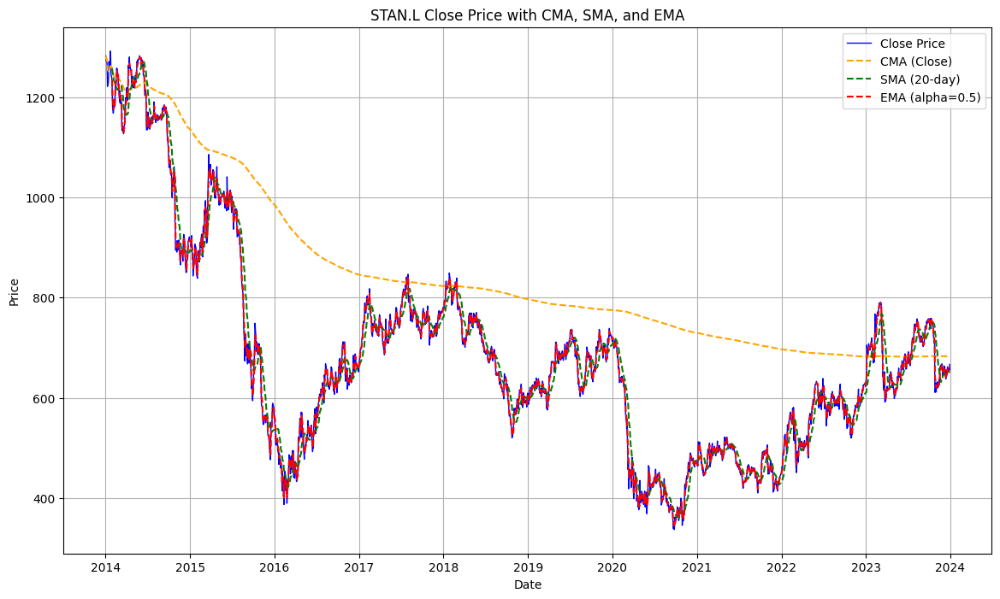

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       67.2207
Mean Absolute Error (MAE):      5.8423
Root Mean Squared Error (RMSE): 8.198824348694652
Root Square Error (RSE):        0.9983
------------------------------


<ipython-input-5-b10075603d89>:43: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


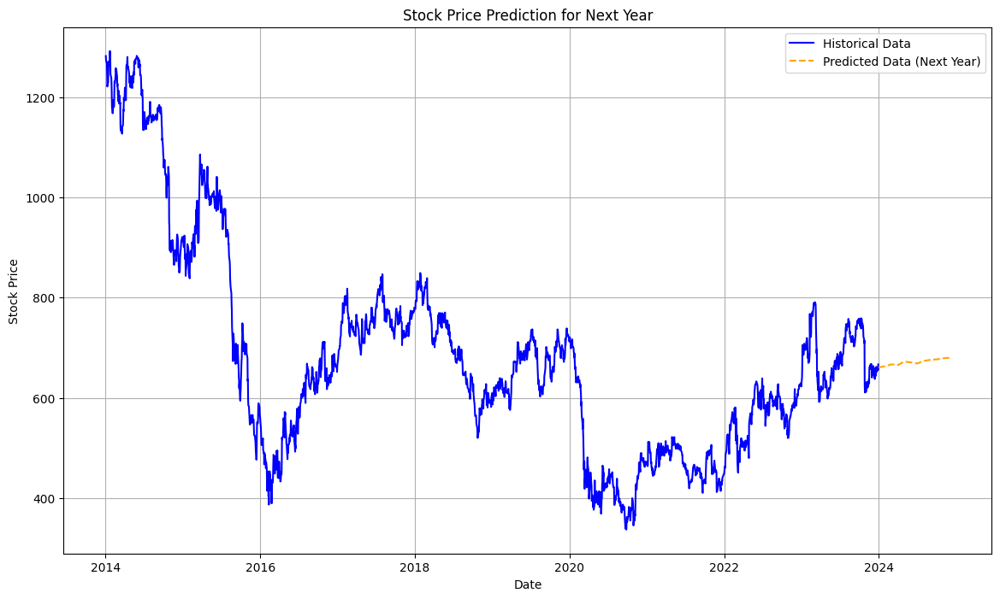

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.55
F1 Score: 0.55
Precision: 0.57
Recall: 0.54
------------------------------------------------------------


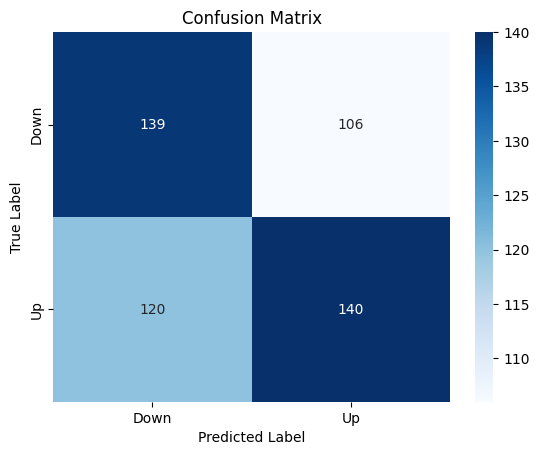

The stock price is predicted to go DOWN.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0772
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0031
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0029
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0027
Epoch 5/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0022
Epoch 6/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0021
Epoch 7/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0024
Epoch 8/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0020
Epoch 9/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0022
Epoch 10/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0020
Epoch 11/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - loss: 0.0018
Epoch 12/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0018
Epoch 13/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0017
Epoch 14/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0017
Epoch 15/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0016
Epoch 16

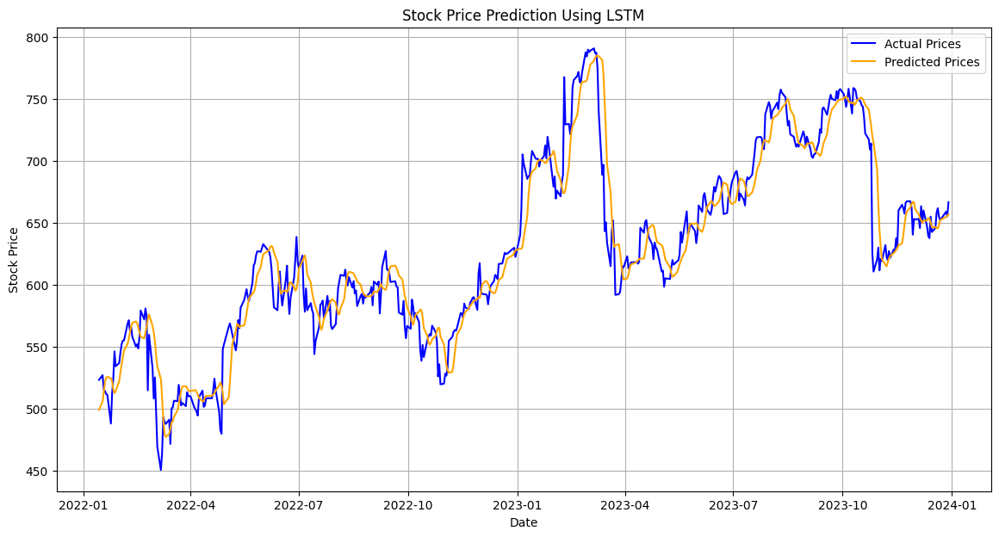

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

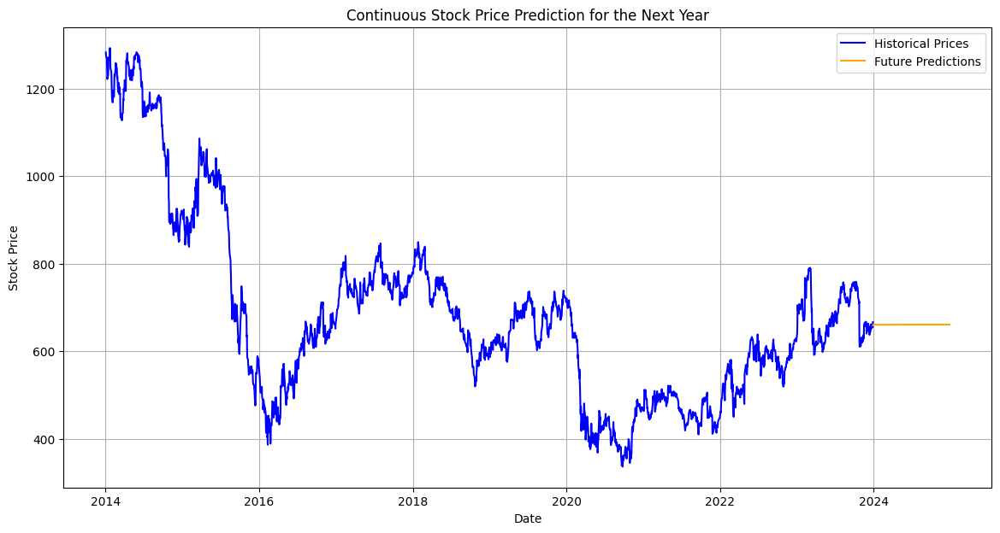

Mean Absolute Error (MAE): 12.95499988114858
Mean Squared Error (MSE): 335.44258208606493
Root Mean Squared Error (RMSE): 18.315091648311917
RSE of the base model: 0.9407577333233135





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0249
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0026
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0026
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0024
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0022
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0021
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0023
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0019
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0021
Epoch 10/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0021
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0019
Epoch 12/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0019
Epoch 13/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0017
Epoch 14/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0017
Epoch 15/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0017
Epoch 16/10

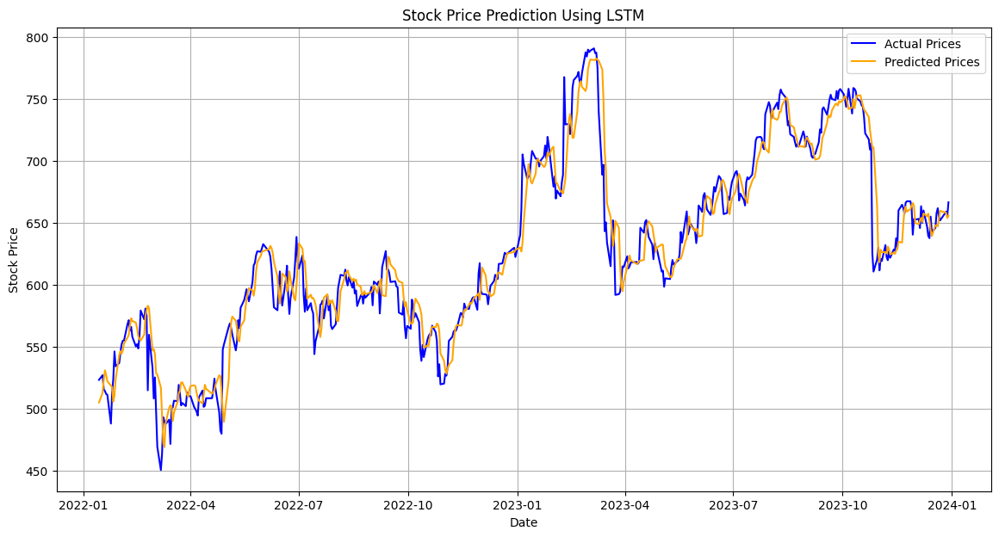

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

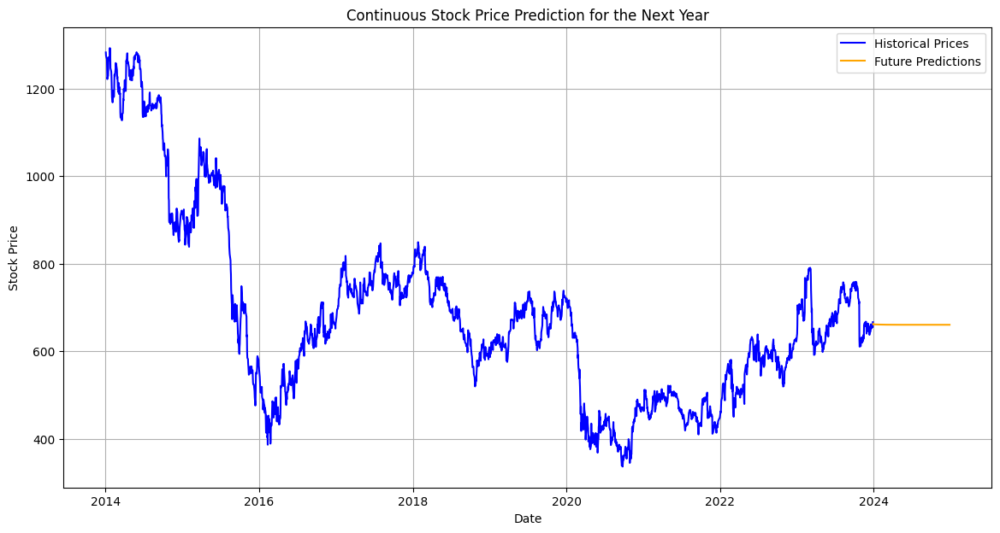

Mean Absolute Error (MAE): 10.307618363633843
Mean Squared Error (MSE): 222.40118695565633
Root Mean Squared Error (RMSE): 14.913121301580576
RSE of the base model: 0.960721890629085





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


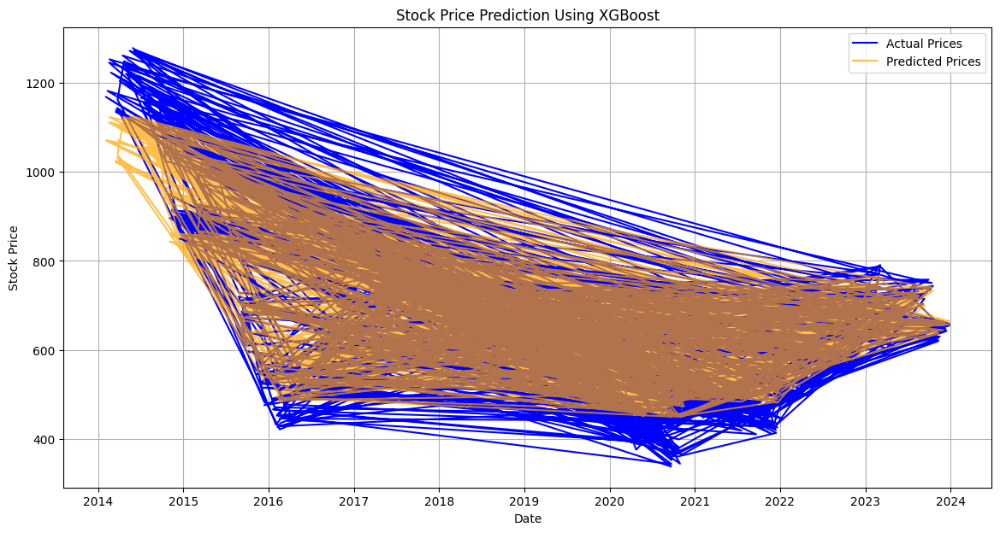

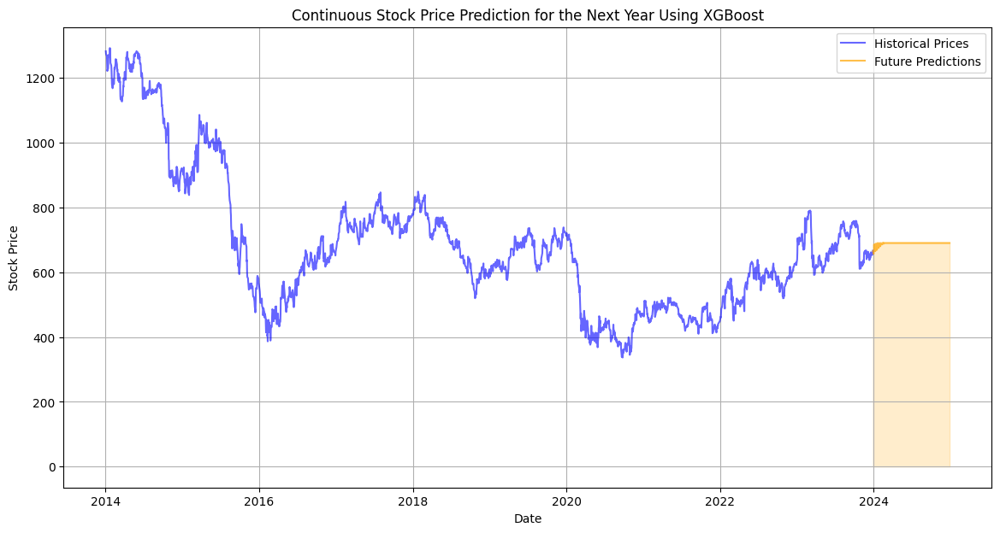




Predicted trend for next year: Down





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


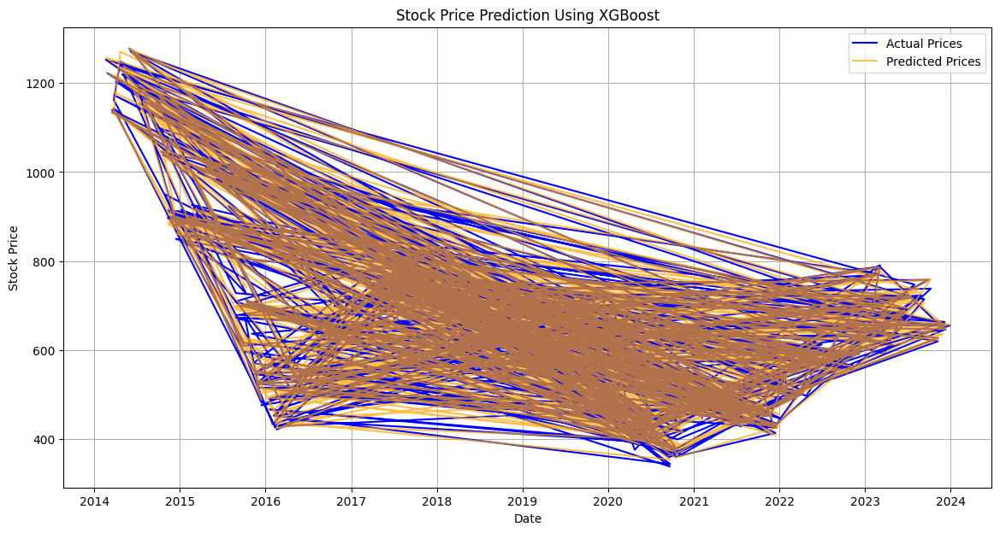

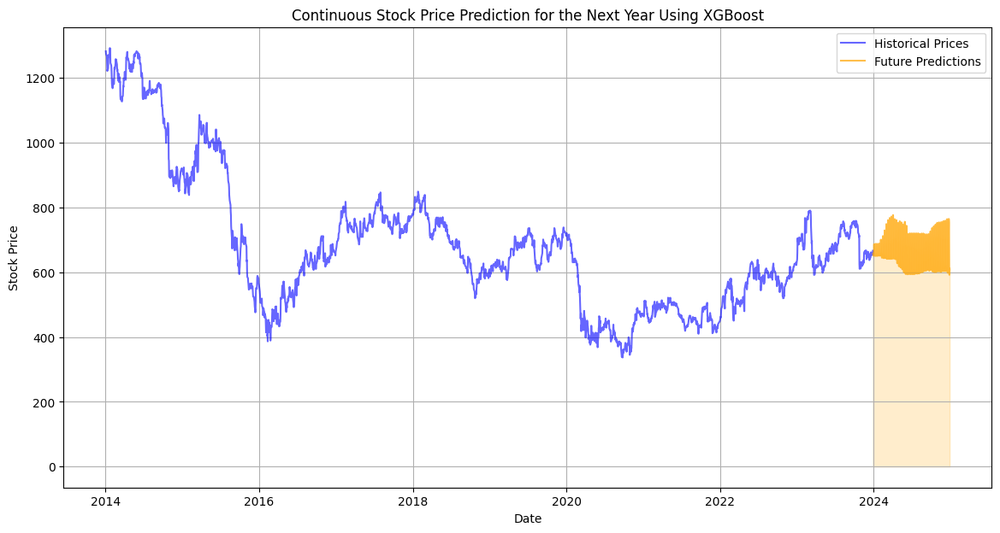




Predicted trend for next year: Up





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 185.31
RMSE: 13.61
MAE: 9.49
R2 Score: 1.00
------------------------------





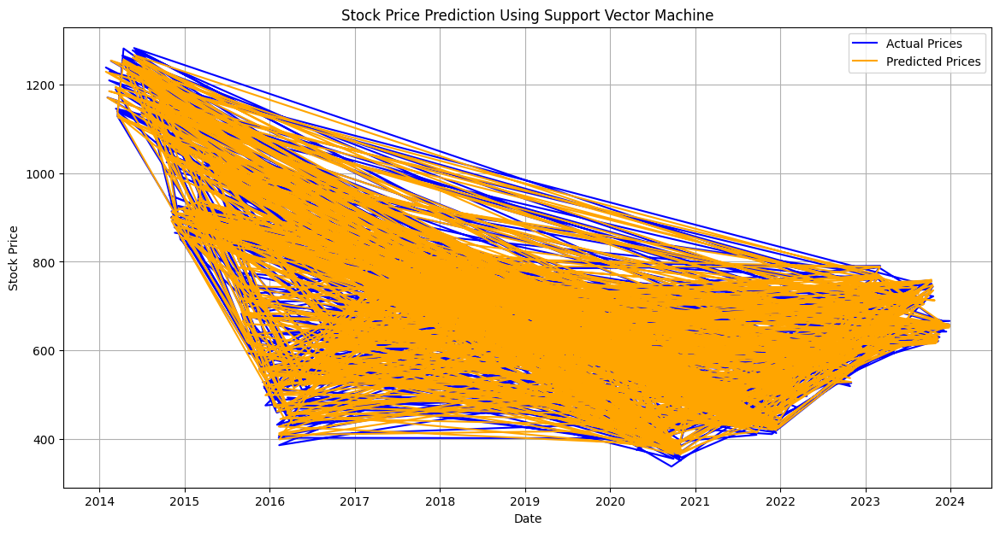

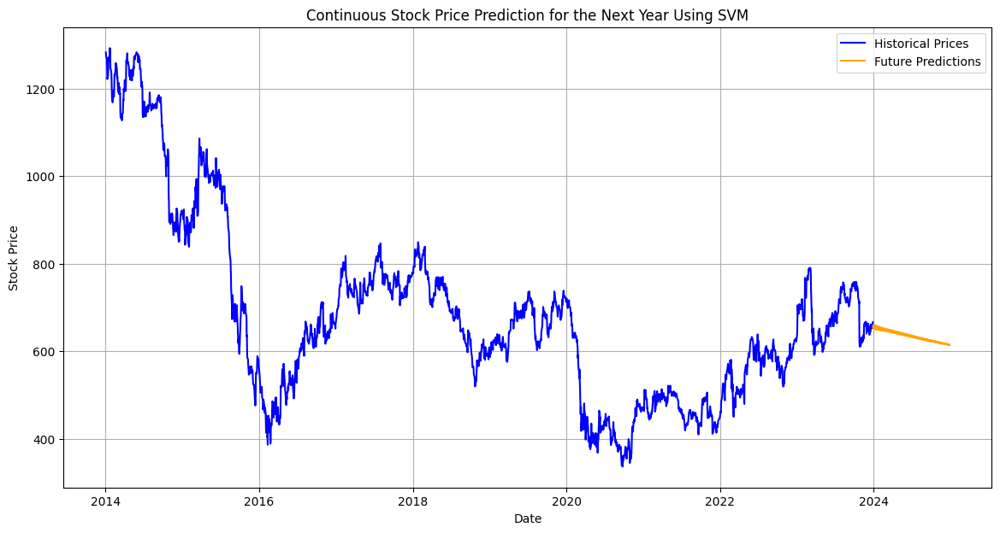

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 166.48
RMSE: 12.90
MAE: 9.20
R2 Score: 1.00
------------------------------





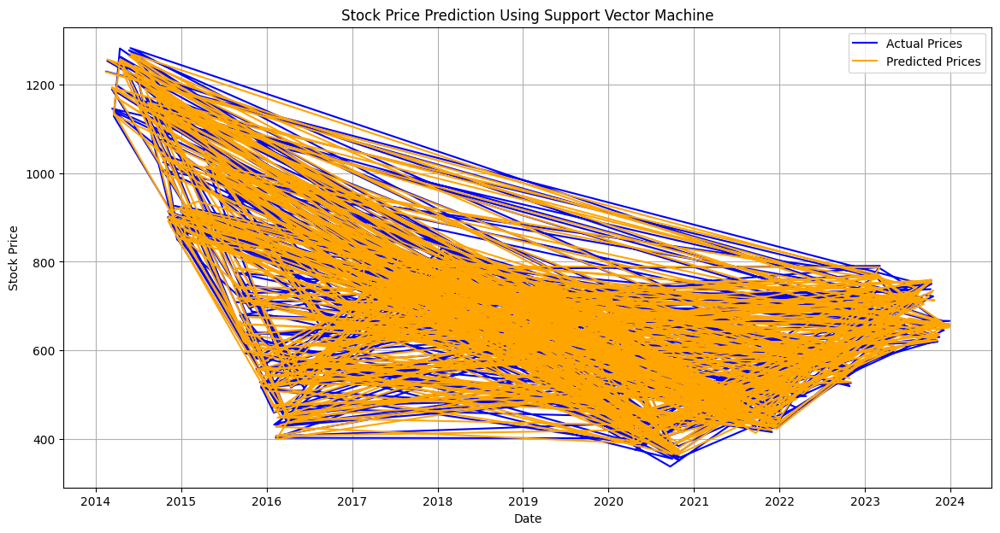

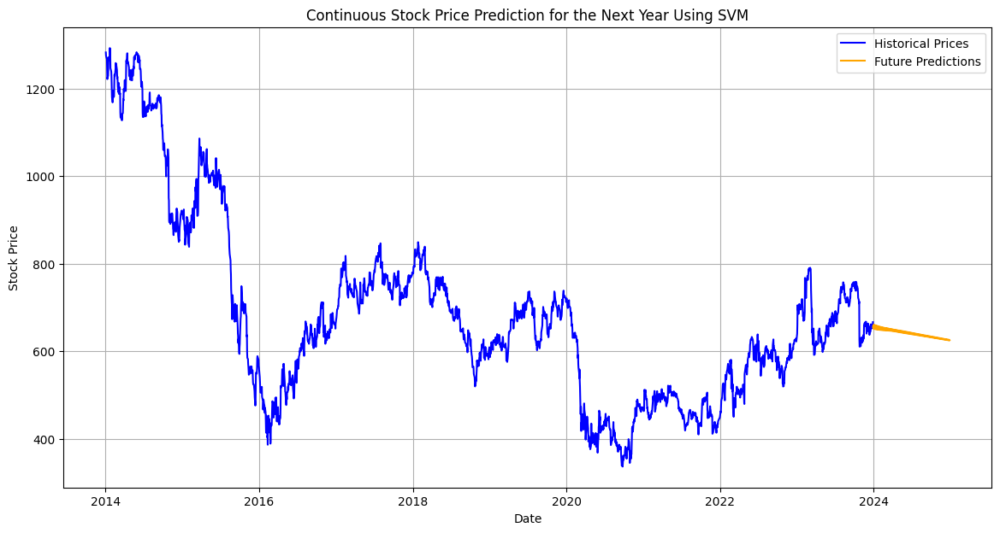

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **Barclays  BARC.L**

In [ ]:
# Fetching data for Barclays  (BARC.L)
ticker = "BARC.L"
data = yf.download(ticker, start="2014-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,BARC.L,BARC.L,BARC.L,BARC.L,BARC.L,BARC.L
Date,,,,,,
2014-01-02 00:00:00+00:00,199.786987,271.049988,274.651001,268.350006,273.000000,30563664
2014-01-03 00:00:00+00:00,201.113770,272.850006,273.910004,270.399994,271.250000,23678963
2014-01-06 00:00:00+00:00,204.541214,277.500000,278.666992,271.200012,271.549988,47008835
2014-01-07 00:00:00+00:00,207.084152,280.950012,282.778015,275.000000,276.950012,44374624
2014-01-08 00:00:00+00:00,209.111099,283.700012,285.899994,281.250000,282.350006,45068534


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2524 entries, 2014-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (Adj Close, BARC.L)  2524 non-null   float64
 1   (Close, BARC.L)      2524 non-null   float64
 2   (High, BARC.L)       2524 non-null   float64
 3   (Low, BARC.L)        2524 non-null   float64
 4   (Open, BARC.L)       2524 non-null   float64
 5   (Volume, BARC.L)     2524 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 138.0 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker       BARC.L       BARC.L       BARC.L       BARC

**EDA Analysis**

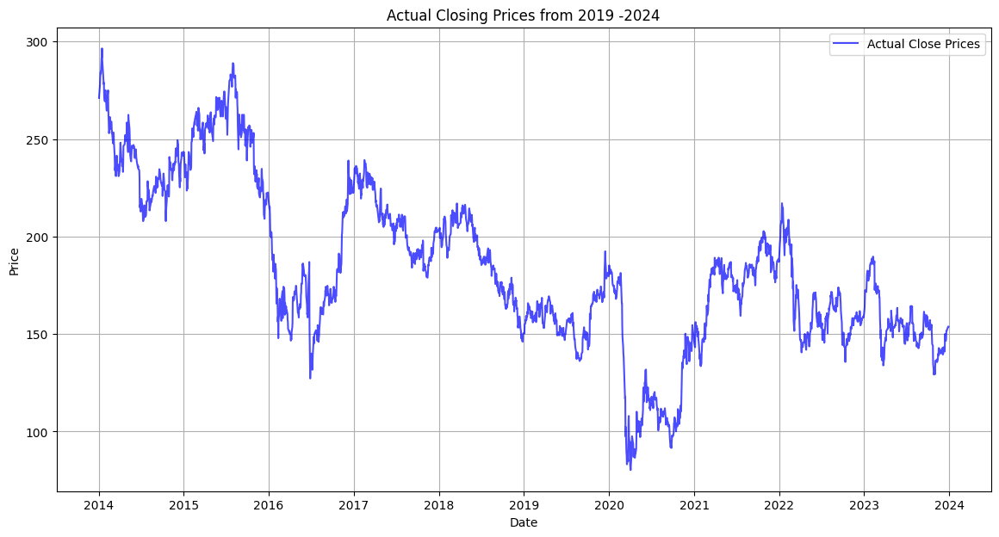

Close column head:
 Date
2014-01-02 00:00:00+00:00    271.049988
2014-01-03 00:00:00+00:00    272.850006
2014-01-06 00:00:00+00:00    277.500000
2014-01-07 00:00:00+00:00    280.950012
2014-01-08 00:00:00+00:00    283.700012
Name: (Close, BARC.L), dtype: float64
Statistics for Close column:
 count    2524.000000
mean      184.087616
std        41.801801
min        80.239998
25%       155.394997
50%       178.065002
75%       211.899994
max       296.500000
Name: (Close, BARC.L), dtype: float64


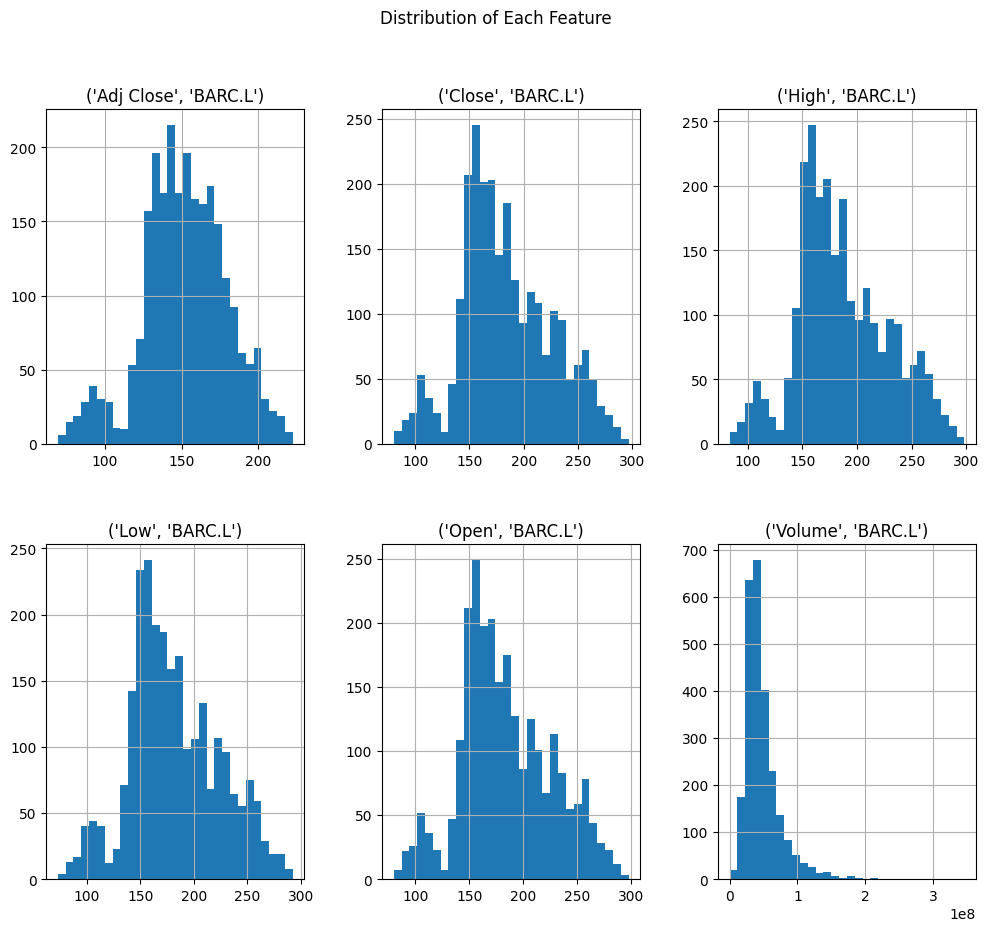

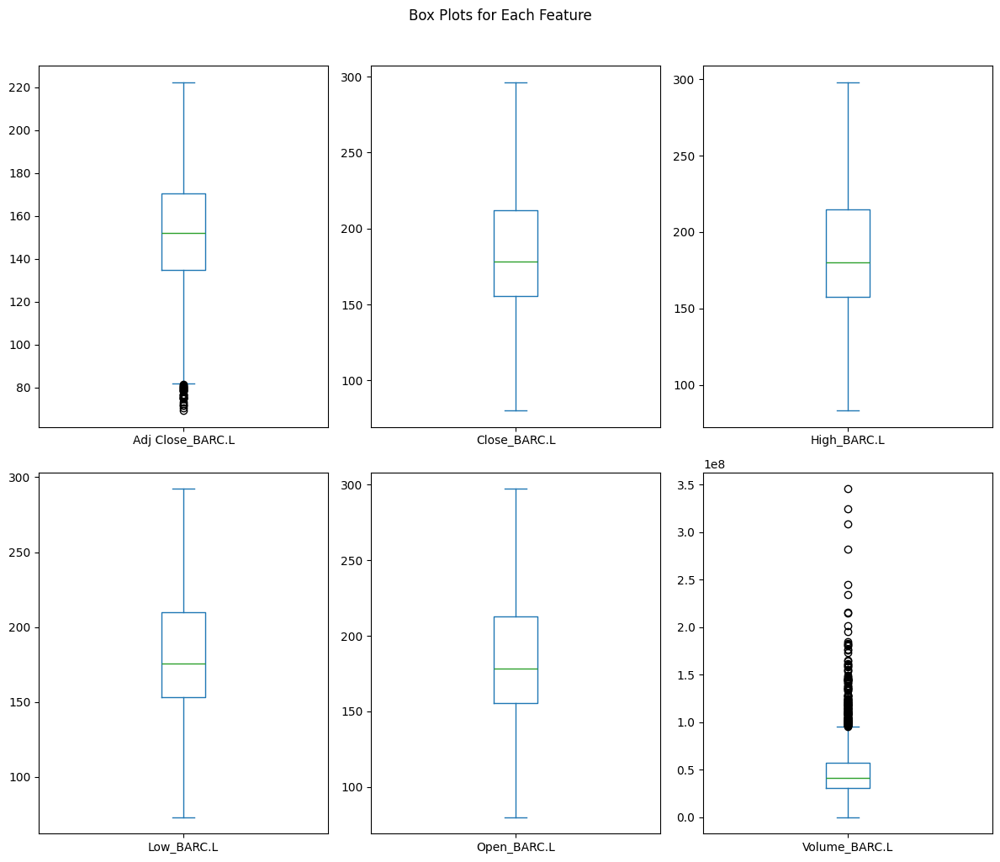

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


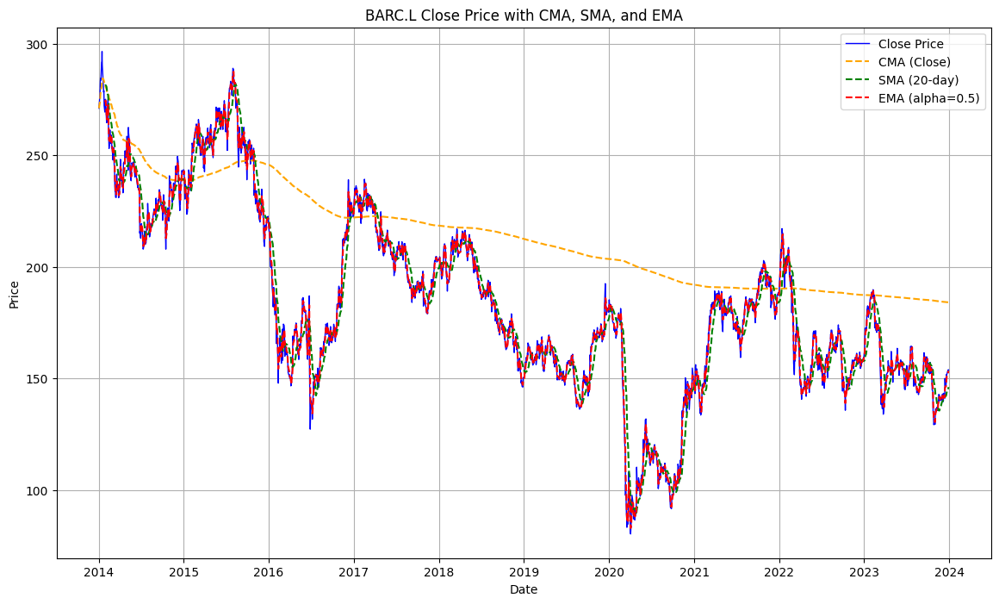

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       4.5161
Mean Absolute Error (MAE):      1.5507
Root Mean Squared Error (RMSE): 2.125112231773177
Root Square Error (RSE):        0.9973
------------------------------


<ipython-input-5-b10075603d89>:43: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


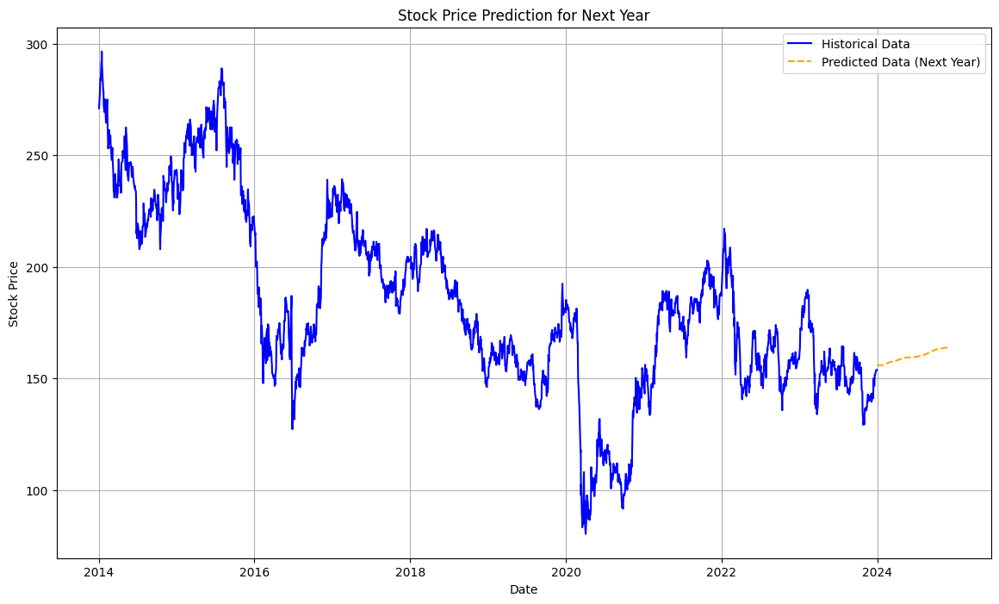

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.51
F1 Score: 0.52
Precision: 0.53
Recall: 0.51
------------------------------------------------------------


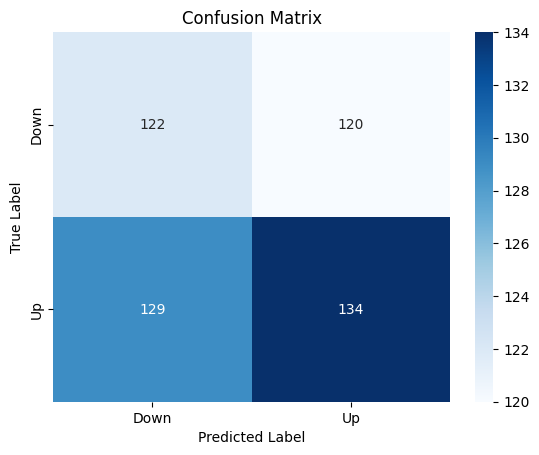

The stock price is predicted to go UP.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


62/62 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0706
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0048
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0038
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0035
Epoch 5/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0036
Epoch 6/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0034
Epoch 7/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0029
Epoch 8/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0030
Epoch 9/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0027
Epoch 10/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0029
Epoch 11/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0026
Epoch 12/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0026
Epoch 13/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0025
Epoch 14/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0028
Epoch 15/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0025
Epoch 16/50
62/62 ━━━━━━━━━

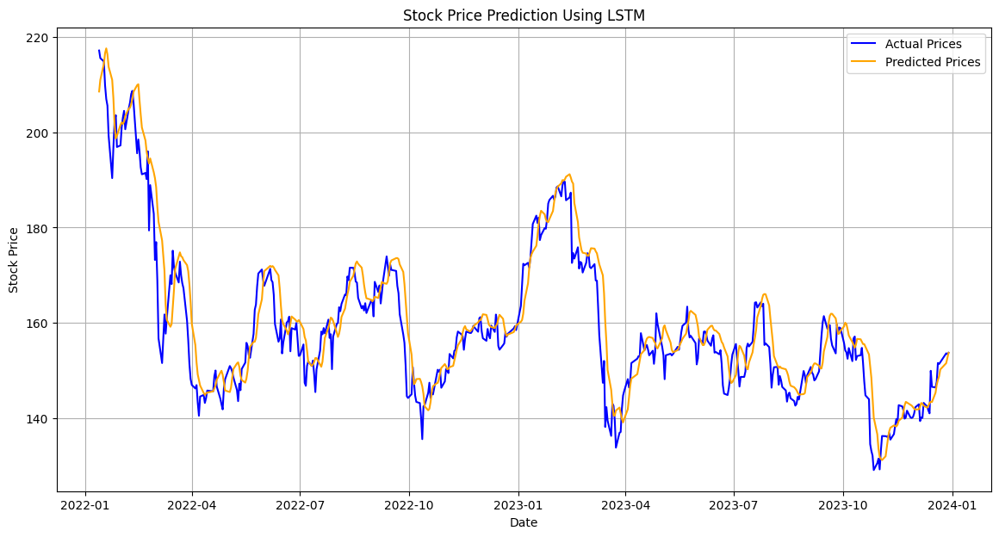

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━

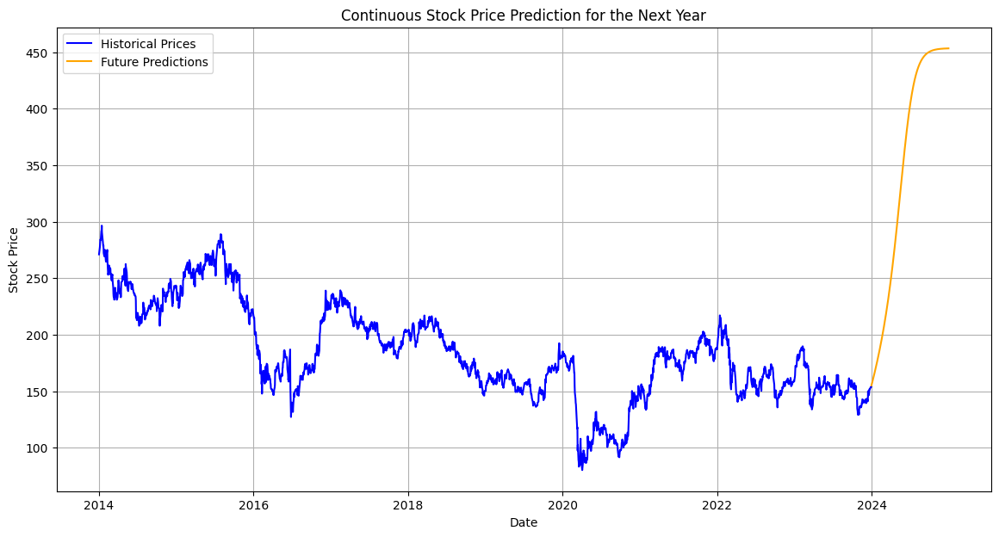

Mean Absolute Error (MAE): 3.581651544474201
Mean Squared Error (MSE): 24.042233561951495
Root Mean Squared Error (RMSE): 4.903288035793073
RSE of the base model: 0.907607557763384





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0818
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0045
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0036
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0036
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0037
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0033
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0035
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0031
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0031
Epoch 10/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0029
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0030
Epoch 12/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0028
Epoch 13/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0026
Epoch 14/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0026
Epoch 15/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0028
Epoch 16/100
50

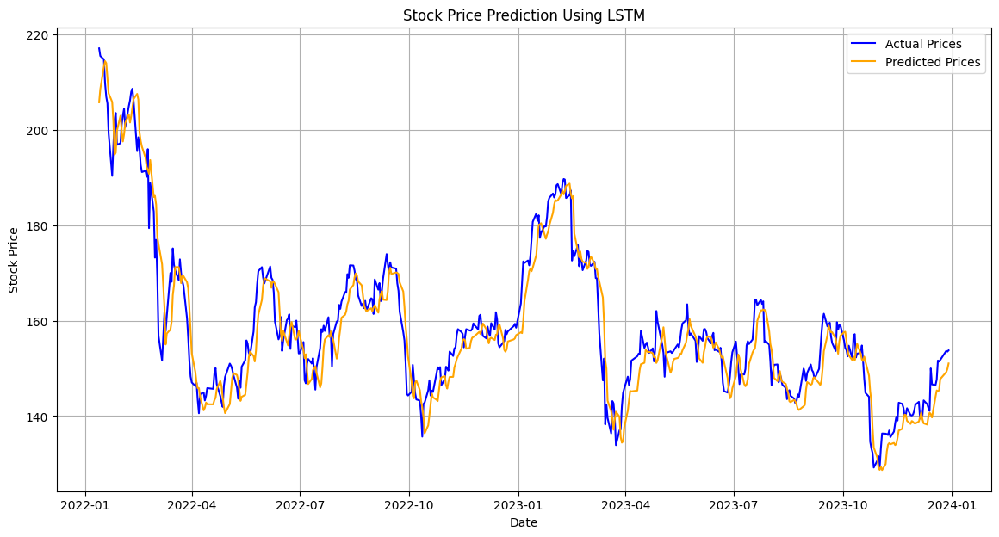

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

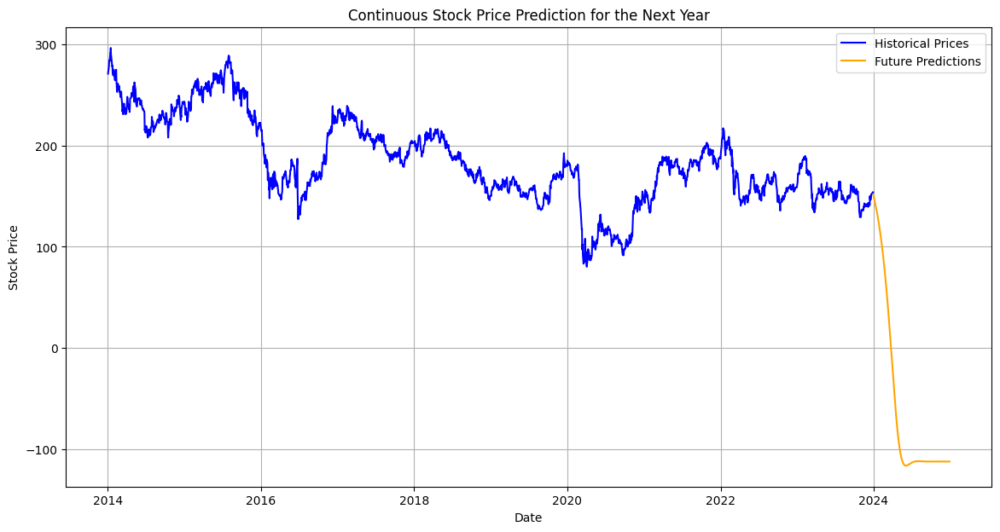

Mean Absolute Error (MAE): 3.0629966070395698
Mean Squared Error (MSE): 15.255249948829741
Root Mean Squared Error (RMSE): 3.9057969671796484
RSE of the base model: 0.9413752555031752





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


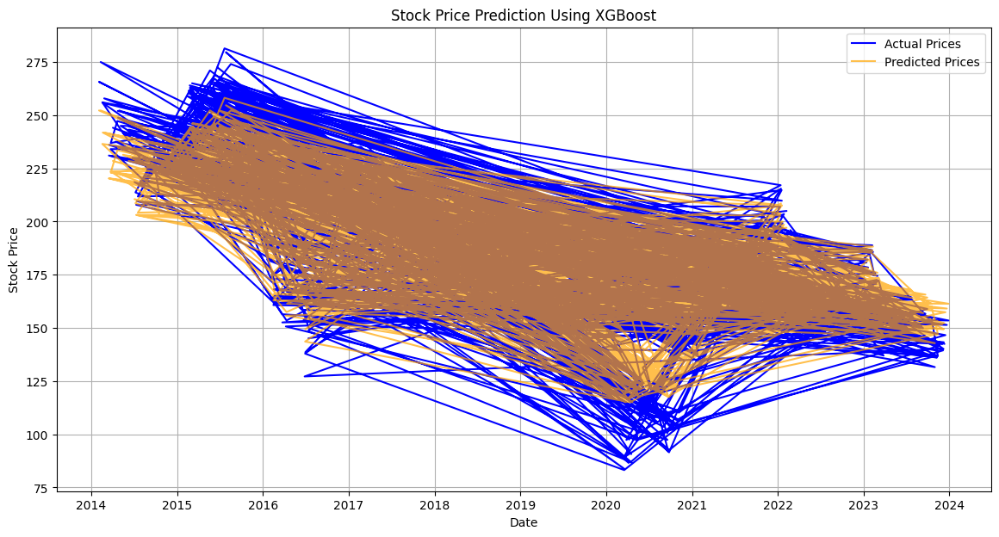

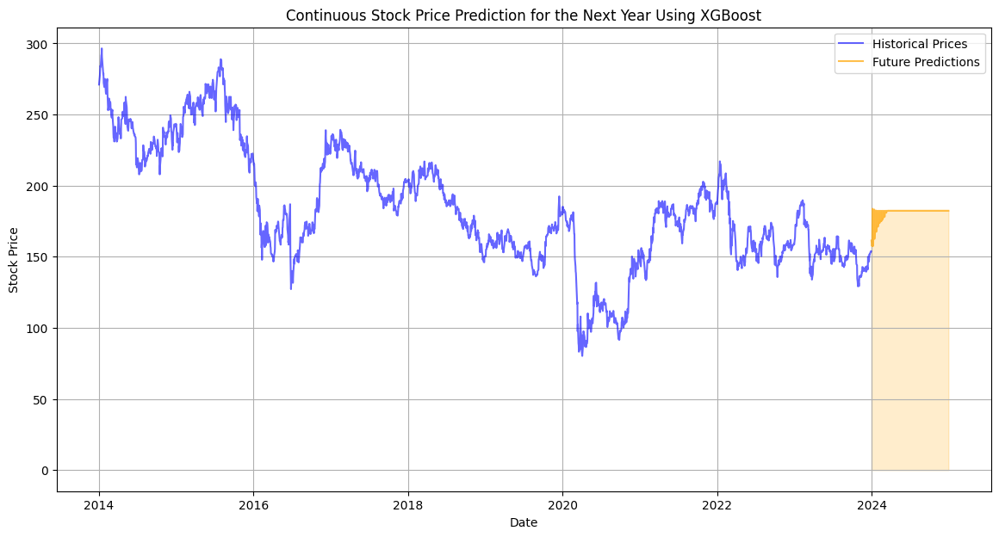




Predicted trend for next year: Down





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


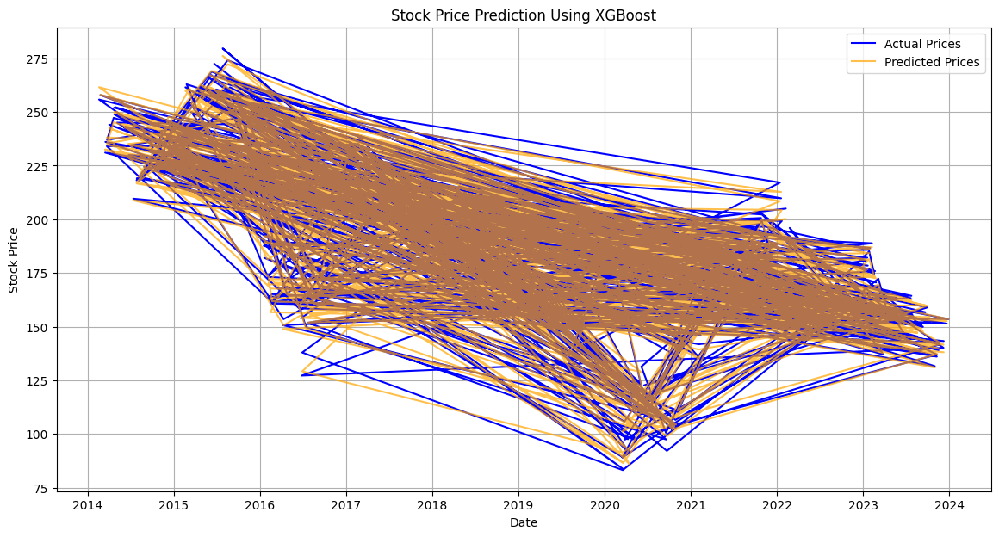

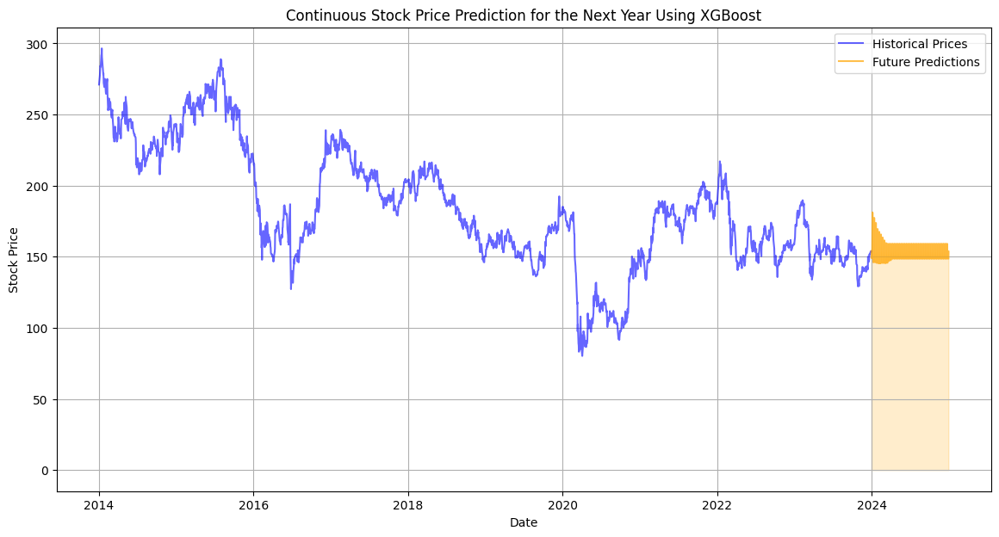




Predicted trend for next year: Up





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 13.79
RMSE: 3.71
MAE: 2.57
R2 Score: 0.99
------------------------------





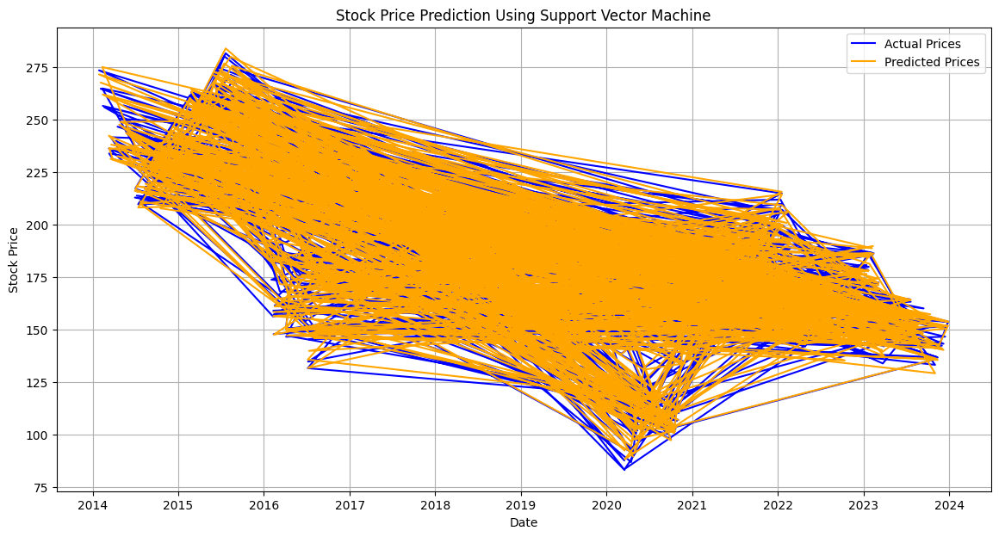

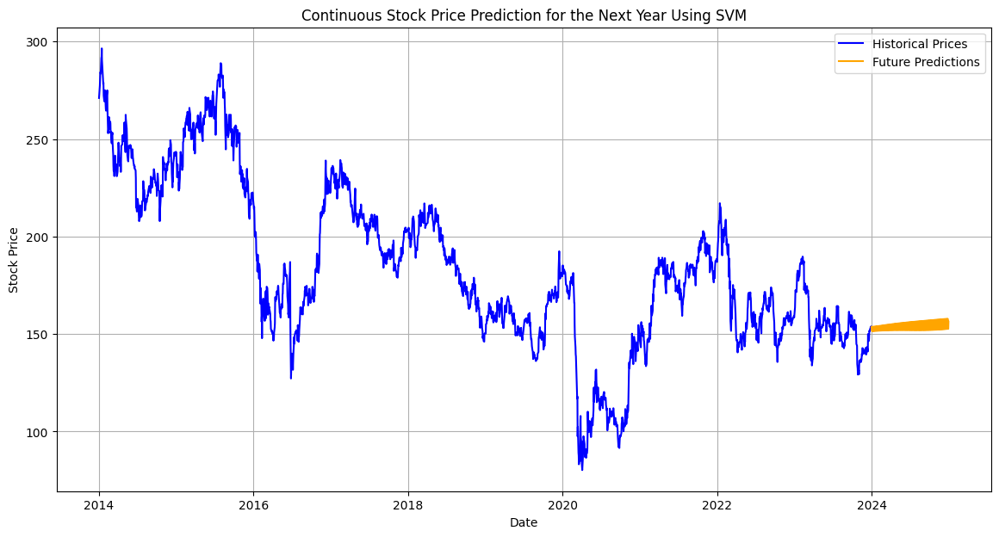

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 15.30
RMSE: 3.91
MAE: 2.68
R2 Score: 0.99
------------------------------





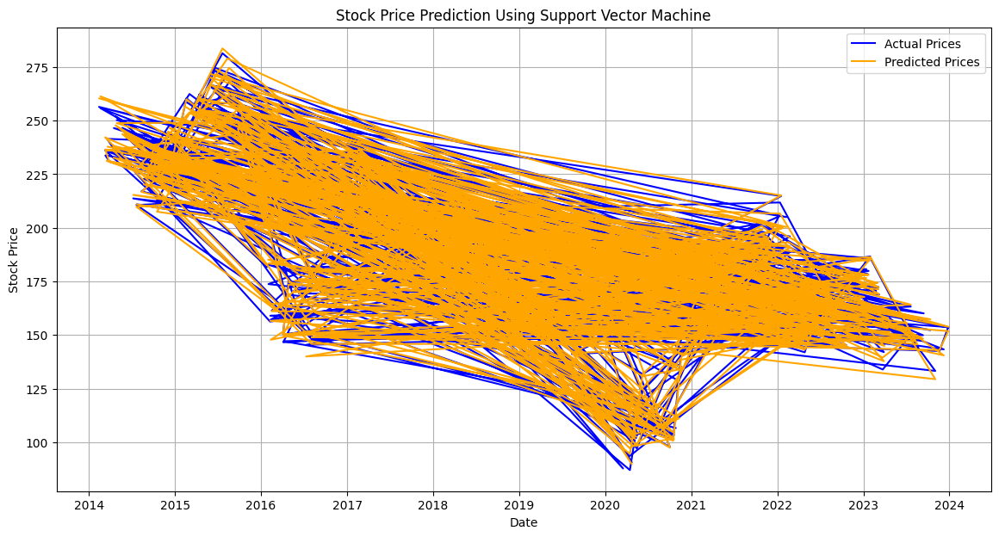

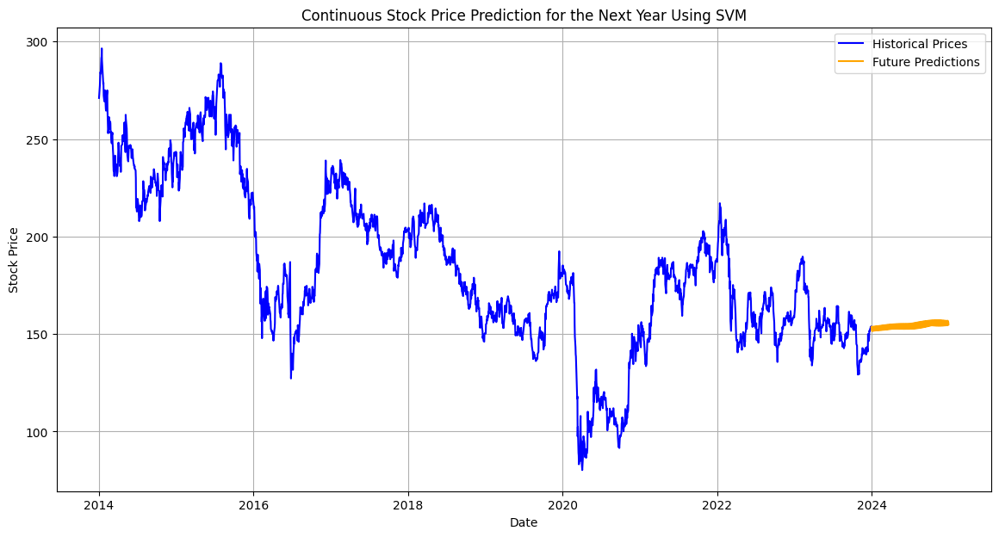

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **Lloyds  LLOY.L**

In [ ]:
# Fetching data for Lloyds  (LLOY.L)
ticker = "LLOY.L"
data = yf.download(ticker, start="2014-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,LLOY.L,LLOY.L,LLOY.L,LLOY.L,LLOY.L,LLOY.L
Date,,,,,,
2014-01-02 00:00:00+00:00,55.683010,79.120003,79.690002,78.459999,79.349998,81748710
2014-01-03 00:00:00+00:00,56.133423,79.760002,80.000000,78.754997,79.139999,62601584
2014-01-06 00:00:00+00:00,56.379749,80.110001,80.459999,79.000000,79.839996,93941867
2014-01-07 00:00:00+00:00,58.068810,82.510002,83.001999,80.114998,80.500000,200497840
2014-01-08 00:00:00+00:00,58.976692,83.800003,84.250000,82.690002,82.940002,165179991


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2523 entries, 2014-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (Adj Close, LLOY.L)  2523 non-null   float64
 1   (Close, LLOY.L)      2523 non-null   float64
 2   (High, LLOY.L)       2523 non-null   float64
 3   (Low, LLOY.L)        2523 non-null   float64
 4   (Open, LLOY.L)       2523 non-null   float64
 5   (Volume, LLOY.L)     2523 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 138.0 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker       LLOY.L       LLOY.L       LLOY.L       LLOY

**EDA Analysis**

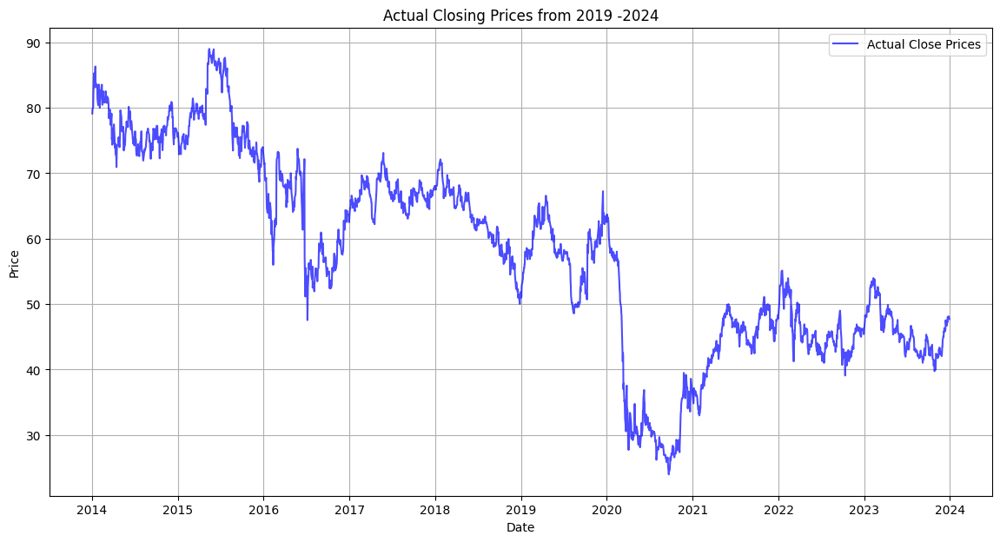

Close column head:
 Date
2014-01-02 00:00:00+00:00    79.120003
2014-01-03 00:00:00+00:00    79.760002
2014-01-06 00:00:00+00:00    80.110001
2014-01-07 00:00:00+00:00    82.510002
2014-01-08 00:00:00+00:00    83.800003
Name: (Close, LLOY.L), dtype: float64
Statistics for Close column:
 count    2523.000000
mean       57.707885
std        14.713818
min        23.980000
25%        45.860001
50%        58.049999
75%        68.609997
max        89.000000
Name: (Close, LLOY.L), dtype: float64


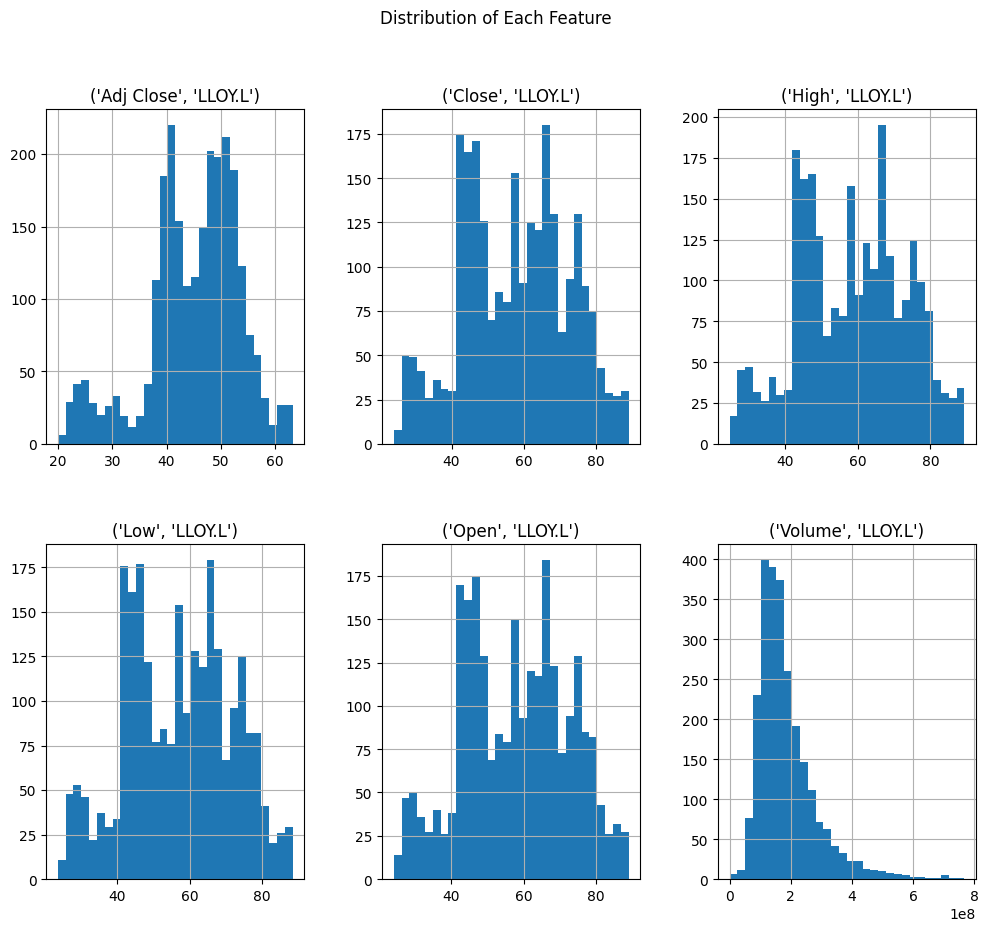

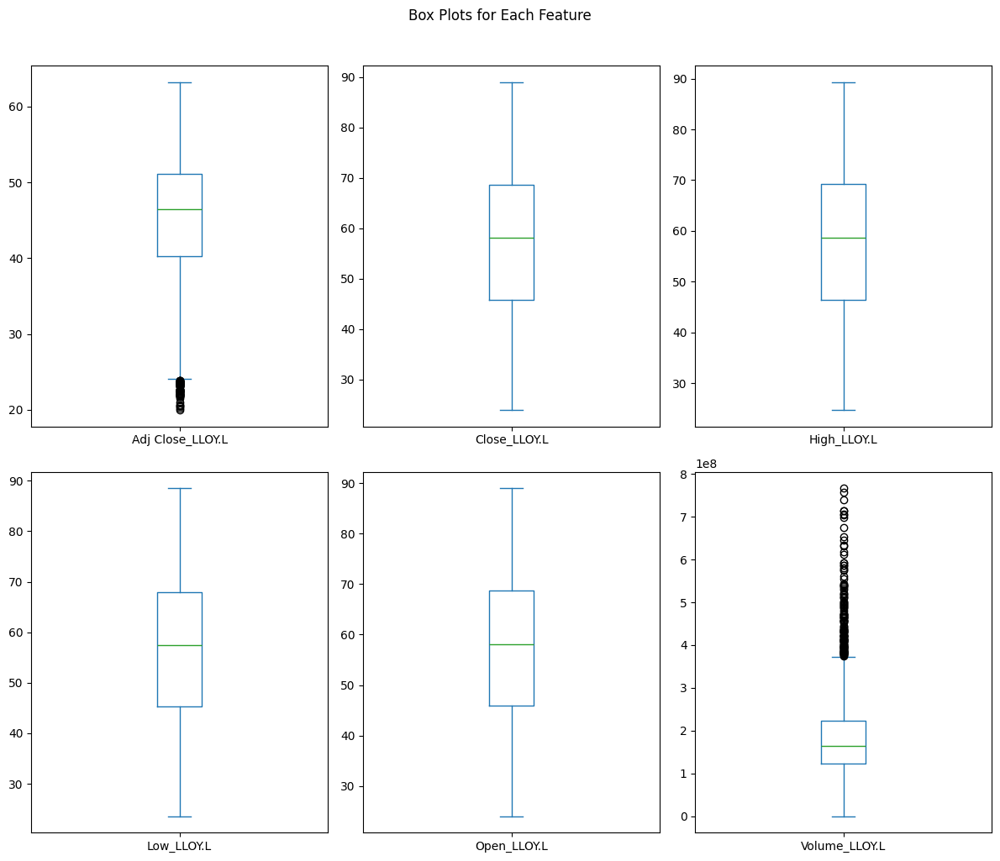

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


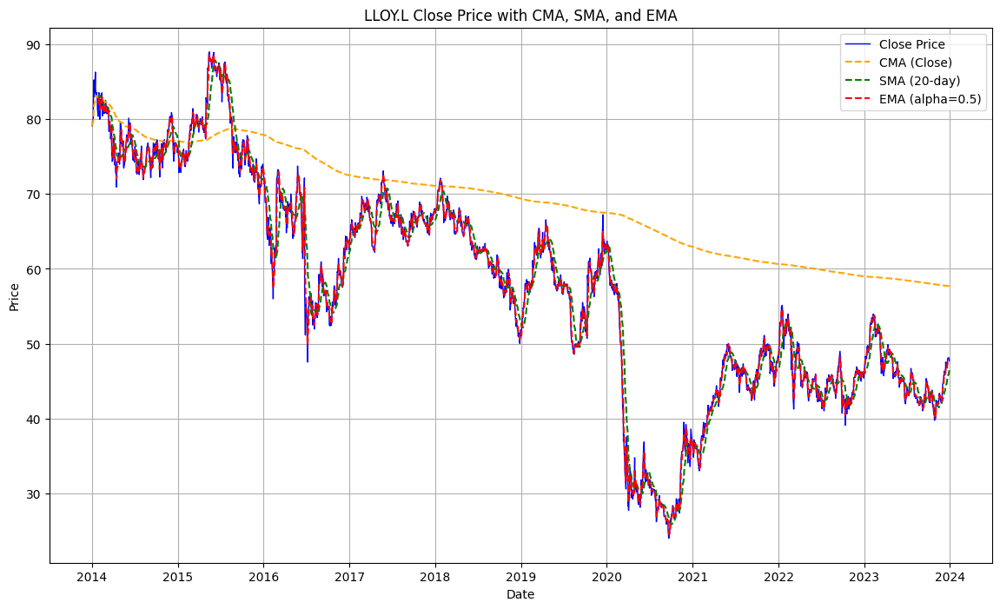

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       0.3554
Mean Absolute Error (MAE):      0.4153
Root Mean Squared Error (RMSE): 0.5961201240555376
Root Square Error (RSE):        0.9983
------------------------------


<ipython-input-5-b10075603d89>:43: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


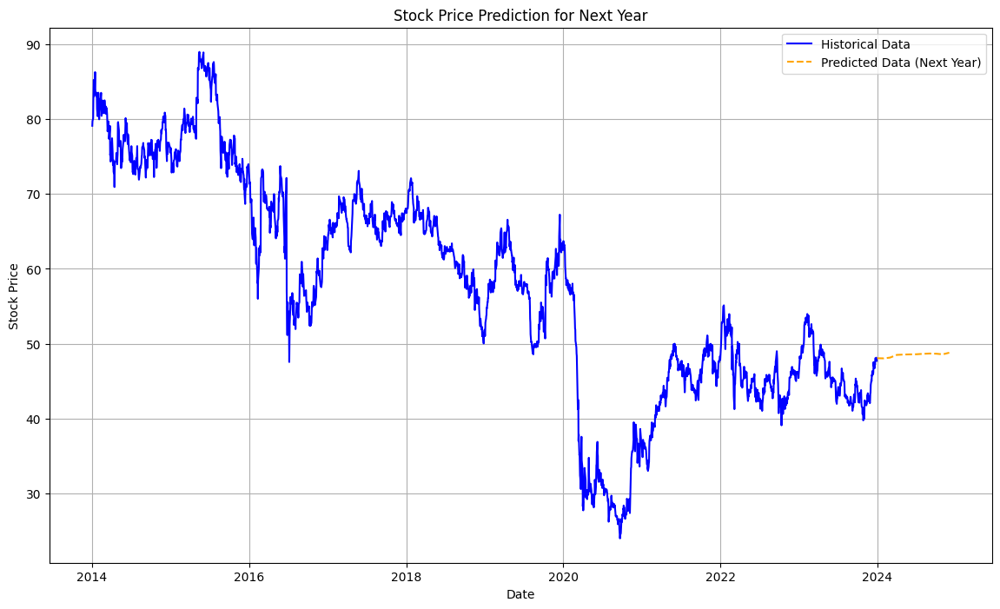

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.54
F1 Score: 0.52
Precision: 0.52
Recall: 0.52
------------------------------------------------------------


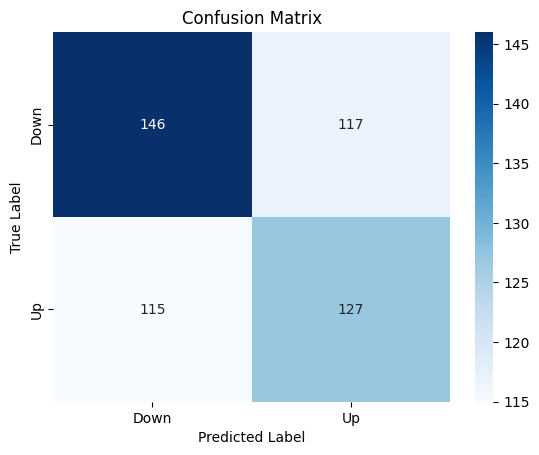

The stock price is predicted to go UP.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


62/62 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0894
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0053
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0042
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0041
Epoch 5/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0037
Epoch 6/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0040
Epoch 7/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0037
Epoch 8/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0039
Epoch 9/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0033
Epoch 10/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0032
Epoch 11/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0031
Epoch 12/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0030
Epoch 13/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0029
Epoch 14/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0033
Epoch 15/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0030
Epoch 16/50
62/62 ━━━━━━━━━━

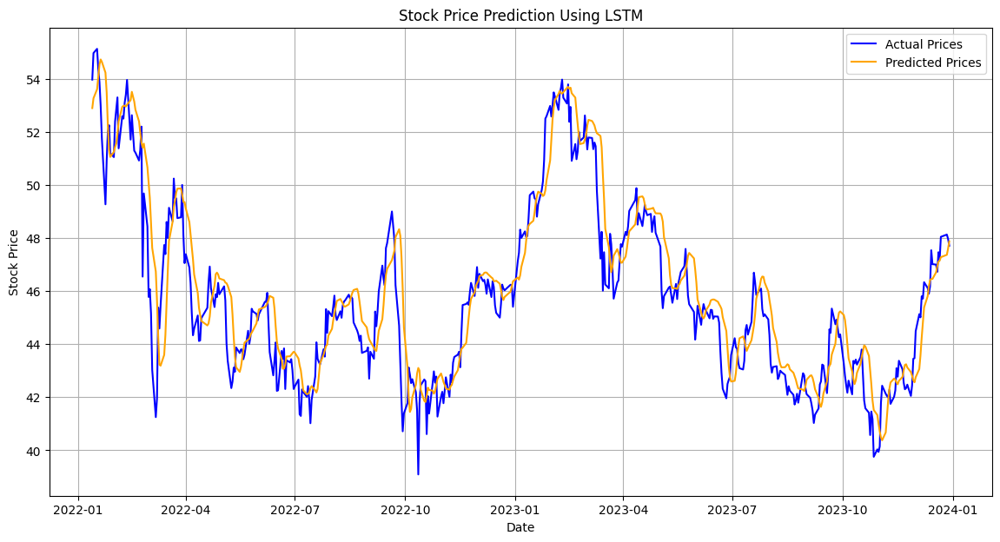

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━

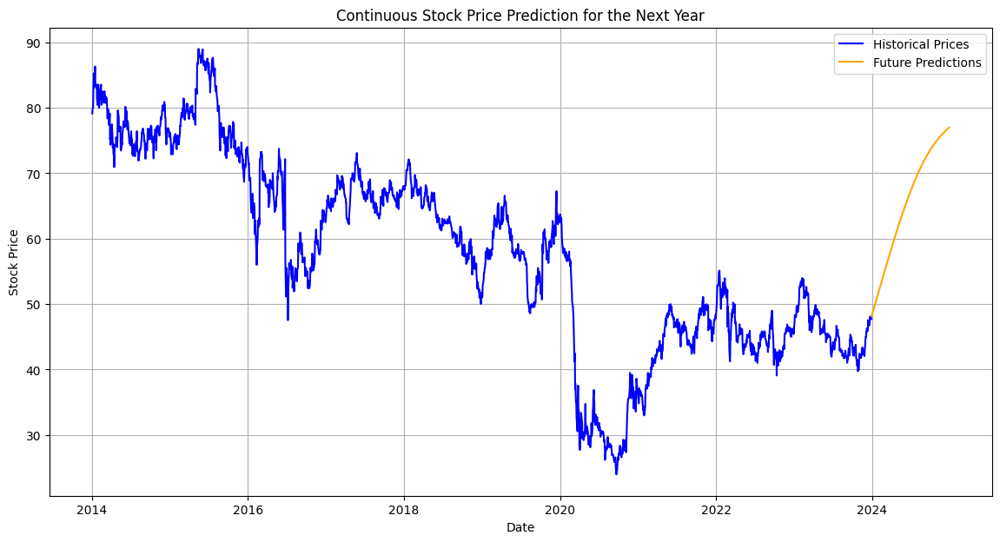

Mean Absolute Error (MAE): 0.8411533672959519
Mean Squared Error (MSE): 1.316324975187922
Root Mean Squared Error (RMSE): 1.1473120653021662
RSE of the base model: 0.8830312154909774





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.1504 
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0074
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0050
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0044
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0041
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0039
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0038
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0034
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0038
Epoch 10/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0032
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0036
Epoch 12/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0034
Epoch 13/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0034
Epoch 14/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0030
Epoch 15/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0035
Epoch 16/100
50

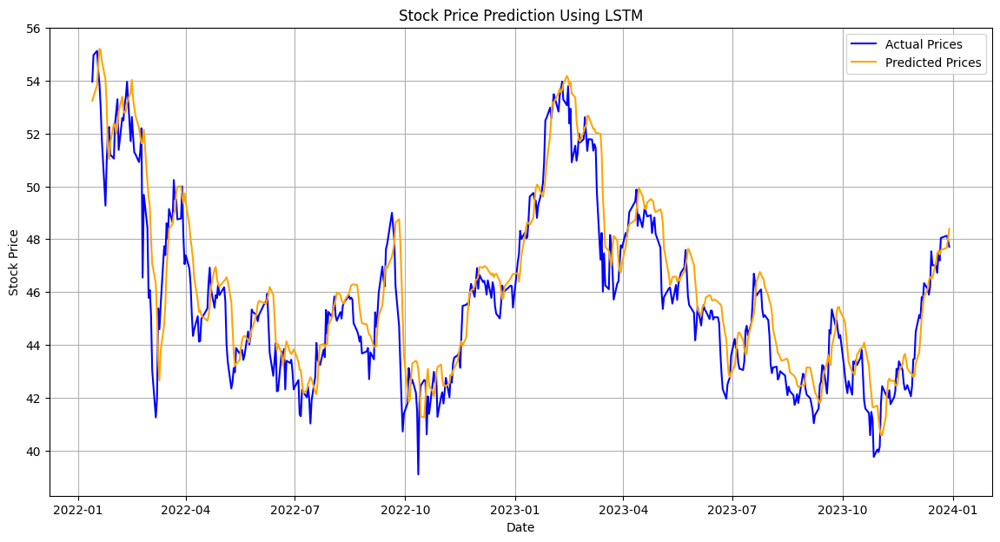

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━

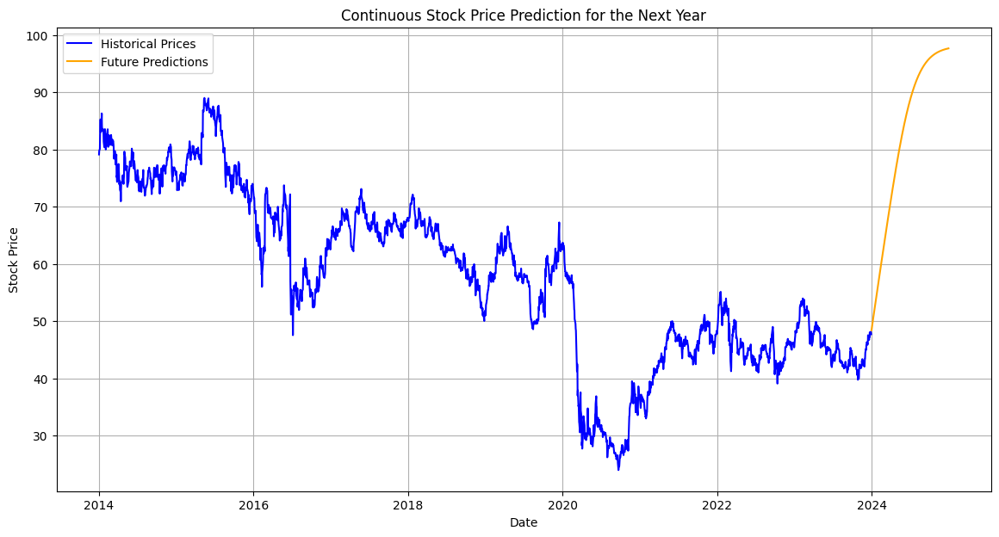

Mean Absolute Error (MAE): 0.8002940288180028
Mean Squared Error (MSE): 1.149722252484123
Root Mean Squared Error (RMSE): 1.0722510212091771
RSE of the base model: 0.8978355520627841





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


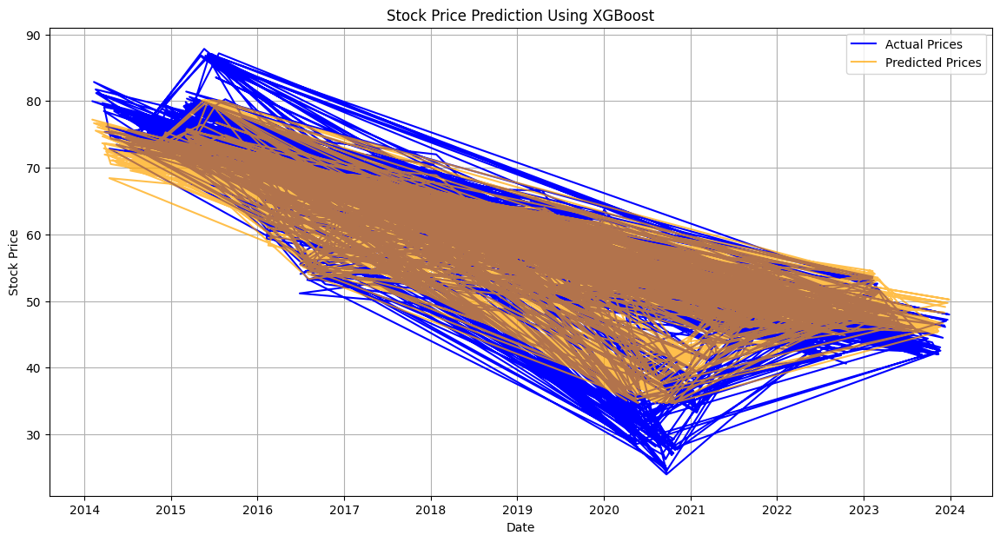

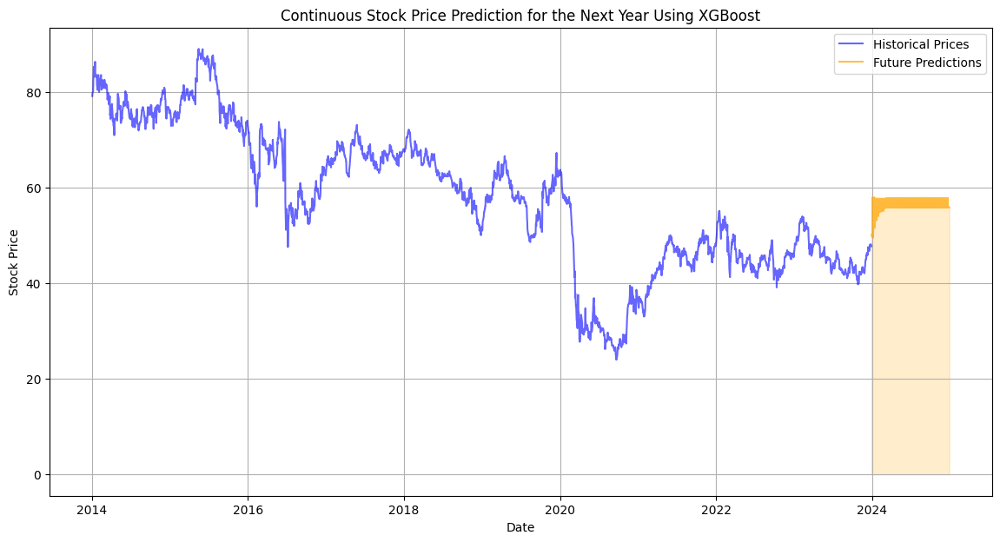




Predicted trend for next year: Down





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


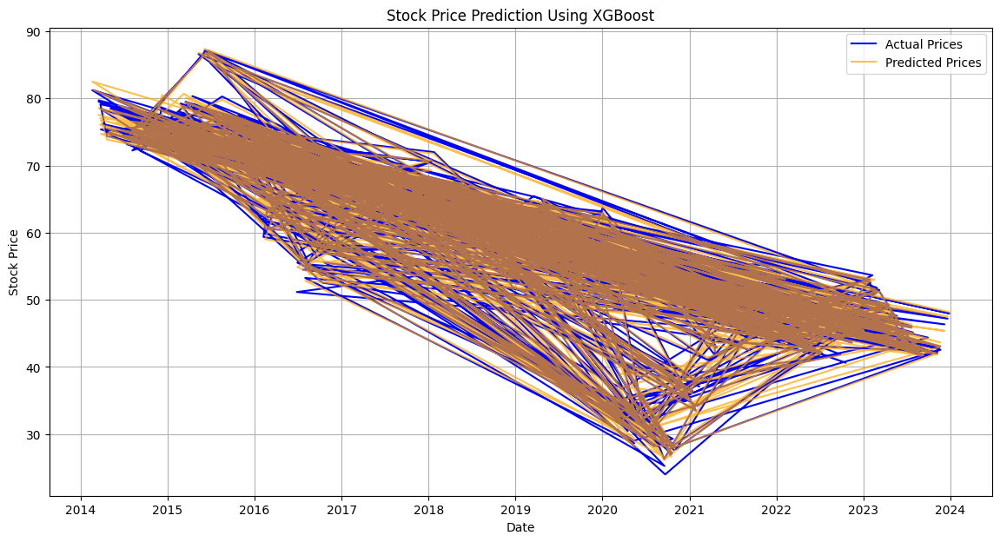

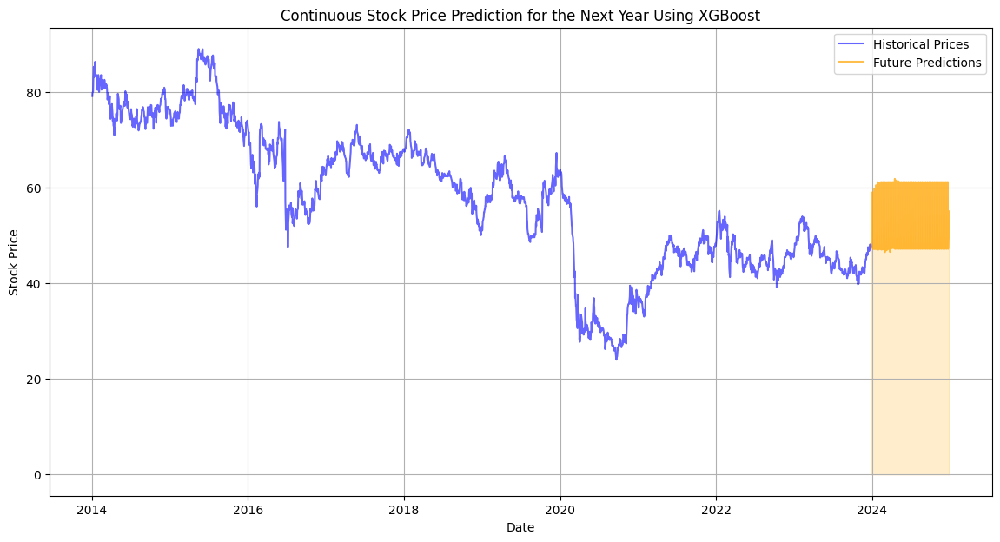




Predicted trend for next year: Up





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 1.30
RMSE: 1.14
MAE: 0.72
R2 Score: 0.99
------------------------------





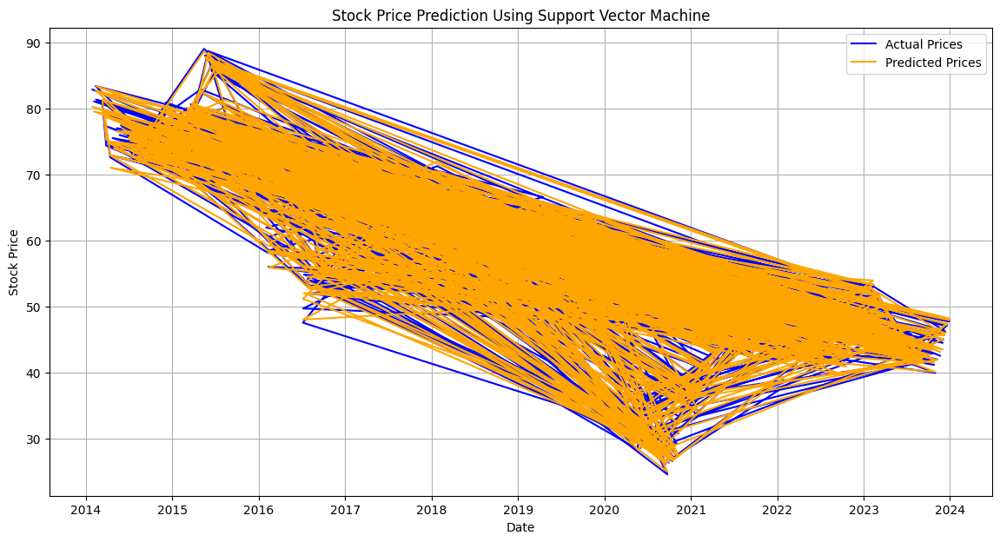

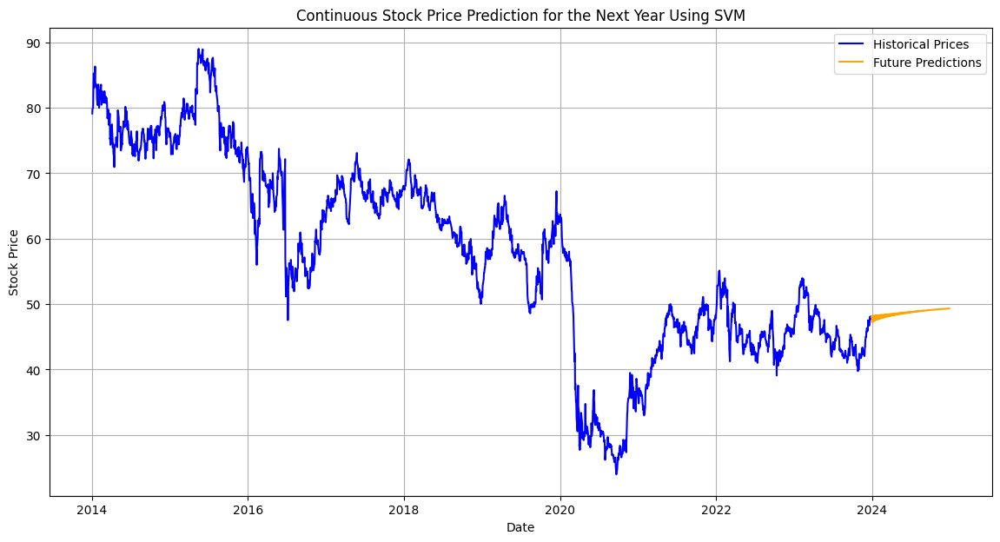

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 1.37
RMSE: 1.17
MAE: 0.72
R2 Score: 0.99
------------------------------





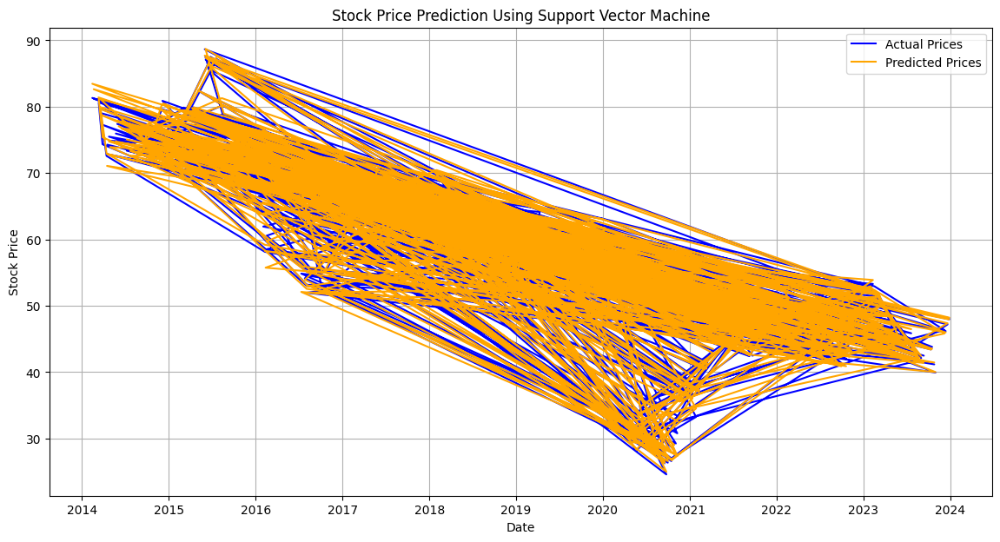

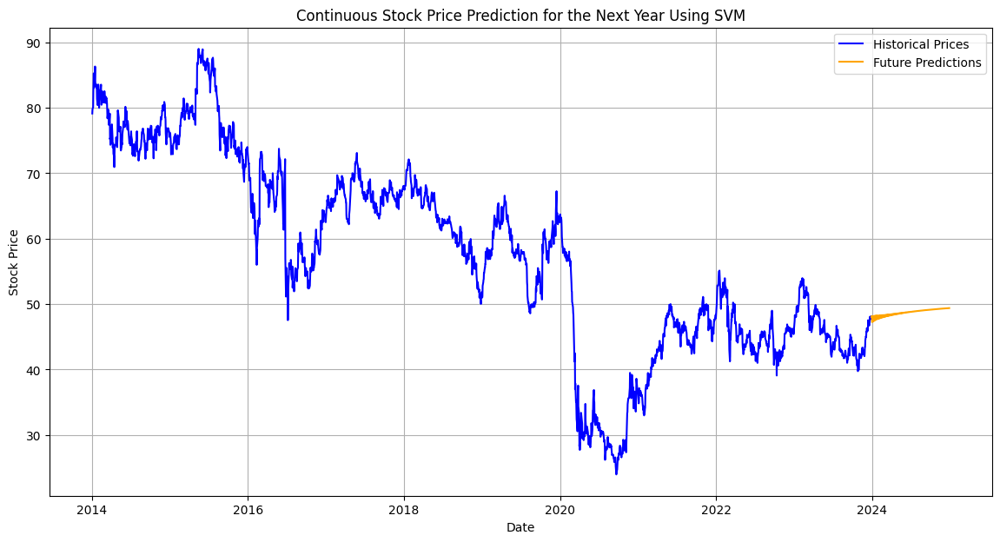

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **HSBC   HSBA.L**

In [ ]:
# Fetching data for Lloyds  (HSBA.L)
ticker = "HSBA.L"
data = yf.download(ticker, start="2014-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,HSBA.L,HSBA.L,HSBA.L,HSBA.L,HSBA.L,HSBA.L
Date,,,,,,
2014-01-02 00:00:00+00:00,356.725311,659.700012,661.200012,654.599976,658.400024,15181957
2014-01-03 00:00:00+00:00,354.940918,656.400024,659.388000,649.796997,653.000000,15846261
2014-01-06 00:00:00+00:00,356.887482,660.000000,664.299988,656.388000,658.099976,26415293
2014-01-07 00:00:00+00:00,365.431183,675.799988,678.400024,659.599976,659.799988,31453649
2014-01-08 00:00:00+00:00,364.728149,674.500000,677.940979,671.911011,673.099976,24154793


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2525 entries, 2014-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (Adj Close, HSBA.L)  2525 non-null   float64
 1   (Close, HSBA.L)      2525 non-null   float64
 2   (High, HSBA.L)       2525 non-null   float64
 3   (Low, HSBA.L)        2525 non-null   float64
 4   (Open, HSBA.L)       2525 non-null   float64
 5   (Volume, HSBA.L)     2525 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 138.1 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker       HSBA.L       HSBA.L       HSBA.L       HSBA

**EDA Analysis**

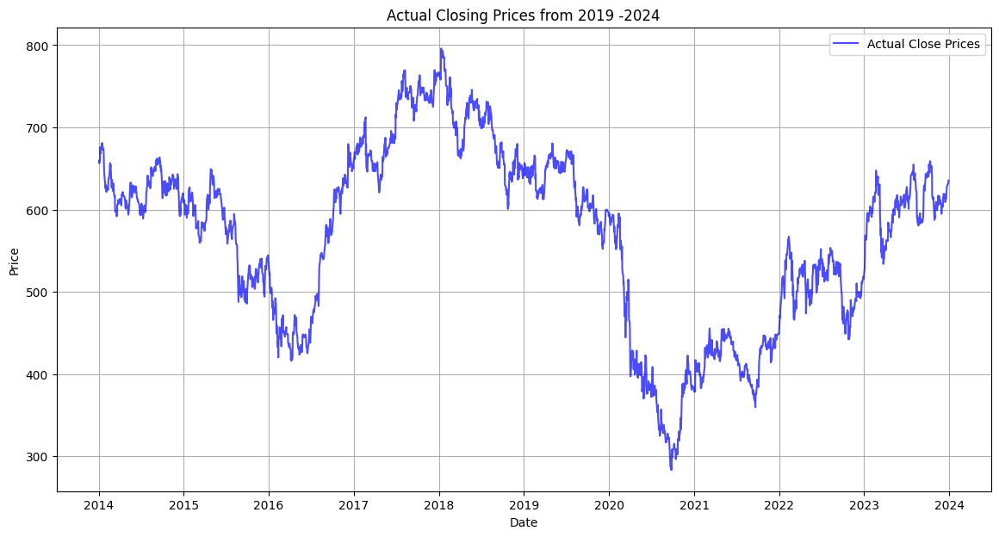

Close column head:
 Date
2014-01-02 00:00:00+00:00    659.700012
2014-01-03 00:00:00+00:00    656.400024
2014-01-06 00:00:00+00:00    660.000000
2014-01-07 00:00:00+00:00    675.799988
2014-01-08 00:00:00+00:00    674.500000
Name: (Close, HSBA.L), dtype: float64
Statistics for Close column:
 count    2525.000000
mean      568.807620
std       109.201702
min       283.350006
25%       486.299988
50%       596.500000
75%       646.500000
max       796.000000
Name: (Close, HSBA.L), dtype: float64


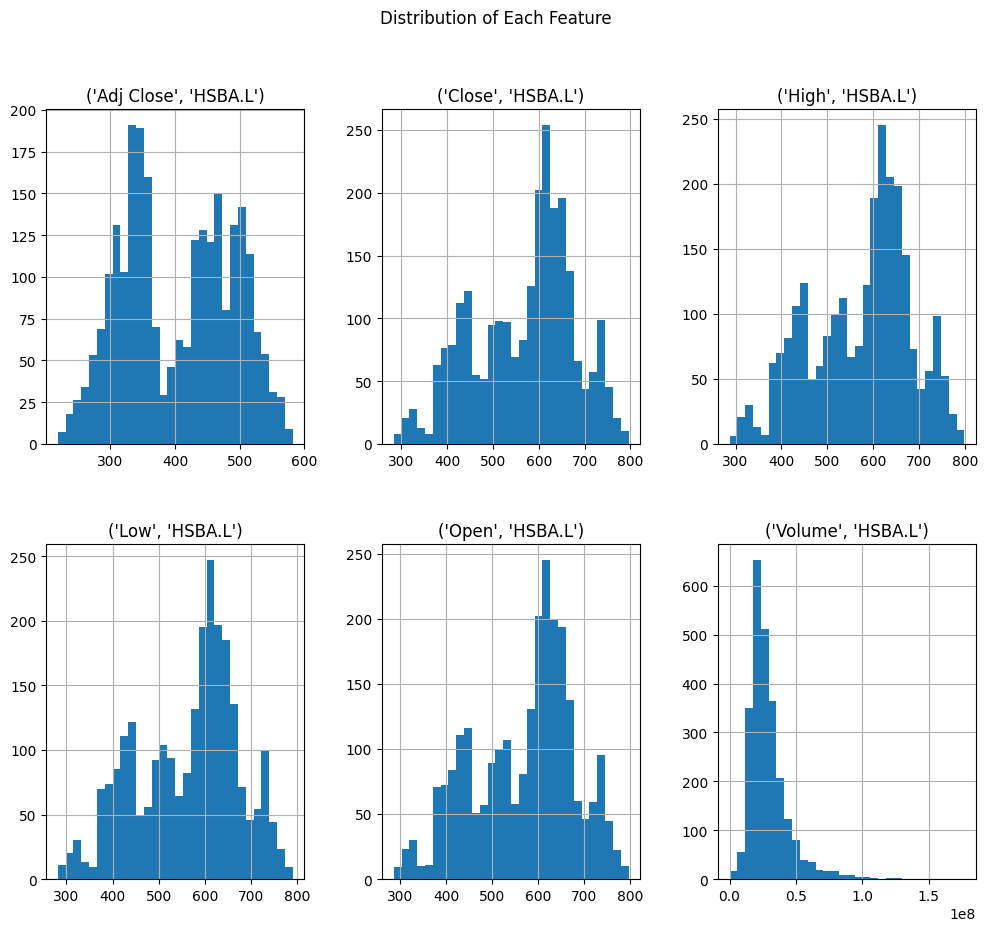

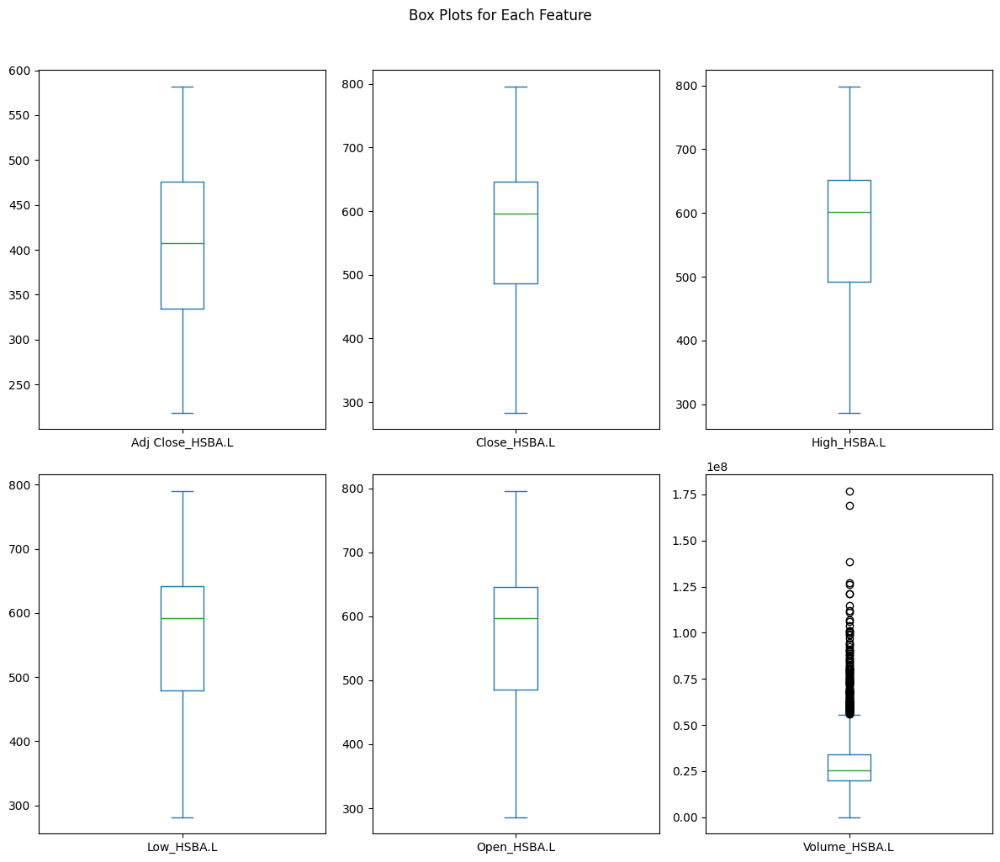

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


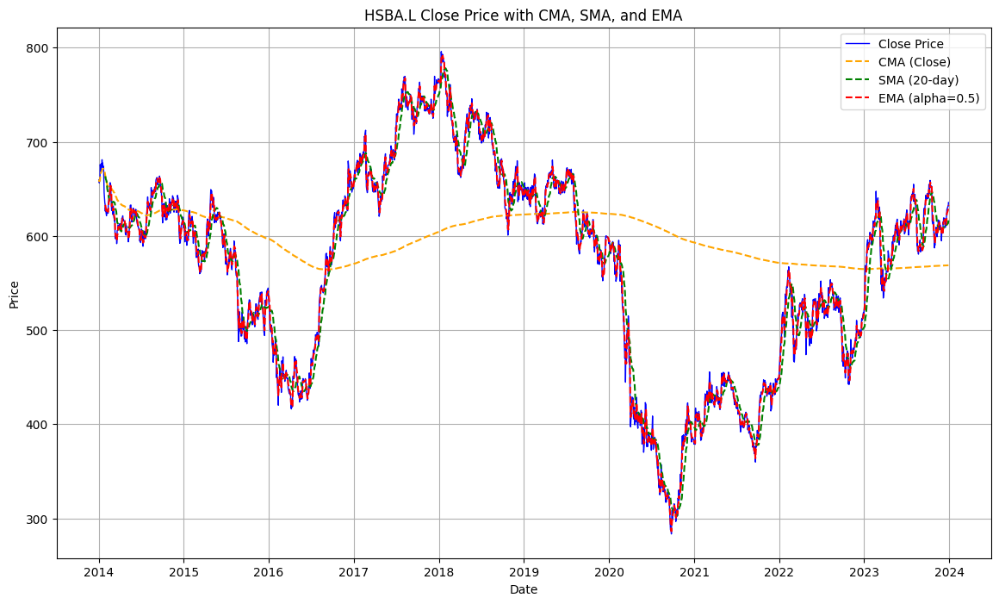

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       24.8004
Mean Absolute Error (MAE):      3.6791
Root Mean Squared Error (RMSE): 4.980003627817169
Root Square Error (RSE):        0.9979
------------------------------


<ipython-input-5-b10075603d89>:43: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


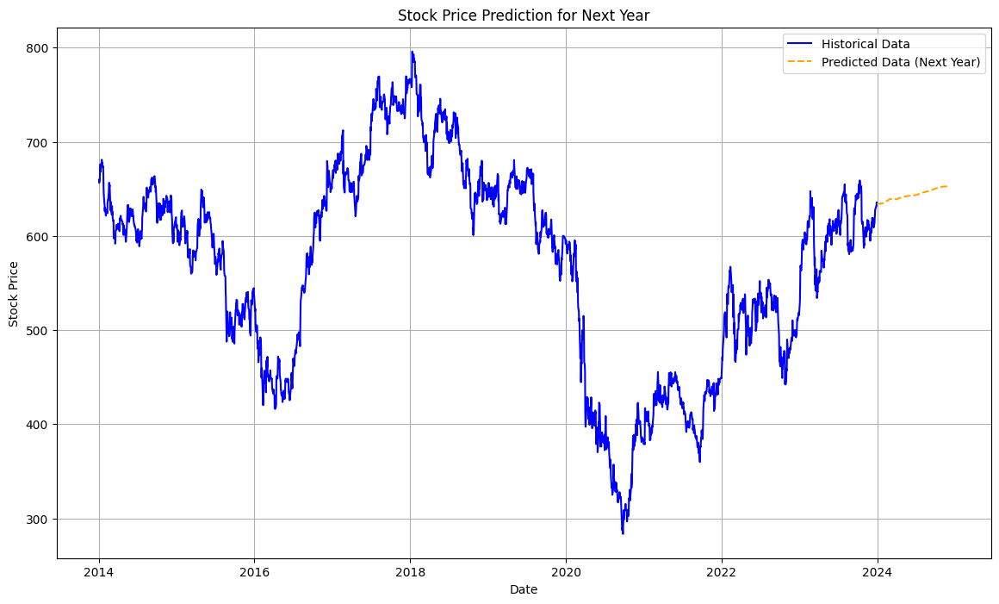

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.53
F1 Score: 0.55
Precision: 0.57
Recall: 0.52
------------------------------------------------------------


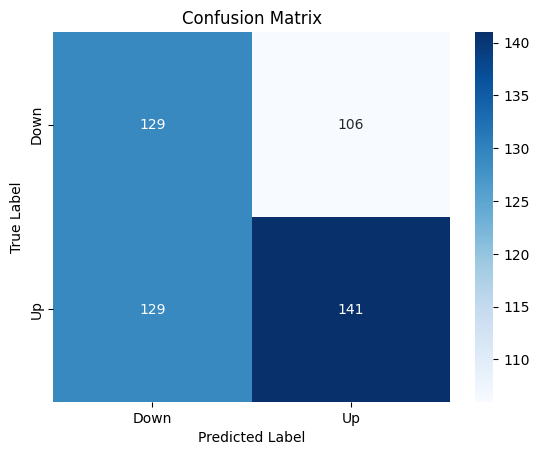

The stock price is predicted to go UP.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


62/62 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.1018
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0051
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0042
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0041
Epoch 5/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0043
Epoch 6/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0037
Epoch 7/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0037
Epoch 8/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0031
Epoch 9/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0036
Epoch 10/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0034
Epoch 11/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0030
Epoch 12/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0031
Epoch 13/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0027
Epoch 14/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0032
Epoch 15/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0029
Epoch 16/50
62/62 ━━━━━━━━━━━

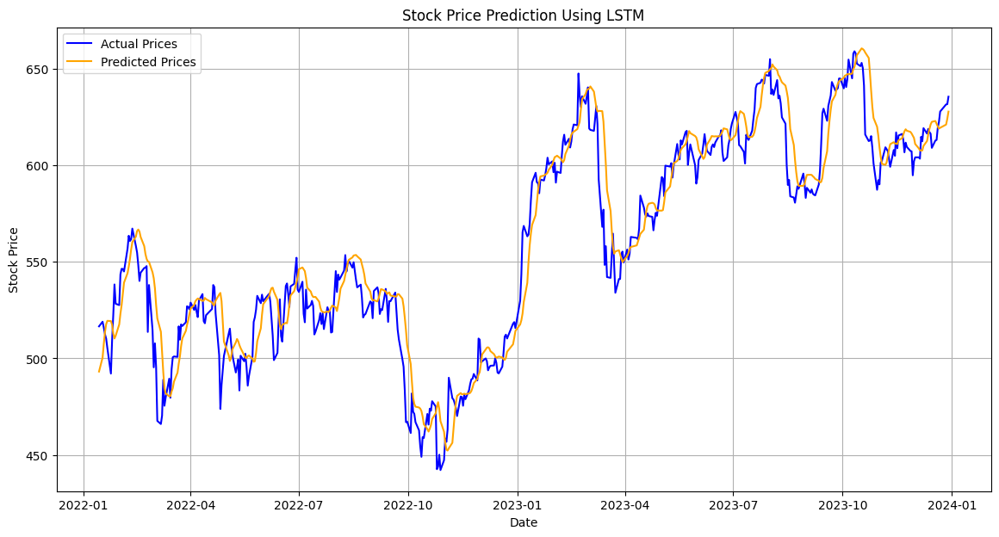

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

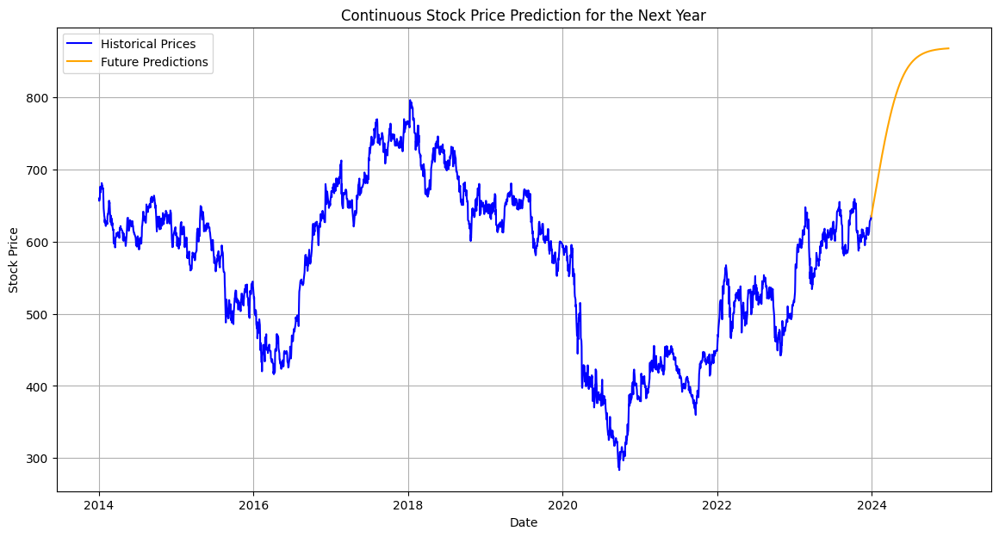

Mean Absolute Error (MAE): 9.645598870020125
Mean Squared Error (MSE): 178.23278273035476
Root Mean Squared Error (RMSE): 13.350385115432243
RSE of the base model: 0.9398148160329332





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0906 
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0053
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0045
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0044
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0038
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0035
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0034
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0034
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0031
Epoch 10/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0032
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0035
Epoch 12/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0035
Epoch 13/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0029
Epoch 14/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0028
Epoch 15/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0031
Epoch 16/10

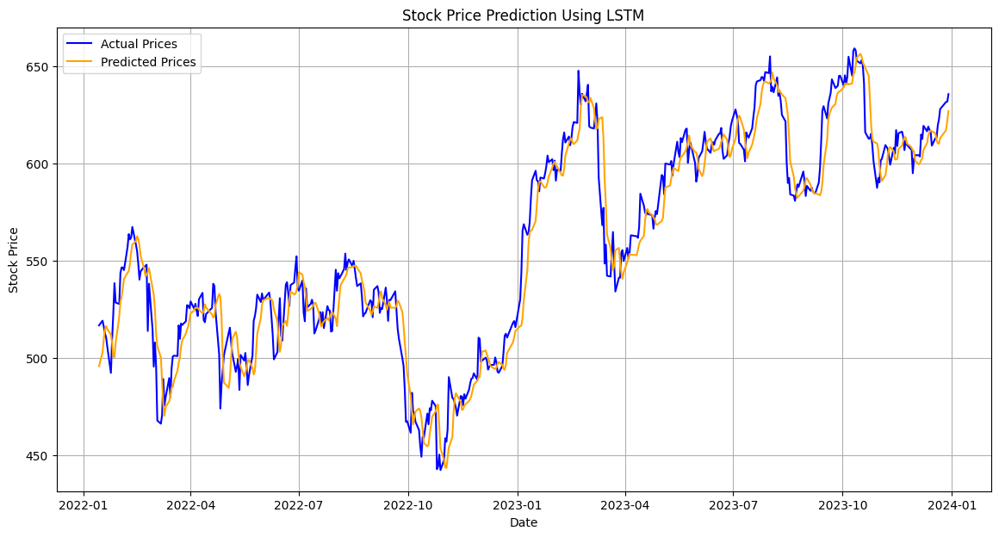

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

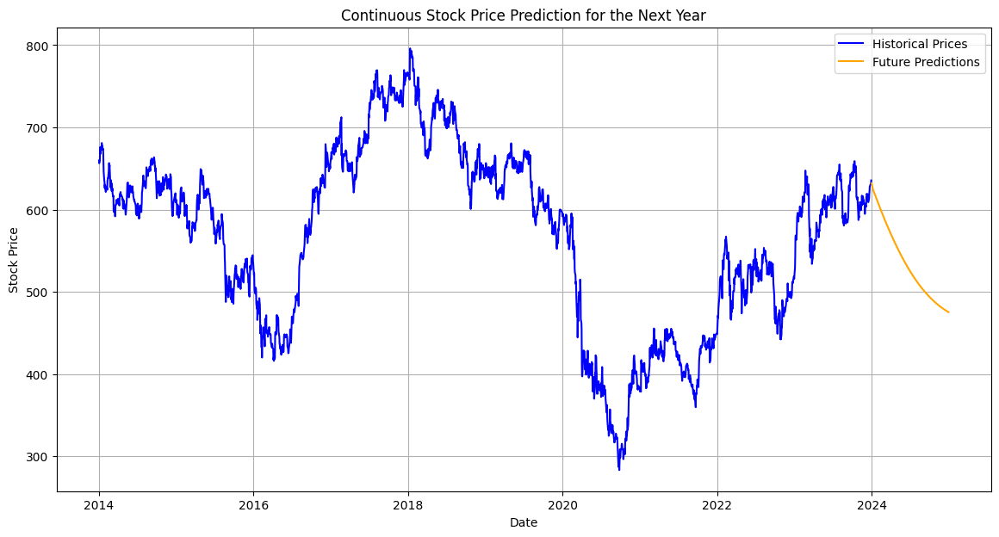

Mean Absolute Error (MAE): 7.997014972307619
Mean Squared Error (MSE): 114.48582314705556
Root Mean Squared Error (RMSE): 10.699804818175682
RSE of the base model: 0.9613407240678562





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


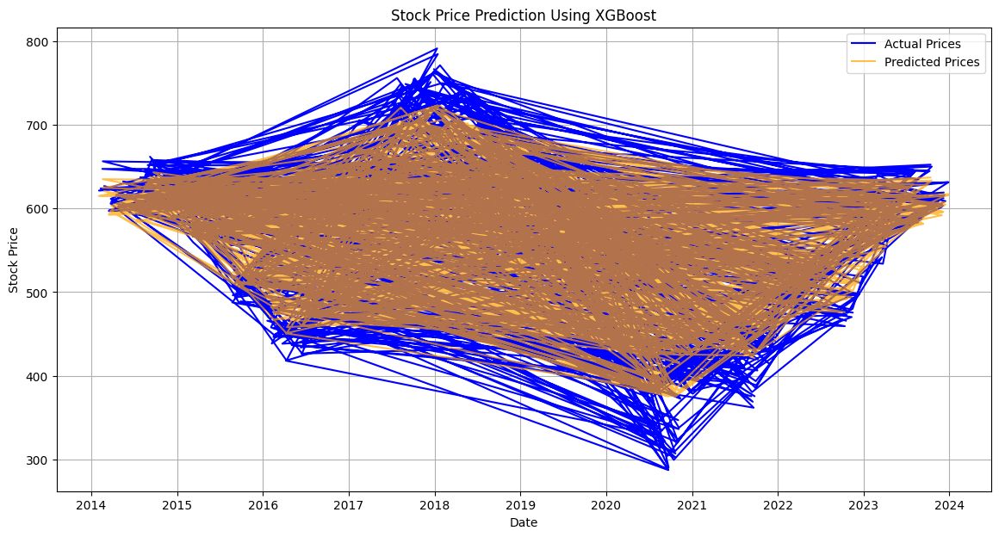

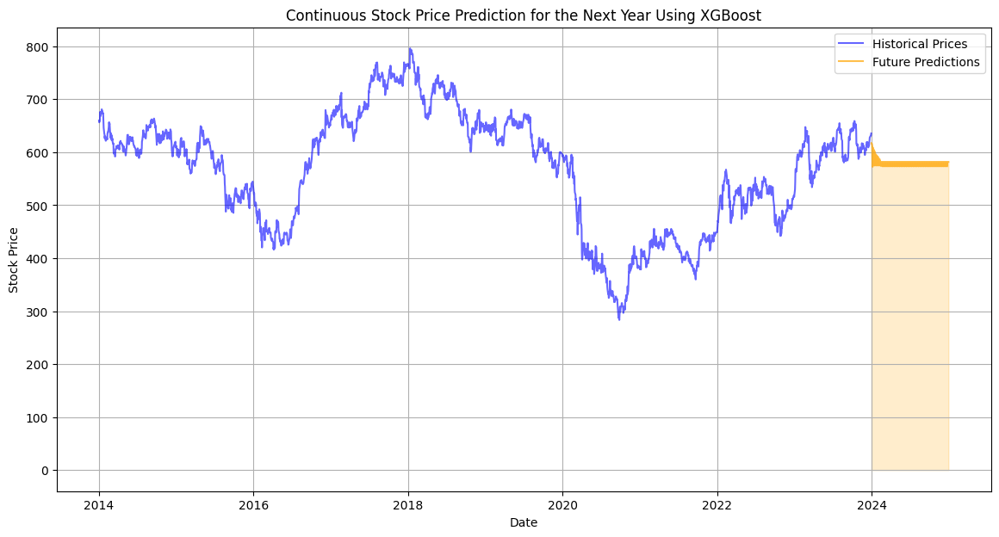




Predicted trend for next year: Down





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


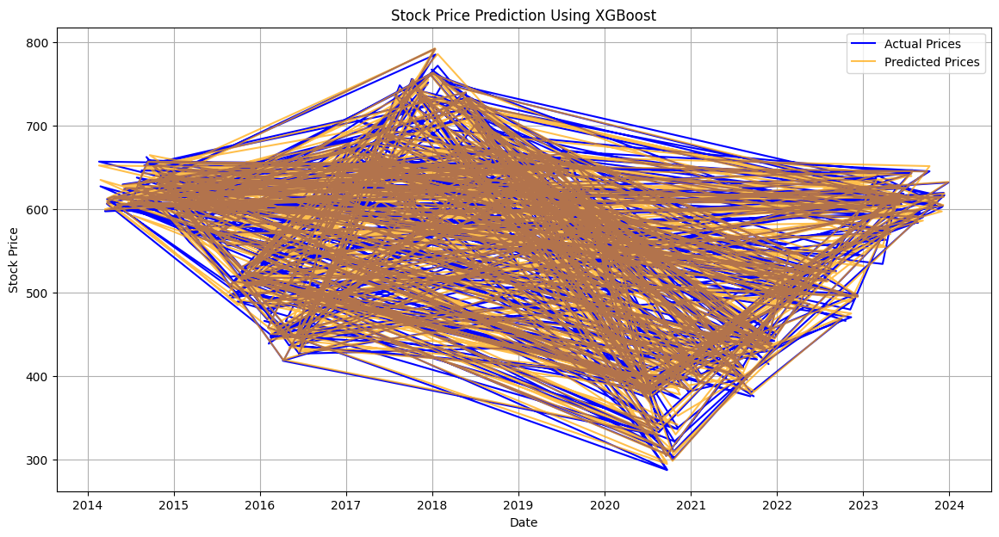

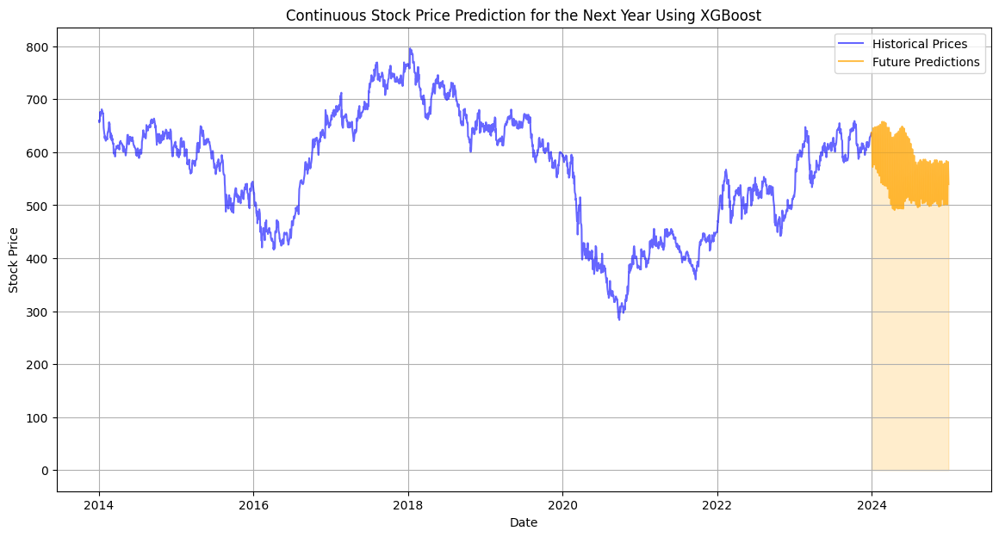




Predicted trend for next year: Down





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 70.14
RMSE: 8.38
MAE: 5.99
R2 Score: 0.99
------------------------------





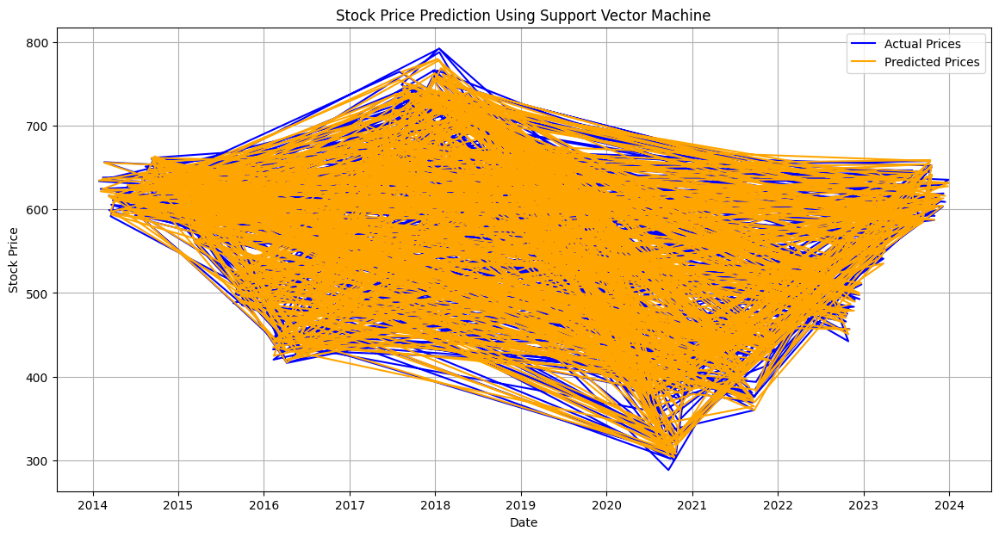

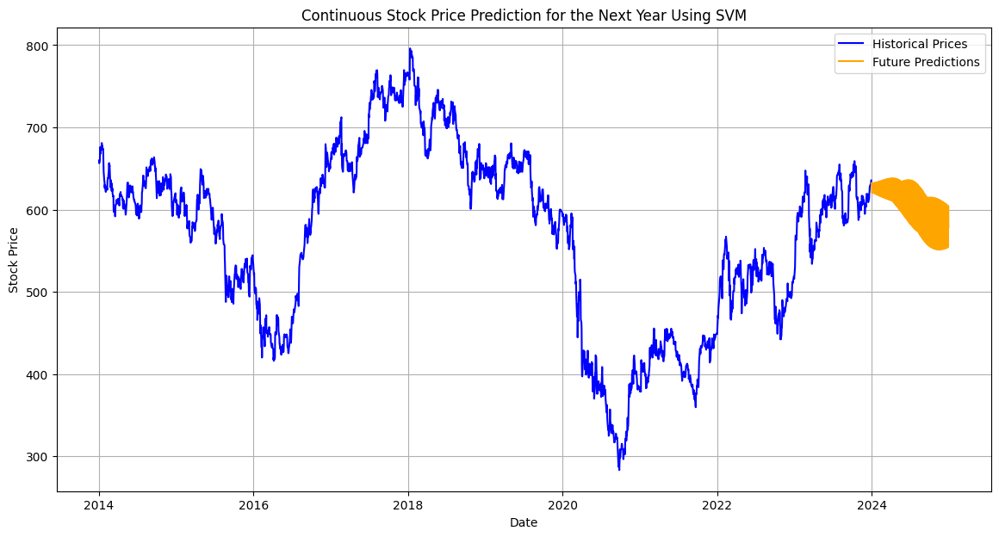

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 69.17
RMSE: 8.32
MAE: 5.92
R2 Score: 0.99
------------------------------





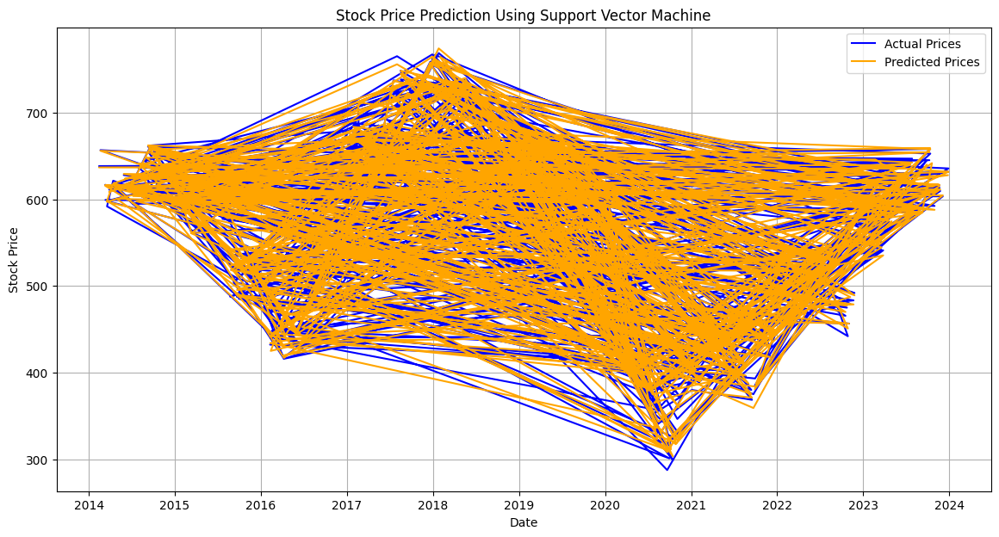

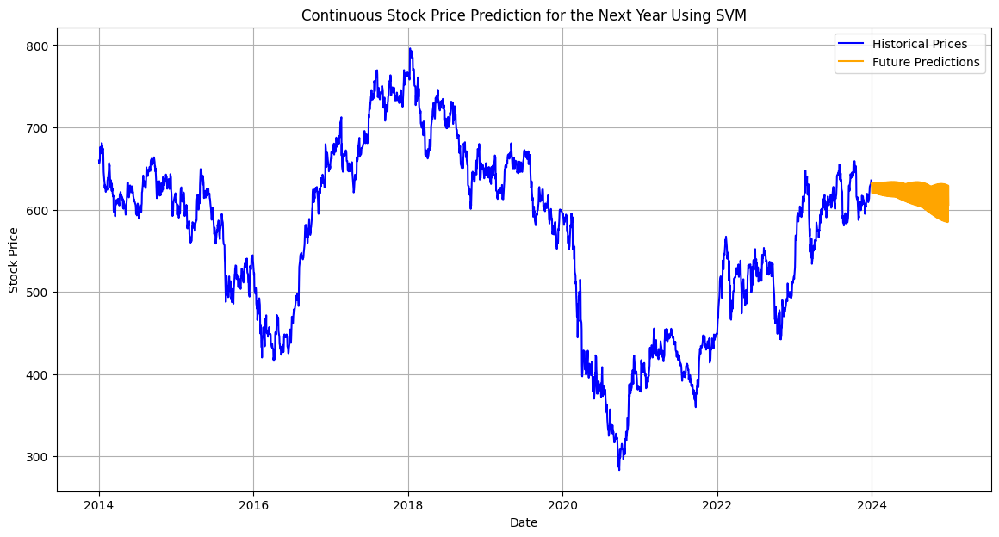

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


# **NatWest  NWG. L**

In [ ]:
# Fetching data for Lloyds  (NWG.L)
ticker = "NWG.L"
data = yf.download(ticker, start="2014-01-01", end="2024-01-01")

# fixing column names by removing the ticker
df=data
# Date index in datetime formatfor graph
df.index = pd.to_datetime(df.index)
df.head()





[*********************100%***********************]  1 of 1 completed


Price,Adj Close,Close,High,Low,Open,Volume
Ticker,NWG.L,NWG.L,NWG.L,NWG.L,NWG.L,NWG.L
Date,,,,,,
2014-01-02 00:00:00+00:00,253.574280,366.261505,368.633911,365.399902,366.476898,5003754
2014-01-03 00:00:00+00:00,255.960129,369.707611,373.261505,365.830688,366.369202,6462638
2014-01-06 00:00:00+00:00,256.705811,370.784607,373.369202,366.153809,369.492310,5933733
2014-01-07 00:00:00+00:00,261.253815,377.353790,380.378906,368.280701,368.846100,7823083
2014-01-08 00:00:00+00:00,266.845734,385.430695,389.859009,375.630707,377.676910,12687862


In [ ]:
print("-" * 60)
print("info")
print("-" * 60)
print(df.info())
print("-" * 60)
print("Describe")
print("-" * 60)
print(df.describe())
print("-" * 60)
print("isnull")
print("-" * 60)
print(df.isnull().sum())



------------------------------------------------------------
info
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2525 entries, 2014-01-02 00:00:00+00:00 to 2023-12-29 00:00:00+00:00
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   (Adj Close, NWG.L)  2525 non-null   float64
 1   (Close, NWG.L)      2525 non-null   float64
 2   (High, NWG.L)       2525 non-null   float64
 3   (Low, NWG.L)        2525 non-null   float64
 4   (Open, NWG.L)       2525 non-null   float64
 5   (Volume, NWG.L)     2525 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 138.1 KB
None
------------------------------------------------------------
Describe
------------------------------------------------------------
Price     Adj Close        Close         High          Low         Open  \
Ticker        NWG.L        NWG.L        NWG.L        NWG.L      

**EDA Analysis**

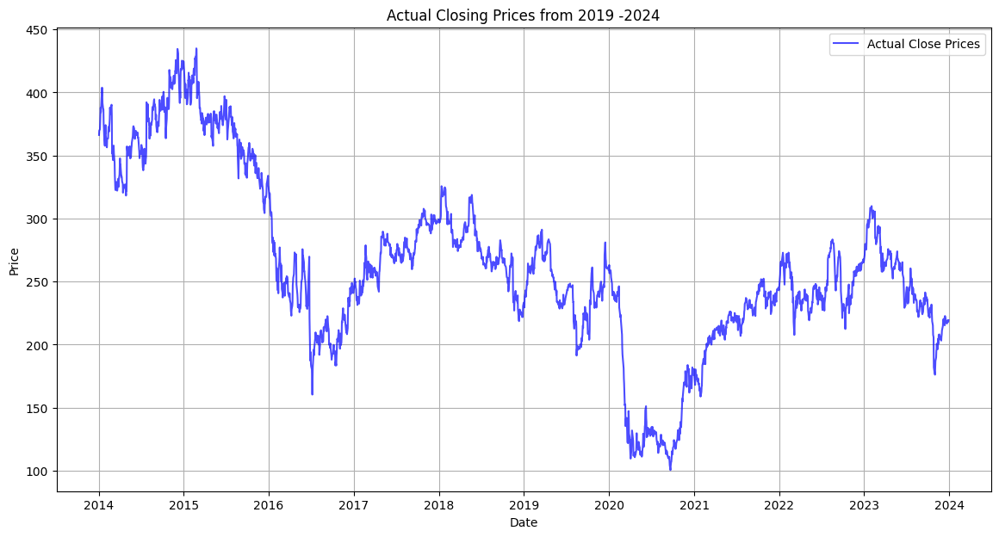

Close column head:
 Date
2014-01-02 00:00:00+00:00    366.261505
2014-01-03 00:00:00+00:00    369.707611
2014-01-06 00:00:00+00:00    370.784607
2014-01-07 00:00:00+00:00    377.353790
2014-01-08 00:00:00+00:00    385.430695
Name: (Close, NWG.L), dtype: float64
Statistics for Close column:
 count    2525.000000
mean      263.113300
std        69.101249
min       100.498398
25%       226.046097
50%       256.630707
75%       295.830688
max       434.969208
Name: (Close, NWG.L), dtype: float64


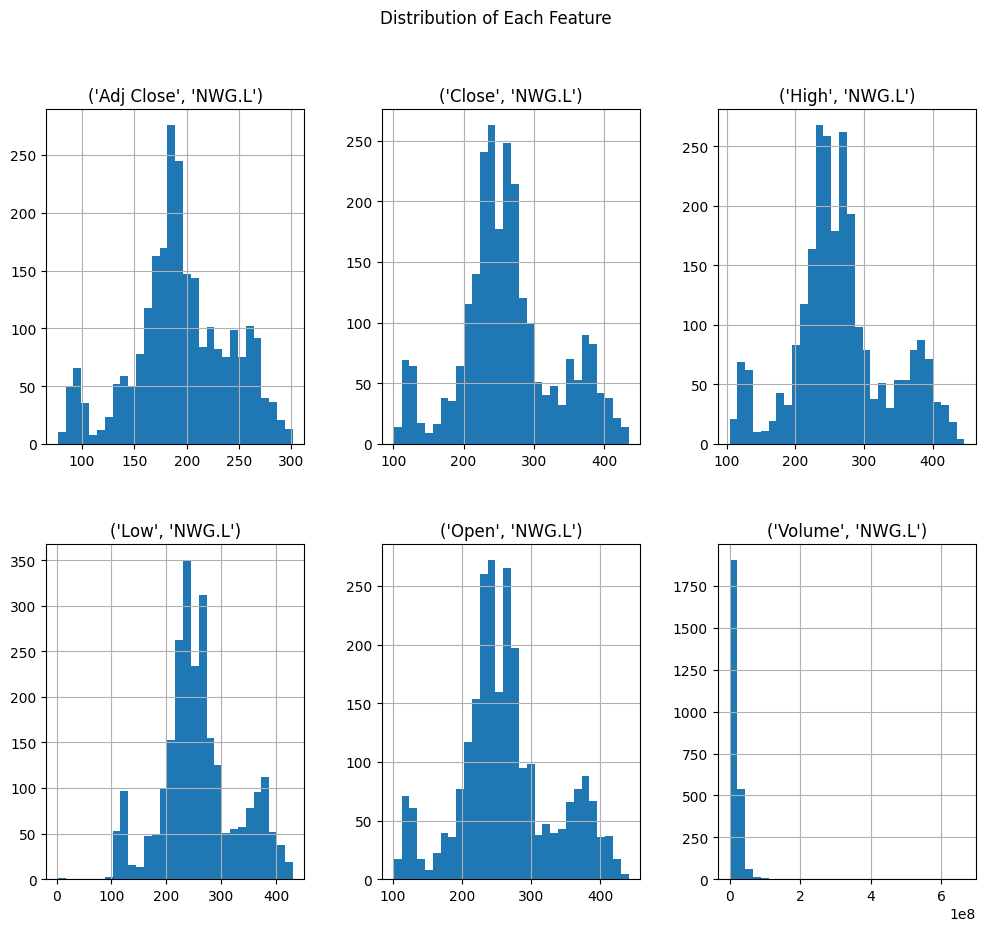

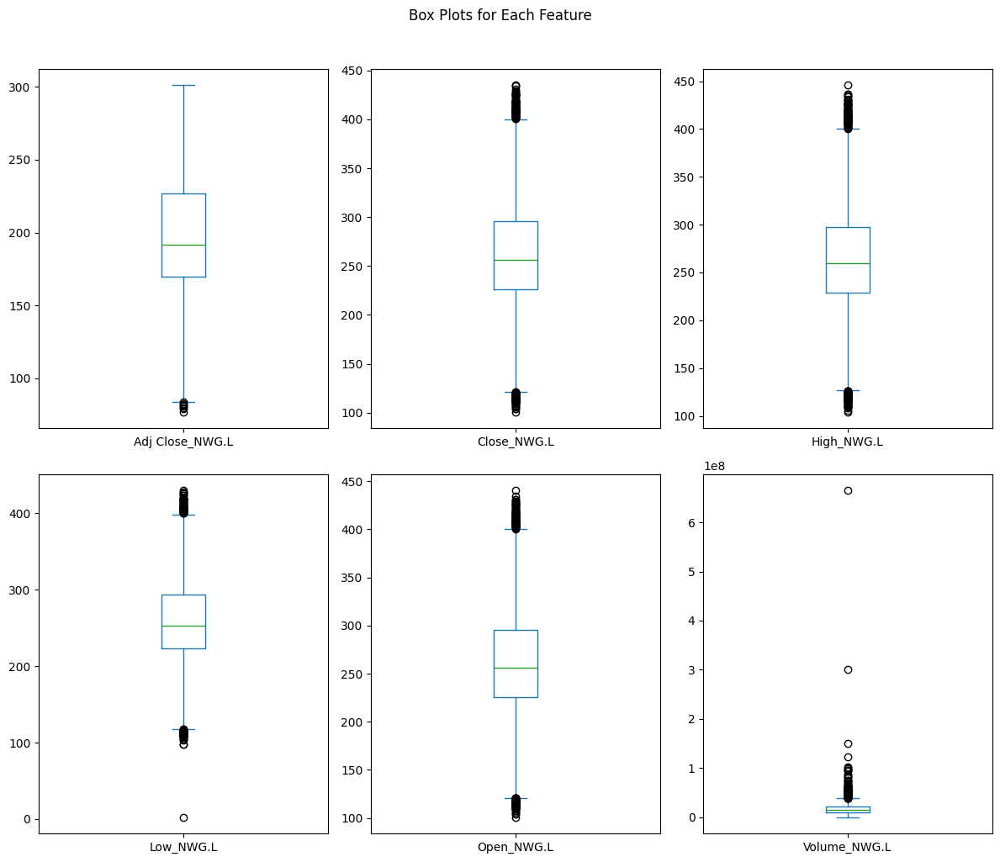

In [ ]:
eda_analysis(df,ticker)

**Feature Engineering**

Feature engineering completed.


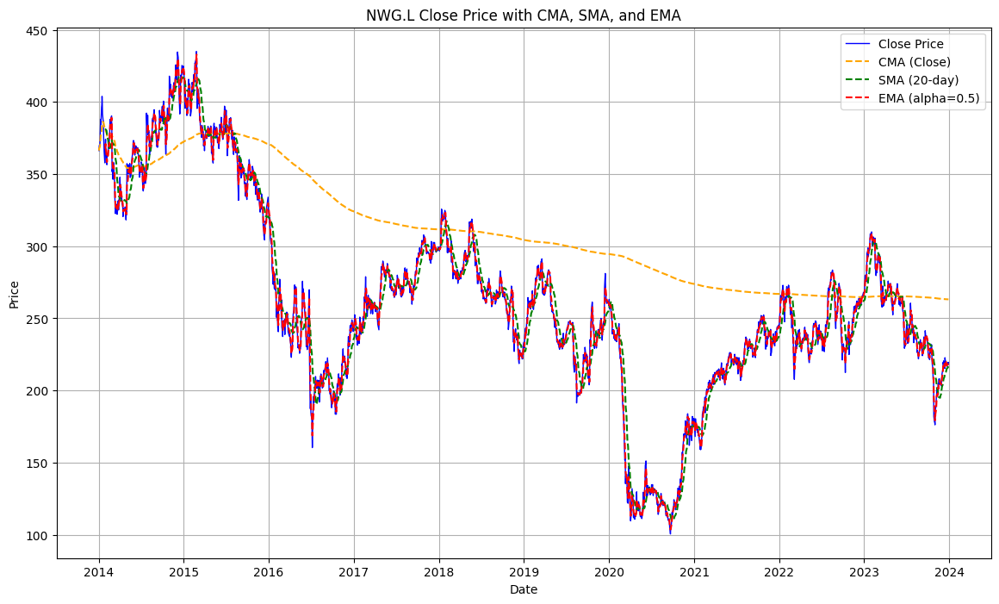

In [ ]:
#data = yf.download(ticker, start="2019-01-01", end="2024-01-01", auto_adjust=True)
feature_engineering(data,ticker)

**Random forest**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model Performance Metrics
------------------------------
Mean Squared Error (MSE):       8.0669
Mean Absolute Error (MAE):      2.1244
Root Mean Squared Error (RMSE): 2.840229253893698
Root Square Error (RSE):        0.9983
------------------------------


<ipython-input-5-b10075603d89>:43: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_dates = pd.date_range(start=df.index[-1] + pd.DateOffset(days=1), periods=12, freq='M')


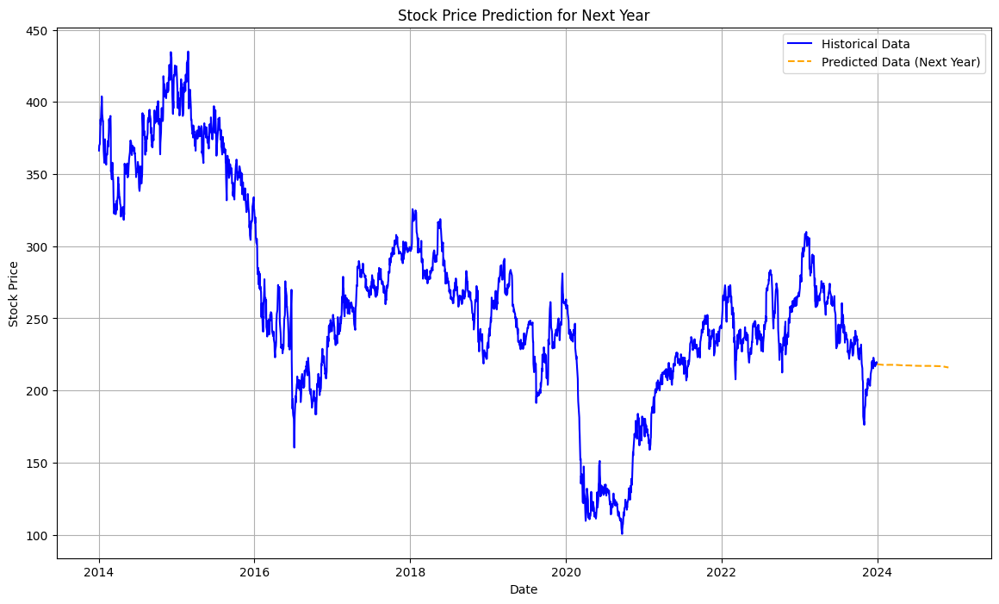

In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y_column = 'Close'
random_forest_regressor(df, X_columns, y_column, estim=100, test_size=0.2)

**Using random forest classifier to just predict weather it goes up ir down**

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


------------------------------------------------------------
Model Evaluation Metrics:
Accuracy: 0.57
F1 Score: 0.57
Precision: 0.62
Recall: 0.52
------------------------------------------------------------


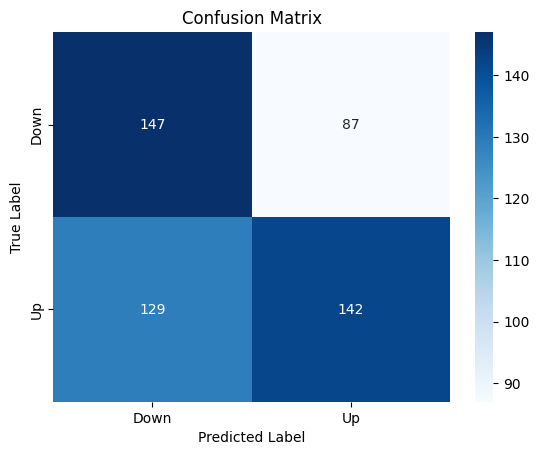

The stock price is predicted to go DOWN.


In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']
y = (df['Close'].shift(-1) > df['Close']).astype(int)
random_forest_classifier(df, X_columns, y, ticker)

## LSTM

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


62/62 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0467
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0045
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0037
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0036
Epoch 5/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0036
Epoch 6/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0032
Epoch 7/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0035
Epoch 8/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0031
Epoch 9/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0026
Epoch 10/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0025
Epoch 11/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0027
Epoch 12/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0027
Epoch 13/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0026
Epoch 14/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0023
Epoch 15/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0022
Epoch 16/50
62/62 ━━━━━━━━━━━━

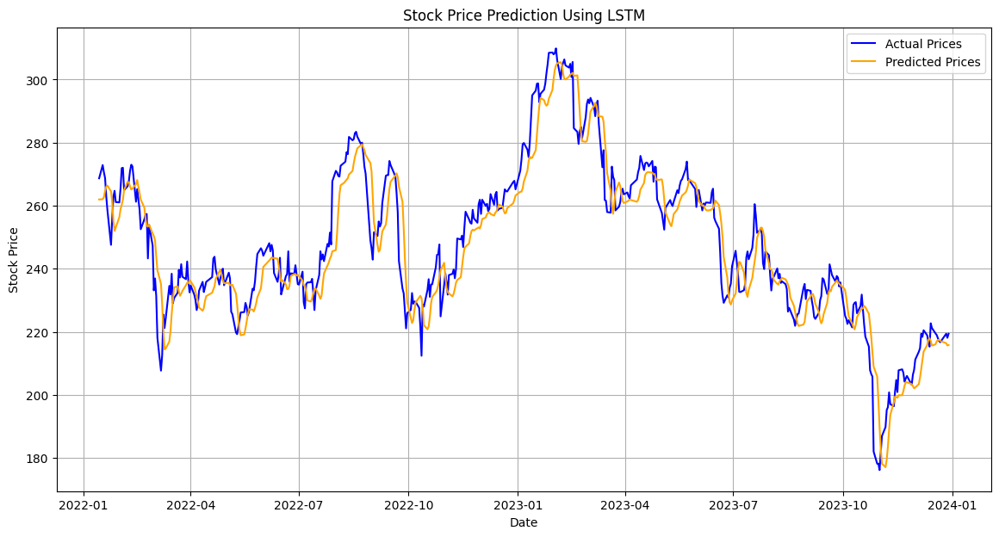

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━

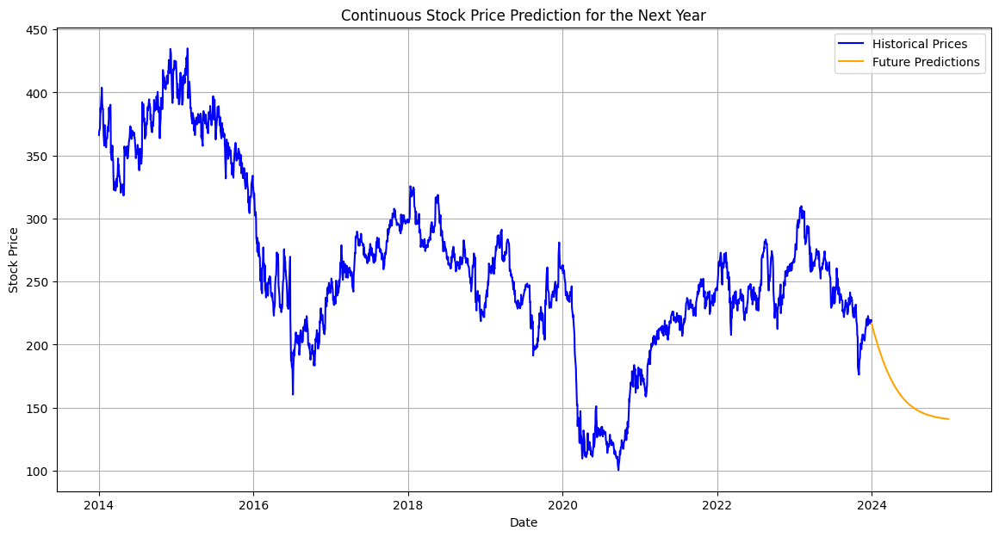

Mean Absolute Error (MAE): 5.3300745037458
Mean Squared Error (MSE): 45.3831462529266
Root Mean Squared Error (RMSE): 6.7367014371223695
RSE of the base model: 0.9279653321356365





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=50, batch_size=32, optim='adam', los='mean_squared_error')


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0409
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0041
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0040
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0035
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0035
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0034
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0031
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0030
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0029
Epoch 10/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0031
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0035
Epoch 12/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0028
Epoch 13/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0026
Epoch 14/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0025
Epoch 15/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0025
Epoch 16/100


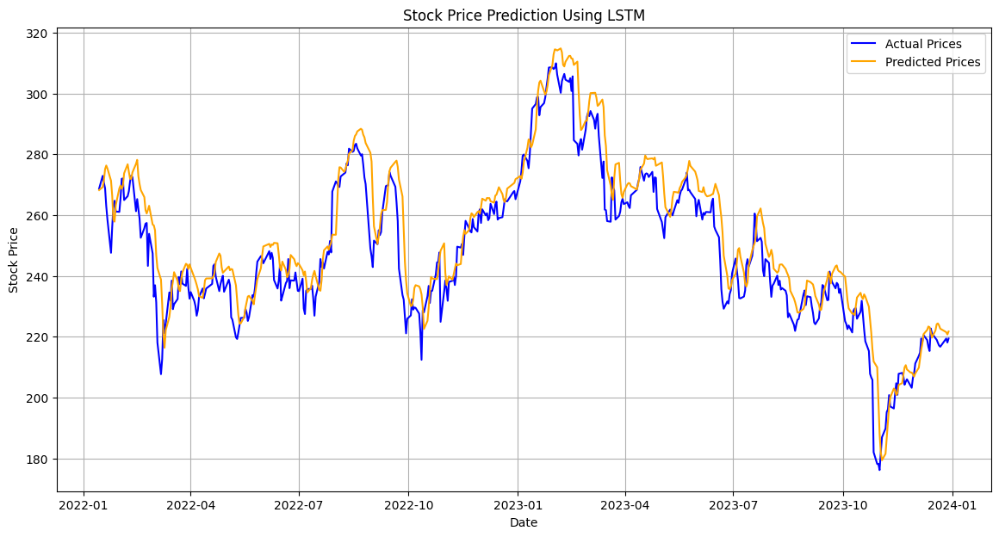

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━

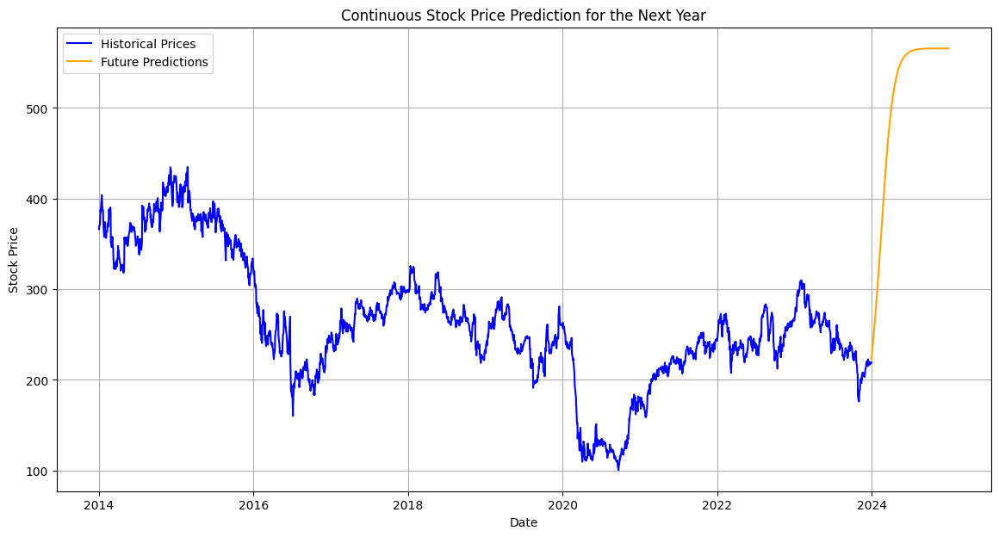

Mean Absolute Error (MAE): 5.994964011542454
Mean Squared Error (MSE): 59.621661168980765
Root Mean Squared Error (RMSE): 7.721506405422504
RSE of the base model: 0.9053651649470603





In [ ]:
X_columns = ['CMA_Close', 'SMA_Close', 'EMA_Close']  # put actual  column names of teh dataset
y_column = 'Close'
lstm(df, X_columns, y_column, epochs=100, batch_size=40, optim='adam', los='mean_squared_error')


## XGBoost

In [ ]:
df['Close'] = df['Close'].astype(float)
X = df.drop('Close', axis=1)
y = df['Close']





<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


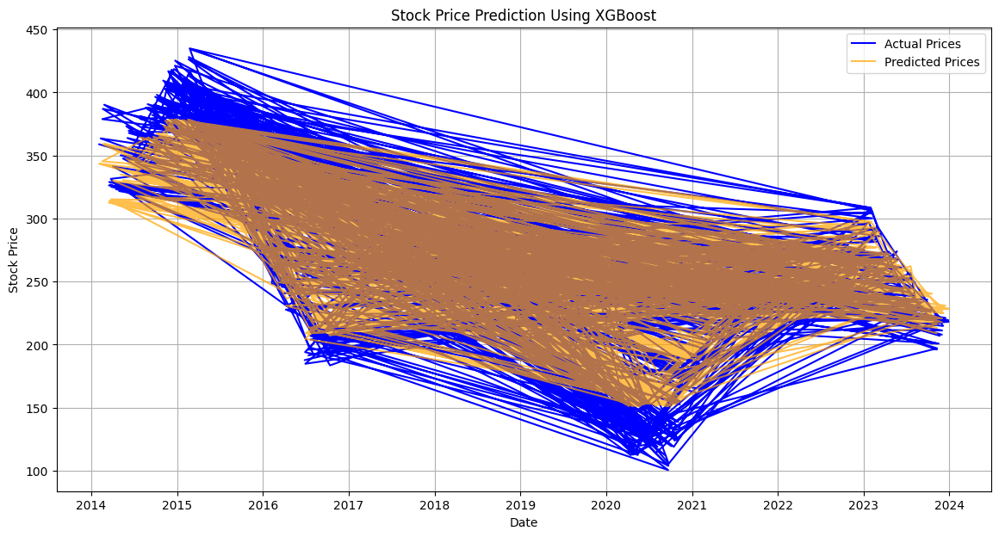

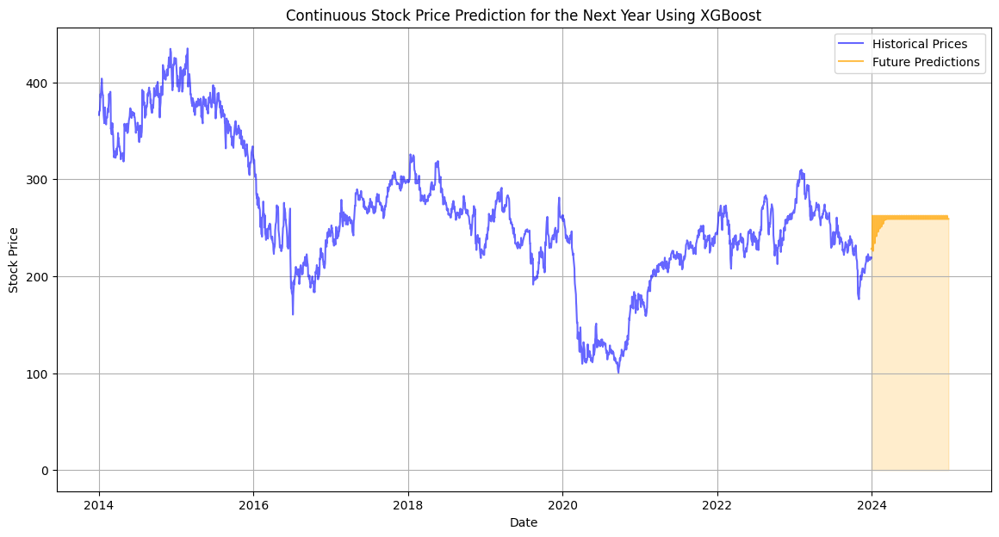




Predicted trend for next year: Down





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.3, n_esti=150, learn_rate=0.01, max_dep=5)


**Experiment with hyperparameters**

<ipython-input-8-bc94e97c68d7>:17: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X = data.drop('Close', axis=1)


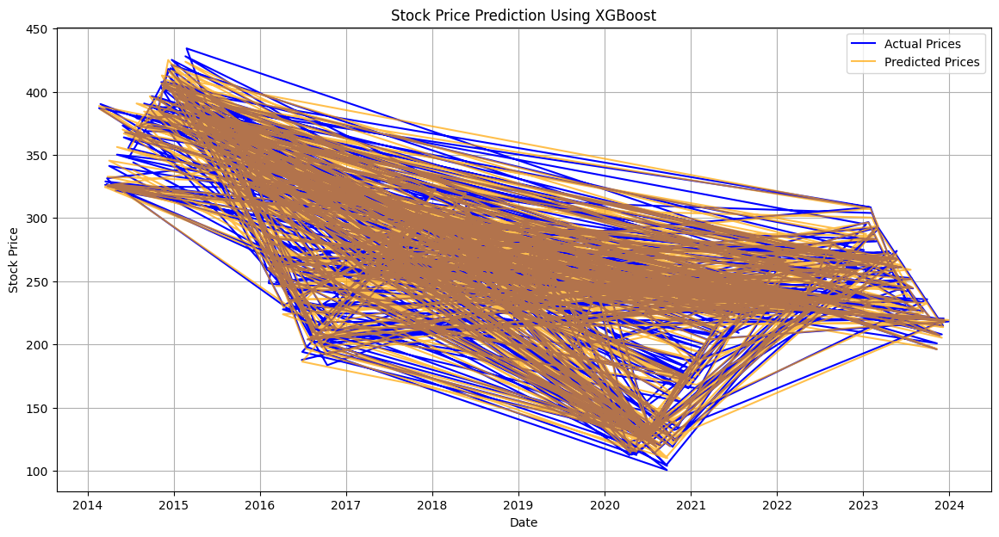

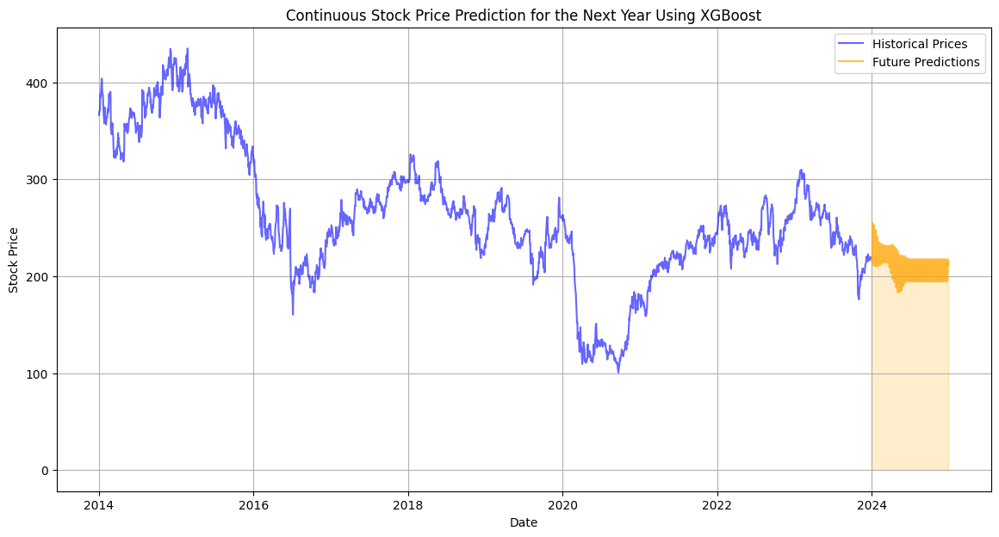




Predicted trend for next year: Down





<ipython-input-8-bc94e97c68d7>:85: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if trend[-1] > 0:


In [ ]:
xgboost(df, X, y, testsiz=0.2, n_esti=100, learn_rate=0.1, max_dep=5)

## SVM

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 26.98
RMSE: 5.19
MAE: 3.67
R2 Score: 0.99
------------------------------





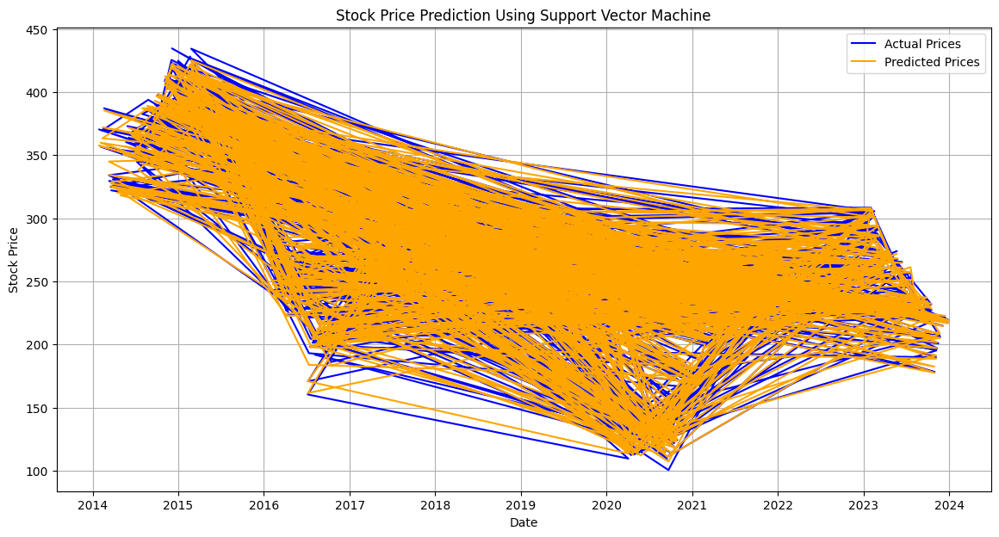

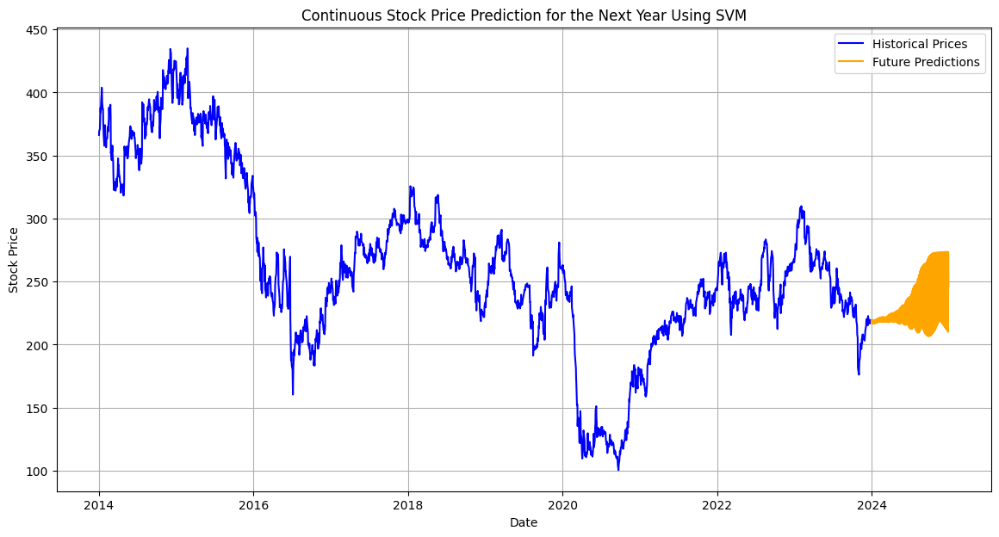

In [ ]:

# Preparing X and y
X = df.drop('Close', axis=1)
y = df['Close'].astype(float)


svm(df, X, y, testsiz=0.3, c=100, epi=0.1)


**Experiment with hyperparameters**

<ipython-input-9-9d72cb295baf>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(





------------------------------
MSE: 26.40
RMSE: 5.14
MAE: 3.53
R2 Score: 0.99
------------------------------





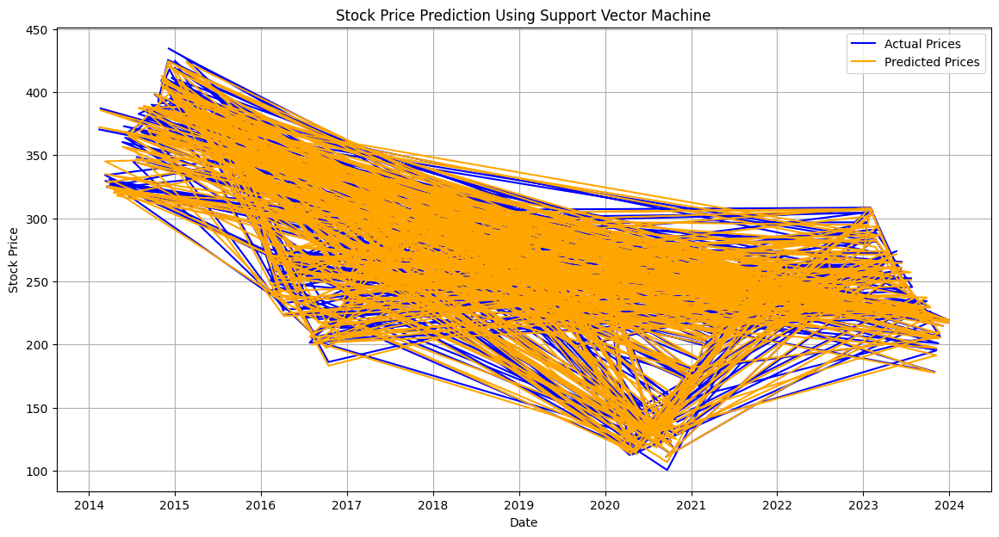

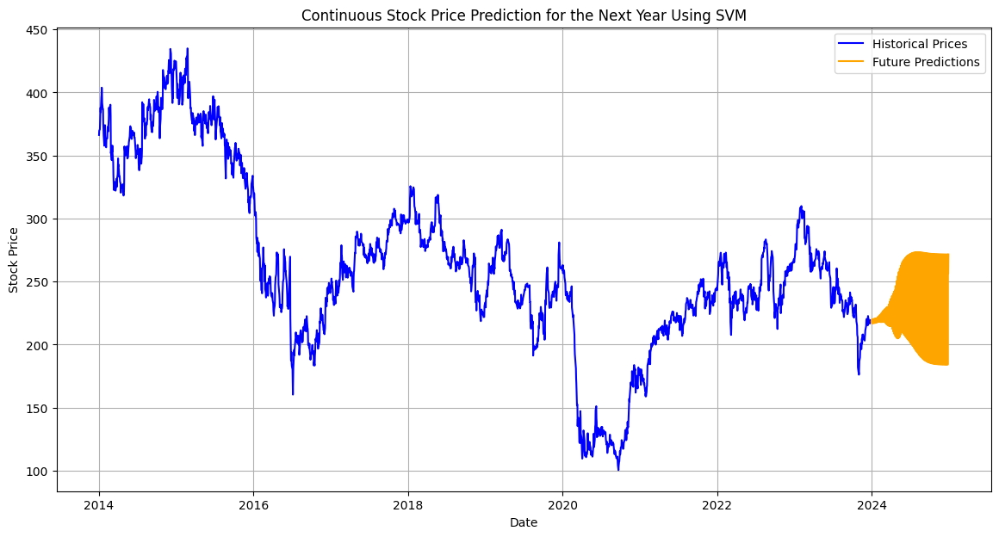

In [ ]:

svm(df, X, y, testsiz=0.2, c=150, epi=0.01)


**Extra code for better isight for data or preprocessing or model**

In [ ]:
# Calculating the number of years
start_year = df.index[0].year
end_year = df.index[-1].year
years_of_data = end_year - start_year + 1

print(f"Years of data: {years_of_data}")


In [ ]:
# Fetching data for Standard Chartered (STAN.L)
ticker = "STAN.L"
stock = yf.Ticker(ticker)

#Stock metadata
metadata = stock.info
metadata


{'address1': '1 Basinghall Avenue',
 'city': 'London',
 'zip': 'EC2V 5DD',
 'country': 'United Kingdom',
 'phone': '44 20 7885 8888',
 'fax': '44 20 7885 9999',
 'website': 'https://www.sc.com',
 'industry': 'Banks - Diversified',
 'industryKey': 'banks-diversified',
 'industryDisp': 'Banks - Diversified',
 'sector': 'Financial Services',
 'sectorKey': 'financial-services',
 'sectorDisp': 'Financial Services',
 'longBusinessSummary': 'Standard Chartered PLC, together with its subsidiaries, provides various banking products and services in Asia, Africa, the Middle East, Europe, and the Americas. The company operates in three segments: Corporate, Commercial & Institutional Banking; Consumer, Private & Business Banking; and Ventures. It offers retail products, such as deposits, mortgages, credit cards, and personal loans; wealth management products and services that include investments, portfolio management, insurance, and wealth advice; and transaction banking services, such as cash mana

In [ ]:
# Fetching data for Standard Chartered (STAN.L)
ticker = "STAN.L"
df = yf.download(ticker, start="2019-01-01", end="2024-01-01")

# Ensure 'Date' is set as index in datetime format
df.index = pd.to_datetime(df.index)


[*********************100%***********************]  1 of 1 completed


In [ ]:
from datasets import load_dataset

dataset = load_dataset("tanzuhuggingface/creditcardfraudtraining", split="train")
df = dataset.to_pandas()
print(df.head())

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/182 [00:00<?, ?B/s]

credit_card_resampled.csv:   0%|          | 0.00/163M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/2085138 [00:00<?, ? examples/s]

   id   index  time_elapsed        cc_num     amt      lat      long  is_fraud
0   0  347210             1  4.158950e+15    3.34  40.4308  -79.9205         0
1   1  347244             1  4.797300e+18   16.54  38.8938  -86.5246         0
2   2  347249             1  4.586810e+15   29.84  32.5486  -80.3070         0
3   3  347278             1  4.956830e+18  101.56  40.6747  -74.2239         0
4   4  347293             2  4.561550e+12    3.59  34.9889 -106.0610         0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2085138 entries, 0 to 2085137
Data columns (total 8 columns):
 #   Column        Dtype  
---  ------        -----  
 0   id            int64  
 1   index         int64  
 2   time_elapsed  int64  
 3   cc_num        float64
 4   amt           float64
 5   lat           float64
 6   long          float64
 7   is_fraud      int64  
dtypes: float64(4), int64(4)
memory usage: 127.3 MB


In [ ]:
df

,id,index,time_elapsed,cc_num,amt,lat,long,is_fraud
0,0,347210,1,4.158950e+15,3.340000,40.430800,-79.920500,0
1,1,347244,1,4.797300e+18,16.540000,38.893800,-86.524600,0
2,2,347249,1,4.586810e+15,29.840000,32.548600,-80.307000,0
3,3,347278,1,4.956830e+18,101.560000,40.674700,-74.223900,0
4,4,347293,2,4.561550e+12,3.590000,34.988900,-106.061000,0
...,...,...,...,...,...,...,...,...
2085133,2085133,621655,4,-2.124232e+18,153.984941,38.734121,-105.612185,1
2085134,2085134,198665,13,1.623557e+18,897.472037,31.135096,-76.789361,1
2085135,2085135,-115788,11,-8.426380e+17,1301.453019,47.524165,-31.288224,1
2085136,2085136,1191690,9,2.692801e+18,311.180351,47.411219,-50.518979,1


In [ ]:
df.describe()

,id,index,time_elapsed,cc_num,amt,lat,long,is_fraud
count,2.085138e+06,2.085138e+06,2.085138e+06,2.085138e+06,2.085138e+06,2.085138e+06,2.085138e+06,2085138.0
mean,1.042568e+06,5.049692e+05,1.169697e+00,3.965088e+17,2.992306e+02,3.858014e+01,-9.004107e+01,0.5
std,6.019276e+05,4.089742e+05,7.291183e+00,1.637756e+18,4.955343e+02,6.704931e+00,1.827680e+01,0.5
min,0.000000e+00,-1.612912e+06,-3.000000e+01,-6.986079e+18,-2.159578e+03,1.511058e+00,-2.269371e+02,0.0
25%,5.212842e+05,2.117852e+05,0.000000e+00,6.304420e+11,1.501000e+01,3.408775e+01,-9.925484e+01,0.0
50%,1.042568e+06,5.054810e+05,0.000000e+00,3.543300e+15,8.474000e+01,3.911268e+01,-8.799734e+01,0.5
75%,1.563853e+06,8.031388e+05,2.000000e+00,5.330299e+17,5.406551e+02,4.272800e+01,-7.844002e+01,1.0
max,2.085137e+06,2.794497e+06,8.300000e+01,1.122925e+19,2.894890e+04,9.152811e+01,1.470988e-01,1.0


In [ ]:
pip install pandas requests datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 472.7/472.7 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 13.0 MB/s eta 0:00:00


In [ ]:
# Display all column names to check the exact label for the target column
print("Column names:", df.columns)

# If the target column is different, update the code to print it accordingly
# Example if the target column is labeled differently, like 'is_fraud'
# print(df['is_fraud'].value_counts())


Column names: Index(['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount'],
      dtype='object')
